# Frameworks that we will use

In this workshop you will learn how to build advanced image segmentation model using PyTorch. To reduce the amount of boilerplate code, we will use [Catalyst](https://github.com/catalyst-team/catalyst) framework for quick & easy training of our models. Often, model architecture search is necessary to find the optimal model architecture, depth & width configuration of the network. To enable us to quicky change the encoder and decoder parameters of our model, we will use [pytorch-toolbelt](https://github.com/BloodAxe/pytorch-toolbelt) library which offers very flexible way to create building blocks of our model. And lastly, to ensure our model will not overfit, we will use [Albumentations](https://github.com/albumentations-team/albumentations) library to help us with image augmentations during the training.



In [ ]:
!pip uninstall keras -y
!pip uninstall efficientnet -y
!pip install efficientnet git+https://github.com/qubvel/segmentation_models keras==2.10.0

Found existing installation: keras 2.12.0
Uninstalling keras-2.12.0:
  Successfully uninstalled keras-2.12.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/qubvel/segmentation_models to /tmp/pip-req-build-ufojaxox
  Running command git clone --filter=blob:none --quiet https://github.com/qubvel/segmentation_models /tmp/pip-req-build-ufojaxox
  Resolved https://github.com/qubvel/segmentation_models to commit e951c6747f75fa9e7240816d1c79dd2e66813123
  Running command git submodule update --init --recursive -q
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 73.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 6.8 MB/s eta 0:00:00
  Created wheel for segmentation-models: filename=segmentation_models-1.0.1-py3-none-any.whl size=33791 sha256=f34753cb0c342eaeab7b0634a491ec989b2e75fcb538b3cea95909ab8947d7d7
  Stored in directory: /tmp/pip

In [ ]:
!python --version
!pip uninstall -y typing
!pip install torch torchvision git+https://github.com/BloodAxe/catalyst git+https://github.com/BloodAxe/pytorch-toolbelt albumentations timm==0.2.1 iterative-stratification

Python 3.10.12
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/BloodAxe/catalyst to /tmp/pip-req-build-0177tsr6
  Running command git clone --filter=blob:none --quiet https://github.com/BloodAxe/catalyst /tmp/pip-req-build-0177tsr6
  Resolved https://github.com/BloodAxe/catalyst to commit bdd733a31c3dab4c63e41000d307d9e7075eb1f1
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Cloning https://github.com/BloodAxe/pytorch-toolbelt to /tmp/pip-req-build-mhmvk1_r
  Running command git clone --filter=blob:none --quiet https://github.com/BloodAxe/pytorch-toolbelt /tmp/pip-req-build-mhmvk1_r
  Resolved https://github.com/BloodAxe/pytorch-toolbelt to commit df929a6970862733f554cd1a13e45b9655a97b32
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... don

In [ ]:
import os
import cv2
import pandas as pd
import numpy as np
import gc
import torch

import albumentations as A

from typing import Union, List, Optional, Dict, Callable

from pytorch_toolbelt.utils import fs

from pytorch_toolbelt.utils import fs
from pytorch_toolbelt.utils.torch_utils import tensor_from_rgb_image, rgb_image_from_tensor, to_numpy, image_to_tensor

from sklearn.utils import compute_sample_weight, compute_class_weight
from sklearn.model_selection import train_test_split

from collections import OrderedDict
from functools import partial

from torch import nn, Tensor
from torch.nn import functional as F
from torch.optim import SGD, Adam, RMSprop, AdamW
from torch.utils.data import Dataset, WeightedRandomSampler, ConcatDataset, DataLoader

from iterstrat.ml_stratifiers import MultilabelStratifiedKFold

In [ ]:
#from pytorch_toolbelt.utils import maybe_cuda, count_parameters
#from pytorch_toolbelt.modules import conv1x1, UnetBlock, ACT_RELU, ABN, ACT_SWISH
#from pytorch_toolbelt.modules import encoders as E
#from pytorch_toolbelt.modules.decoders import UNetDecoder
#from pytorch_toolbelt.modules.encoders import EncoderModule, Resnet18Encoder, Resnet34Encoder, Resnet50Encoder, Resnet101Encoder, SEResNeXt50Encoder, DenseNet121Encoder
#from pytorch_toolbelt.modules.encoders.timm import B0Encoder, B2Encoder, B3Encoder, B4Encoder, B6Encoder, DPN68Encoder, SKResNet18Encoder, SKResNeXt50Encoder
#from catalyst.callbacks.metrics.f1_score import F1ScoreCallback

# Let's look at the data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from os import path, makedirs, listdir

d_targets = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/test'
print(d_targets,'\n','Quantidade de máscaras: ',len(listdir(path.join(d_targets, 'targets'))))

/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/test 
 Quantidade de máscaras:  1838


In [ ]:
DATA_DIR = "/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/"


os.listdir(DATA_DIR)

['test',
 'hold',
 'train_images_labels_targets.tar.gz',
 'tier3.tar.gz',
 'test_images_labels_targets.tar.gz',
 'hold_images_labels_targets.tar.gz',
 'train1.xlsx',
 'train',
 'tier3']

In [ ]:
df = pd.read_excel(os.path.join(DATA_DIR, 'train1.xlsx'))
df

,destroyed_buildings,destroyed_pixels,event_name,event_type,folder,image_fname,image_id,light_damaged_buildings,light_damaged_pixels,mask_fname,medium_damaged_buildings,medium_damaged_pixels,non_damaged_buildings,non_damaged_pixels,sample_id
0,0,0,guatemala-volcano,post,train,train\images\guatemala-volcano_00000000_post_d...,guatemala-volcano_00000000_post_disaster,0,0,train\masks\guatemala-volcano_00000000_post_di...,0,0,9,15938,0
1,0,0,guatemala-volcano,pre,train,train\images\guatemala-volcano_00000000_pre_di...,guatemala-volcano_00000000_pre_disaster,0,0,train\masks\guatemala-volcano_00000000_pre_dis...,0,0,9,15965,0
2,0,0,guatemala-volcano,post,train,train\images\guatemala-volcano_00000001_post_d...,guatemala-volcano_00000001_post_disaster,4,2560,train\masks\guatemala-volcano_00000001_post_di...,0,0,0,0,1
3,0,0,guatemala-volcano,pre,train,train\images\guatemala-volcano_00000001_pre_di...,guatemala-volcano_00000001_pre_disaster,0,0,train\masks\guatemala-volcano_00000001_pre_dis...,0,0,4,2567,1
4,1,2498,guatemala-volcano,post,train,train\images\guatemala-volcano_00000002_post_d...,guatemala-volcano_00000002_post_disaster,0,0,train\masks\guatemala-volcano_00000002_post_di...,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18331,0,0,woolsey-fire,pre,tier3,tier3\images\woolsey-fire_00000875_pre_disaste...,woolsey-fire_00000875_pre_disaster,0,0,tier3\masks\woolsey-fire_00000875_pre_disaster...,0,0,0,0,875
18332,0,0,woolsey-fire,post,tier3,tier3\images\woolsey-fire_00000876_post_disast...,woolsey-fire_00000876_post_disaster,0,0,tier3\masks\woolsey-fire_00000876_post_disaste...,0,0,0,0,876
18333,0,0,woolsey-fire,pre,tier3,tier3\images\woolsey-fire_00000876_pre_disaste...,woolsey-fire_00000876_pre_disaster,0,0,tier3\masks\woolsey-fire_00000876_pre_disaster...,0,0,0,0,876
18334,0,0,woolsey-fire,post,tier3,tier3\images\woolsey-fire_00000877_post_disast...,woolsey-fire_00000877_post_disaster,0,0,tier3\masks\woolsey-fire_00000877_post_disaste...,0,0,0,0,877


In [ ]:
df = df.query("folder == 'train'")

In [ ]:
df.folder.value_counts()

train    5598
Name: folder, dtype: int64

In [ ]:
df.event_name.value_counts()

socal-fire             1646
hurricane-michael       686
hurricane-florence      638
hurricane-harvey        638
midwest-flooding        558
hurricane-matthew       476
santa-rosa-wildfire     452
mexico-earthquake       242
palu-tsunami            226
guatemala-volcano        36
Name: event_name, dtype: int64

In [ ]:
df.event_name.value_counts()

socal-fire             1646
hurricane-michael       686
hurricane-florence      638
hurricane-harvey        638
midwest-flooding        558
hurricane-matthew       476
santa-rosa-wildfire     452
mexico-earthquake       242
palu-tsunami            226
guatemala-volcano        36
Name: event_name, dtype: int64

In [ ]:
df["mask_fname"] = df.mask_fname.apply(lambda x: x.replace("masks","targets"))

<ipython-input-13-e3cdabe472c9>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["mask_fname"] = df.mask_fname.apply(lambda x: x.replace("masks","targets"))


In [ ]:
df["mask_fname"] = df.mask_fname.apply(lambda x: x.split(".")[0]+'_target.png')

<ipython-input-14-cdcf013537df>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["mask_fname"] = df.mask_fname.apply(lambda x: x.split(".")[0]+'_target.png')


In [ ]:
df = df.drop(columns=["light_damaged_pixels",
                      "destroyed_pixels",
                      "medium_damaged_pixels",
                      "non_damaged_pixels",
                      "folder"])

df["key"] = df["event_name"] + df["sample_id"].apply(str)
df

,destroyed_buildings,event_name,event_type,image_fname,image_id,light_damaged_buildings,mask_fname,medium_damaged_buildings,non_damaged_buildings,sample_id,key
0,0,guatemala-volcano,post,train\images\guatemala-volcano_00000000_post_d...,guatemala-volcano_00000000_post_disaster,0,train\targets\guatemala-volcano_00000000_post_...,0,9,0,guatemala-volcano0
1,0,guatemala-volcano,pre,train\images\guatemala-volcano_00000000_pre_di...,guatemala-volcano_00000000_pre_disaster,0,train\targets\guatemala-volcano_00000000_pre_d...,0,9,0,guatemala-volcano0
2,0,guatemala-volcano,post,train\images\guatemala-volcano_00000001_post_d...,guatemala-volcano_00000001_post_disaster,4,train\targets\guatemala-volcano_00000001_post_...,0,0,1,guatemala-volcano1
3,0,guatemala-volcano,pre,train\images\guatemala-volcano_00000001_pre_di...,guatemala-volcano_00000001_pre_disaster,0,train\targets\guatemala-volcano_00000001_pre_d...,0,4,1,guatemala-volcano1
4,1,guatemala-volcano,post,train\images\guatemala-volcano_00000002_post_d...,guatemala-volcano_00000002_post_disaster,0,train\targets\guatemala-volcano_00000002_post_...,0,0,2,guatemala-volcano2
...,...,...,...,...,...,...,...,...,...,...,...
5593,0,socal-fire,pre,train\images\socal-fire_00001398_pre_disaster.png,socal-fire_00001398_pre_disaster,0,train\targets\socal-fire_00001398_pre_disaster...,0,0,1398,socal-fire1398
5594,0,socal-fire,post,train\images\socal-fire_00001399_post_disaster...,socal-fire_00001399_post_disaster,0,train\targets\socal-fire_00001399_post_disaste...,0,0,1399,socal-fire1399
5595,0,socal-fire,pre,train\images\socal-fire_00001399_pre_disaster.png,socal-fire_00001399_pre_disaster,0,train\targets\socal-fire_00001399_pre_disaster...,0,0,1399,socal-fire1399
5596,0,socal-fire,post,train\images\socal-fire_00001402_post_disaster...,socal-fire_00001402_post_disaster,0,train\targets\socal-fire_00001402_post_disaste...,0,0,1402,socal-fire1402


In [ ]:
df_pre = df[df["event_type"] == "pre"]\
    .rename(columns={"image_fname": "image_fname_pre", "mask_fname": "mask_fname_pre"})\
    .drop(columns=["event_type", "image_id", "sample_id",
                      "light_damaged_buildings",
                      "destroyed_buildings",
                      "medium_damaged_buildings",
                      "non_damaged_buildings"])
df_post = df[df["event_type"] == "post"]\
    .rename(columns={"image_fname": "image_fname_post", "mask_fname": "mask_fname_post"})\
    .drop(columns=["event_name", "image_id", "event_type", "sample_id"])
df_all = df_pre.merge(df_post, on='key')
#df_all["total_buildings"] = df_all["destroyed_buildings"] + df_all["medium_damaged_buildings"] + df_all["light_damaged_buildings"] + df_all["non_damaged_buildings"]
df_all["damaged_buildings"] = df_all["destroyed_buildings"] + df_all["medium_damaged_buildings"] + df_all["light_damaged_buildings"]
print("Total samples", len(df_all))

Total samples 2799


**Disclaimer**: We have a little more than 9K pairs of images, which is quite a lot for training image segmentation model. However, Kaggle environment offers only dual-core CPU, which becomes a bottleneck in our training pipeline. So for the sake of staying within workshop time limit, we train our model using only a small part of the dataset - 300 train images and 50 test images.

No doubt, this small number of samples is anywhere close to enough number of training samples, however it is sufficient to evaluate different ideas in a controlled environment (With fixed random seed and determinictic GPU execution mode to ensure we're always training on exactly the same data samples). I encourage you to run these experiments on full training set and check whether our assumptions & findings holds true for larger number of samples.

In [ ]:
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold

df_all = df_all[df_all["damaged_buildings"] > 0].copy()
print("Samples with damaged buildings", len(df_all))

#train_df, valid_df = train_test_split(df_all, stratify=df_all["event_name"], test_size=0.2, shuffle=True, random_state=42)


mskf = MultilabelStratifiedKFold(n_splits=4, shuffle=True, random_state=0)
stratify_label = np.stack([
    df_all["non_damaged_buildings"].values > 0,
    df_all["light_damaged_buildings"].values > 0,
    df_all["medium_damaged_buildings"].values > 0,
    df_all["destroyed_buildings"].values > 0,

], axis=-1)

print(stratify_label.shape)

train_index, valid_index = next(mskf.split(df_all, stratify_label))

train_df = df_all.iloc[train_index]
valid_df = df_all.iloc[valid_index]

train_df = train_df.sort_values(by="damaged_buildings", ascending=False)[:300]
valid_df = valid_df.sort_values(by="damaged_buildings", ascending=False)[:60]
holdout_df = valid_df[50:]
valid_df = valid_df[:50]

print("Train samples", len(train_df))
print("Valid samples", len(valid_df))
print("Holdout samples", len(holdout_df))

train_img_pre = train_df["image_fname_pre"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
train_img_post = train_df["image_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
train_mask_post = train_df["mask_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()

valid_img_pre = valid_df["image_fname_pre"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
valid_img_post = valid_df["image_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
valid_mask_post = valid_df["mask_fname_post"].apply(lambda x: os.path.abspath(os.path. os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()

holdout_img_pre = holdout_df["image_fname_pre"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
holdout_img_post = holdout_df["image_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
holdout_mask_post = holdout_df["mask_fname_post"].apply(lambda x: os.path.abspath(os.path. os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()

Samples with damaged buildings 1501
(1501, 4)
Train samples 300
Valid samples 50
Holdout samples 10


In [ ]:
import os

def extract_path_images_and_masks(pasta_imagens,pasta_mascaras):
  # Obter os nomes dos arquivos nas pastas
  nomes_imagens = os.listdir(pasta_imagens)
  nomes_mascaras = os.listdir(pasta_mascaras)
  #nomes_mascaras = list(pd.DataFrame(nomes_mascaras).iloc[:,0].apply(lambda x: x.split("_target")[0]+'.png'))

  # Inicializar listas vazias para os caminhos das imagens pre_disaster, post_disaster e máscaras
  caminhos_imagens_pre = []
  caminhos_imagens_pos = []
  caminhos_mascaras = []

  # Iterar sobre os nomes dos arquivos de imagens
  for nome in nomes_imagens:
      # Verificar se a imagem é pre_disaster
      if '_pre_disaster' in nome:
        # Construir o nome da imagem post_disaster correspondente
        nome_post = nome.replace('_pre_disaster', '_post_disaster')
        # Construir o nome da máscara correspondente
        nome_mascara_pre = nome.split(".")[0] + '_target.png'
        nome_mascara_post = nome_post.split(".")[0] + '_target.png'
        # Verificar se a imagem post_disaster e a máscara correspondente existem
        if (nome_post in nomes_imagens) and (nome_mascara_post in nomes_mascaras):
          caminhos_imagens_pre.append(os.path.join(pasta_imagens, nome))
          caminhos_imagens_pos.append(os.path.join(pasta_imagens, nome_post))
          caminhos_mascaras.append(os.path.join(pasta_mascaras, nome_mascara_post))
  # Agora, caminhos_imagens_pre, caminhos_imagens_pos e caminhos_mascaras contêm os caminhos para as imagens pre_disaster, post_disaster e máscaras correspondentes
  return caminhos_imagens_pre, caminhos_imagens_pos, caminhos_mascaras

In [ ]:
pasta_imagens = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/train/images'
pasta_mascaras = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/train/targets'

train_img_pre[:1000], train_img_post[:1000], train_mask_post[:1000] = extract_path_images_and_masks(pasta_imagens,pasta_mascaras)

In [ ]:
pasta_imagens = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/test/images'
pasta_mascaras = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/test/targets'

valid_img_pre[:400], valid_img_post[:400], valid_mask_post[:400] = extract_path_images_and_masks(pasta_imagens,pasta_mascaras)

In [ ]:
pasta_imagens = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/hold/images'
pasta_mascaras = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/hold/targets'

holdout_img_pre, holdout_img_post, holdout_mask_post = extract_path_images_and_masks(pasta_imagens,pasta_mascaras)

In [ ]:
print(len(train_img_pre))
print(len(train_img_post))
print(len(train_mask_post))

print(len(valid_img_pre))
print(len(valid_img_post))
print(len(valid_mask_post))

print(len(holdout_img_pre))
print(len(holdout_img_post))
print(len(holdout_mask_post))

2799
2799
2799
906
906
906
933
933
933


In [ ]:
train_df

,event_name,image_fname_pre,mask_fname_pre,key,destroyed_buildings,image_fname_post,light_damaged_buildings,mask_fname_post,medium_damaged_buildings,non_damaged_buildings,damaged_buildings
859,hurricane-matthew,train\images\hurricane-matthew_00000346_pre_di...,train\targets\hurricane-matthew_00000346_pre_d...,hurricane-matthew346,0,train\images\hurricane-matthew_00000346_post_d...,279,train\targets\hurricane-matthew_00000346_post_...,0,4,279
834,hurricane-matthew,train\images\hurricane-matthew_00000296_pre_di...,train\targets\hurricane-matthew_00000296_pre_d...,hurricane-matthew296,20,train\images\hurricane-matthew_00000296_post_d...,215,train\targets\hurricane-matthew_00000296_post_...,35,18,270
404,hurricane-harvey,train\images\hurricane-harvey_00000104_pre_dis...,train\targets\hurricane-harvey_00000104_pre_di...,hurricane-harvey104,0,train\images\hurricane-harvey_00000104_post_di...,65,train\targets\hurricane-harvey_00000104_post_d...,203,0,268
728,hurricane-matthew,train\images\hurricane-matthew_00000126_pre_di...,train\targets\hurricane-matthew_00000126_pre_d...,hurricane-matthew126,94,train\images\hurricane-matthew_00000126_post_d...,88,train\targets\hurricane-matthew_00000126_post_...,67,13,249
711,hurricane-matthew,train\images\hurricane-matthew_00000089_pre_di...,train\targets\hurricane-matthew_00000089_pre_d...,hurricane-matthew89,0,train\images\hurricane-matthew_00000089_post_d...,225,train\targets\hurricane-matthew_00000089_post_...,0,7,225
...,...,...,...,...,...,...,...,...,...,...,...
2443,socal-fire,train\images\socal-fire_00000821_pre_disaster.png,train\targets\socal-fire_00000821_pre_disaster...,socal-fire821,23,train\images\socal-fire_00000821_post_disaster...,0,train\targets\socal-fire_00000821_post_disaste...,0,0,23
1757,santa-rosa-wildfire,train\images\santa-rosa-wildfire_00000011_pre_...,train\targets\santa-rosa-wildfire_00000011_pre...,santa-rosa-wildfire11,20,train\images\santa-rosa-wildfire_00000011_post...,1,train\targets\santa-rosa-wildfire_00000011_pos...,2,19,23
658,hurricane-matthew,train\images\hurricane-matthew_00000002_pre_di...,train\targets\hurricane-matthew_00000002_pre_d...,hurricane-matthew2,1,train\images\hurricane-matthew_00000002_post_d...,18,train\targets\hurricane-matthew_00000002_post_...,4,4,23
1689,palu-tsunami,train\images\palu-tsunami_00000088_pre_disaste...,train\targets\palu-tsunami_00000088_pre_disast...,palu-tsunami88,8,train\images\palu-tsunami_00000088_post_disast...,0,train\targets\palu-tsunami_00000088_post_disas...,15,66,23


In [ ]:
print(train_df["event_name"].unique())

['hurricane-matthew' 'hurricane-harvey' 'santa-rosa-wildfire'
 'palu-tsunami' 'hurricane-michael' 'hurricane-florence' 'socal-fire']


In [ ]:
INPUT_IMAGE_KEY = "image"
INPUT_INDEX_KEY = "index"

INPUT_IMAGE_PRE_KEY = "image_pre"
INPUT_IMAGE_POST_KEY = "image_post"

INPUT_IMAGE_ID_KEY = "image_id"
INPUT_BUILDINGS_MASK_KEY = "buildings_mask"
INPUT_DAMAGE_MASK_KEY = "damage_mask"


OUTPUT_DAMAGE_MASK_KEY = "predicted_damage_mask"

def read_image_rgb(fname):
    image = cv2.imread(fname)[..., ::-1]
    if image is None:
        raise FileNotFoundError(fname)
    return image


def read_mask(fname):
    from PIL import Image
    mask = np.array(Image.open(fname))  # Read using PIL since it supports palletted image
    if len(mask.shape) == 3:
        mask = np.squeeze(mask, axis=-1)

    return mask

def overlay_damage_mask(image, mask):
    overlay = image.copy()
    overlay[mask == 1] = (0,   255, 0) # Regular buildingn are green
    overlay[mask == 2] = (255, 255, 0) # Destroyed buildings are yellow
    overlay[mask == 3] = (255,  69, 0) # Destroyed buildings are orange
    overlay[mask == 4] = (255,   0, 0) # Destroyed buildings are red
    return cv2.addWeighted(overlay, 0.5, image, 0.5, 0, dtype=cv2.CV_8U)

# Visualize Data

NameError: ignored

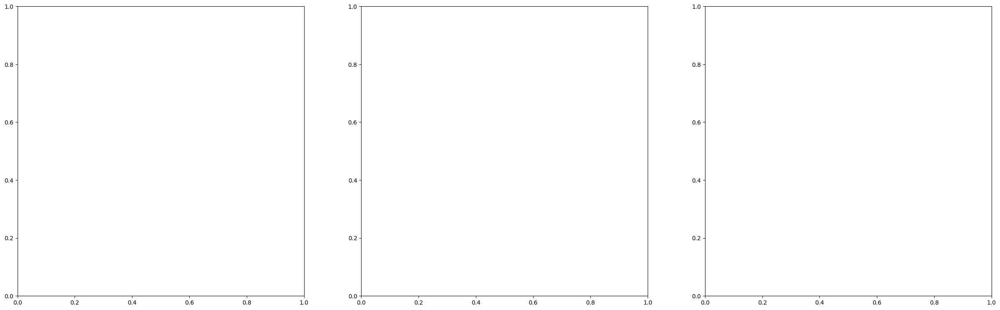

In [ ]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1,3, figsize=(30,9))
ax[0].imshow(read_image_rgb(train_img_pre[3]))
ax[0].axis('off')
ax[1].imshow(read_image_rgb(train_img_post[3]))
ax[1].axis('off')
ax[2].imshow(overlay_damage_mask(
    read_image_rgb(train_img_post[3]),
    read_mask(train_mask_post[3])
))
ax[2].axis('off')
f.tight_layout()
f.show()

In [ ]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1,3, figsize=(30,9))
ax[0].imshow(read_image_rgb(train_img_pre[30]))
ax[0].axis('off')
ax[1].imshow(read_image_rgb(train_img_post[30]))
ax[1].axis('off')
ax[2].imshow(overlay_damage_mask(
    read_image_rgb(train_img_post[30]),
    read_mask(train_mask_post[30])
))
ax[2].axis('off')
f.tight_layout()
f.show()

In [ ]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1,3, figsize=(30,9))
ax[0].imshow(read_image_rgb(train_img_pre[50]))
ax[0].axis('off')
ax[1].imshow(read_image_rgb(train_img_post[50]))
ax[1].axis('off')
ax[2].imshow(overlay_damage_mask(
    read_image_rgb(train_img_post[50]),
    read_mask(train_mask_post[50])
))
ax[2].axis('off')
f.tight_layout()
f.show()

# Image Augmentations
![Albumentations](https://camo.githubusercontent.com/16b1b10ec83ffa96034bce1d8c7fc56b31c4f7a8/68747470733a2f2f616c62756d656e746174696f6e732e72656164746865646f63732e696f2f656e2f6c61746573742f5f7374617469632f6c6f676f2e706e67)

Since we work only with small portion of the training set, it's important to more diversity to our images by adding on-the-fly image augmentations. We can safely rotate our images and masks, slight change their scale, brightness and color during training. This would increase model's generalization and prevent overfitting. The only trick is not to forget augment image and corresponding mask consistently.
The [albumentations](https://github.com/albumentations-team/albumentations) library works with images and masks at the same time, which is what we need. Let's take a look at the example:



## Albumentations crash course

Docs: https://albumentations.ai/docs/
Examples: https://github.com/albumentations-team/albumentations_examples/blob/master/notebooks/pytorch_semantic_segmentation.ipynb

Let's augment single pair of images and see what happens:

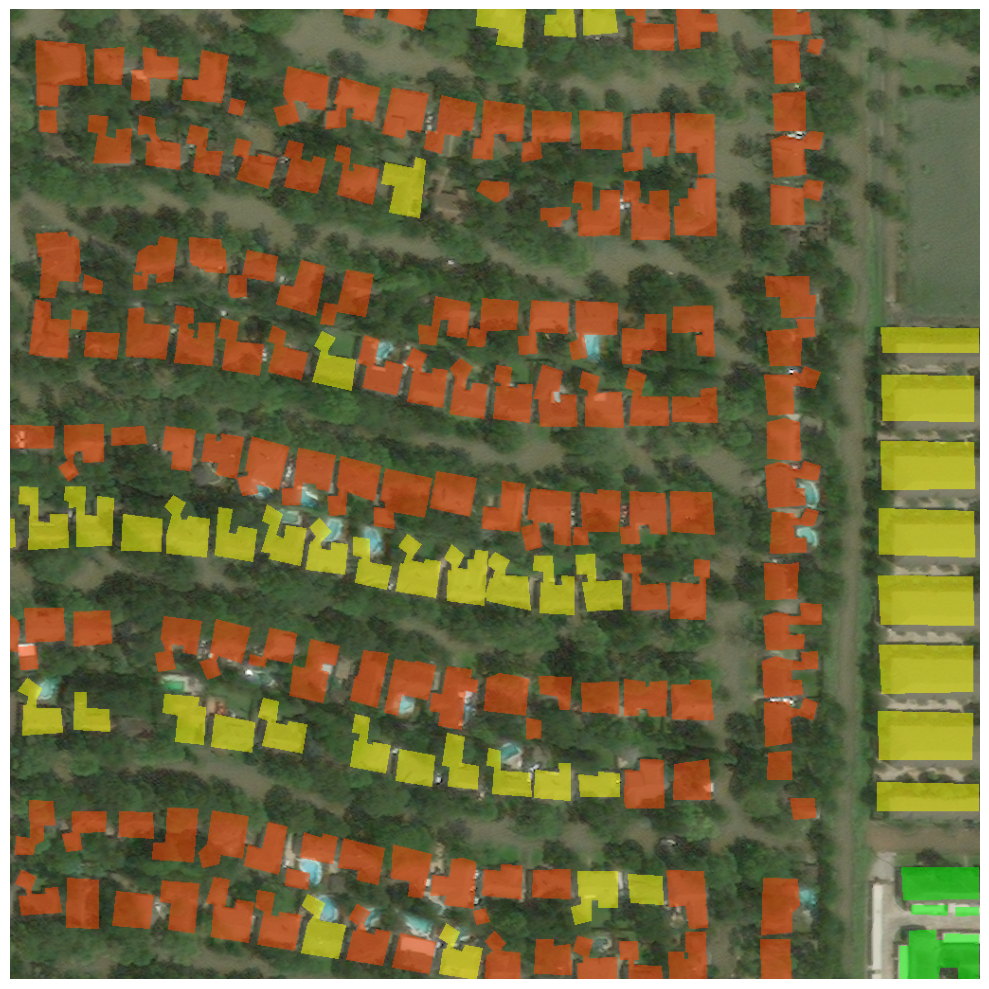

In [ ]:
def show_image(image):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

sample_image = read_image_rgb(train_img_post[16])
sample_mask = read_mask(train_mask_post[16])

show_image(overlay_damage_mask(sample_image, sample_mask))

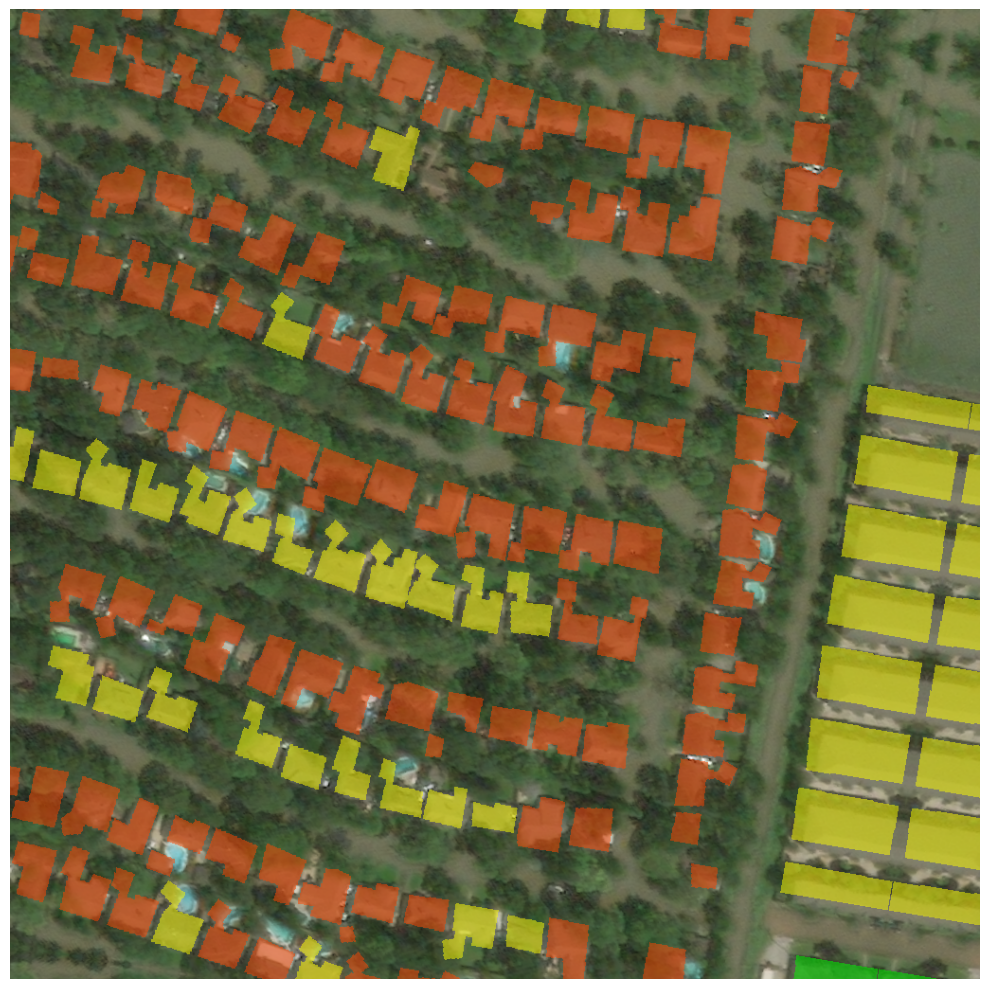

In [ ]:
transform = A.ShiftScaleRotate(scale_limit=0.1, rotate_limit=15, p=1)
augmented = transform(image=sample_image, mask=sample_mask)

show_image(overlay_damage_mask(augmented["image"], augmented["mask"]))


Awesome! Now, let's apply several augmentations sequentially. With Albumentations you can write really sophisticated augmentations. Here we use A.Compose to perform sequential composition of two augmentations:

In [ ]:
sample_image = read_image_rgb(train_img_post[16])
sample_mask = read_mask(train_mask_post[16])

transform = A.Compose([
    A.ShiftScaleRotate(scale_limit=0.5, rotate_limit=15, p=1, border_mode=cv2.BORDER_REFLECT),
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=1),
])

augmented = transform(image=sample_image, mask=sample_mask)

show_image(overlay_damage_mask(augmented["image"], augmented["mask"]))

Output hidden; open in https://colab.research.google.com to view.

**Task**: Try adjusting parameters for `A.RandomShiftScale` and `A.RandomBrightnessContrast` and see how it affects the augmented image. Try to find boundary, where generated images are "way too far off" from the original.

# Load Dataset

Pro Tip: Try playing with `A.Posterize`, `A.CLAHE`, `A.HueSaturationValue` for color augmentations and `A.MaskDropout`, `A.ElasticTransform` and `A.RandomGridShuffle` for spatial augmentations. See https://github.com/albumentations-team/albumentations for all showsace notebooks.

In [ ]:
!pip uninstall imgaug -y
!pip install imgaug

Found existing installation: imgaug 0.4.0
Uninstalling imgaug-0.4.0:
  Successfully uninstalled imgaug-0.4.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 948.0/948.0 kB 55.5 MB/s eta 0:00:00


In [ ]:
import numpy as np
import imgaug.augmenters as iaa
import albumentations as A

def random_crop_and_resize(image, mask, crop_size=(512, 512)):
    mask = to_categorical(mask, 5)

    # escolher coordenadas aleatórias para o corte
    height, width = image.shape[:2]
    max_x = width - crop_size[1]
    max_y = height - crop_size[0]
    x1 = np.random.randint(0, max_x)
    y1 = np.random.randint(0, max_y)
    x2 = x1 + crop_size[1]
    y2 = y1 + crop_size[0]

    # aplicar corte na imagem e redimensioná-la
    image_transform = A.Compose([
        A.Crop(x_min=x1, y_min=y1, x_max=x2, y_max=y2),
        A.Resize(crop_size[0], crop_size[1])
    ])
    data = image_transform(image=image)
    cropped_image = data['image']

    # aplicar corte na máscara e redimensioná-la
    mask_transform = A.Compose([
        A.Crop(x_min=x1, y_min=y1, x_max=x2, y_max=y2),
        A.Resize(crop_size[0], crop_size[1])
    ])
    data = mask_transform(image=mask)
    cropped_mask = data['image']
    class_map = {0: 0, 1: 1, 2: 2, 3: 3, 4: 4}
    cropped_mask = np.argmax(cropped_mask, axis=-1)
    cropped_mask = np.vectorize(class_map.get)(cropped_mask)

    return cropped_image, cropped_mask

def preprocess_image_and_mask(image, mask):
    # escolher aleatoriamente um tamanho de corte entre (448, 448) e (736, 736)
    crop_size = np.random.randint(448, 737)

    # aplicar transformações de aumento de dados
    aug = iaa.Sequential([
        iaa.Fliplr(0.5),
        iaa.Flipud(0.5),
        iaa.Affine(rotate=(-10, 10)),
        iaa.Affine(scale=(0.8, 1.2)),
        iaa.SomeOf((0, 3), [
            iaa.CLAHE(),
            iaa.GaussianBlur(sigma=(0.0, 1.0)),
            iaa.AdditiveGaussianNoise(scale=(0.0, 0.05*255)),
        ]),
        iaa.SomeOf((0, 2), [
             iaa.Affine(scale=(0.5, 1.5), translate_px=(-20, 20)),
            iaa.ContrastNormalization((0.8, 1.2)),
            iaa.ElasticTransformation(alpha=50, sigma=5)
        ], random_order=True)
    ])

    # realizar o corte aleatório e redimensionar a imagem e a máscara
    image, mask = random_crop_and_resize(image, mask, crop_size=[crop_size,crop_size])

    # aplicar transformações de aumento de dados na imagem
    image = aug.augment_image(image)

    # converter a máscara em uma máscara categórica
    mask = to_categorical(mask, 5)

    # redimensionar a imagem para o tamanho original (1024, 1024) com as 4 test-time augmentations
    resize_transform = A.Compose([
        A.Resize(1024, 1024),
        A.HorizontalFlip(p=1.0),
        A.VerticalFlip(p=1.0),
        A.Rotate(limit=180, p=1.0)
    ])
    data = resize_transform(image=image, mask=mask)
    image = data['image']
    mask = data['mask']

    return image, mask

In [ ]:
import tensorflow as tf
from keras.utils import to_categorical

class ImageMaskDataset(Dataset):
    def __init__(
        self,
        pre_image_filenames: List[str],
        post_image_filenames: List[str],
        post_mask_filenames: Optional[List[str]],
        pre_processing: bool = False
    ):
        assert len(pre_image_filenames) == len(post_image_filenames)

        self.pre_image_filenames = pre_image_filenames
        self.post_image_filenames = post_image_filenames
        self.post_mask_filenames = post_mask_filenames

        self.pre_processing = pre_processing

    def __getitem__(self, index):
        pre_image = read_image_rgb(self.pre_image_filenames[index]) # 1024x1024x3
        post_image = read_image_rgb(self.post_image_filenames[index]) # 1024x1024x3
        mask = read_mask(self.post_mask_filenames[index]) # 1024x1024

        image = np.dstack([pre_image, post_image]) # 1024x1024x6
        image = image.astype(np.uint8)

        #if self.pre_processing is not False:
        #  image, mask = preprocess_image_and_mask(image,mask)

        #convert mask em tensor
        image = tf.convert_to_tensor(image, dtype=tf.float32)#tf.uint8 para visualização
        mask = tf.convert_to_tensor(mask, dtype=tf.float32) #tf.uint8 para visualização
        #mask = to_categorical(mask, 5) #mascara categórica para modelo

        return image, mask

    def __len__(self):
        return len(self.pre_image_filenames)

In [ ]:
train_ds = ImageMaskDataset(
    train_img_pre,
    train_img_post,
    train_mask_post,
    pre_processing=True,
)

valid_ds = ImageMaskDataset(
    valid_img_pre,
    valid_img_post,
    valid_mask_post,
    pre_processing=True,
)

holdout_ds = ImageMaskDataset(
    holdout_img_pre,
    holdout_img_post,
    holdout_mask_post,
    pre_processing=True,
)

print(len(train_ds), len(valid_ds), len(holdout_ds))

2799 906 933


In [ ]:
train_ds[0][0]

<tf.Tensor: shape=(1024, 1024, 6), dtype=float32, numpy=
array([[[ 65.,  73.,  59.,  55.,  65.,  56.],
        [ 65.,  73.,  59.,  55.,  65.,  56.],
        [ 64.,  72.,  59.,  50.,  59.,  50.],
        ...,
        [ 56.,  60.,  49.,  92., 101.,  86.],
        [ 69.,  73.,  64.,  95., 104.,  89.],
        [ 70.,  74.,  65.,  99., 109.,  95.]],

       [[ 68.,  76.,  61.,  55.,  66.,  57.],
        [ 71.,  79.,  65.,  55.,  65.,  56.],
        [ 73.,  82.,  68.,  55.,  65.,  56.],
        ...,
        [ 60.,  65.,  54.,  92., 101.,  86.],
        [ 66.,  71.,  61.,  92., 101.,  87.],
        [ 70.,  75.,  66.,  95., 105.,  90.]],

       [[ 68.,  75.,  59.,  53.,  63.,  54.],
        [ 70.,  77.,  62.,  55.,  65.,  56.],
        [ 71.,  77.,  63.,  59.,  68.,  59.],
        ...,
        [ 65.,  70.,  59.,  95., 104.,  89.],
        [ 64.,  69.,  59.,  97., 106.,  92.],
        [ 68.,  73.,  63.,  99., 109.,  95.]],

       ...,

       [[ 78.,  81.,  71.,  66.,  70.,  57.],
        [ 7

In [ ]:
train_ds[0][1]

<tf.Tensor: shape=(1024, 1024), dtype=float32, numpy=
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)>

In [ ]:
print(train_ds[0][0].shape)
print(train_ds[0][1].shape)

(1024, 1024, 6)
(1024, 1024)


In [ ]:
import keras

class Dataloder(keras.utils.Sequence):
    """Load data from dataset and form batches

    Args:
        dataset: instance of Dataset class for image loading and preprocessing.
        batch_size: Integet number of images in batch.
        shuffle: Boolean, if `True` shuffle image indexes each epoch.
    """

    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

        self.on_epoch_end()

    def __getitem__(self, i):

        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])

        # transpose list of lists
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]

        return batch

    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.indexes) // self.batch_size

    def on_epoch_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [ ]:
# Crie um gerador de lotes usando o DataLoader e sua classe ImageMaskDataset
train_loader = Dataloder(train_ds, batch_size=3, shuffle=True)
valid_loader = Dataloder(valid_ds, batch_size=3, shuffle=False)
holdout_loader = Dataloder(holdout_ds, batch_size=3, shuffle=False)

In [ ]:
print(train_loader[0][0][0].shape)
print(train_loader[0][1][0].shape)

print(valid_loader[0][0][0].shape)
print(valid_loader[0][1][0].shape)

print(holdout_loader[0][0][0].shape)
print(holdout_loader[0][1][0].shape)

(1024, 1024, 6)
(1024, 1024)
(1024, 1024, 6)
(1024, 1024)
(1024, 1024, 6)
(1024, 1024)


## Visualize Data

In [ ]:
import matplotlib.pyplot as plt
def show_sample(image, damage_mask):
    f, ax = plt.subplots(1,4, figsize=(30,9))
    ax[0].imshow(image[:,:,:3])
    ax[0].axis('off')
    ax[1].imshow(image[:,:,3:])
    ax[1].axis('off')
    ax[2].imshow(overlay_damage_mask(image[:,:,:3], damage_mask))
    ax[2].axis('off')
    ax[3].imshow(overlay_damage_mask(image[:,:,3:], damage_mask))
    ax[3].axis('off')
    f.tight_layout()
    f.show()

In [ ]:
show_sample(train_loader[0][0][0],train_loader[0][1][0])

Output hidden; open in https://colab.research.google.com to view.

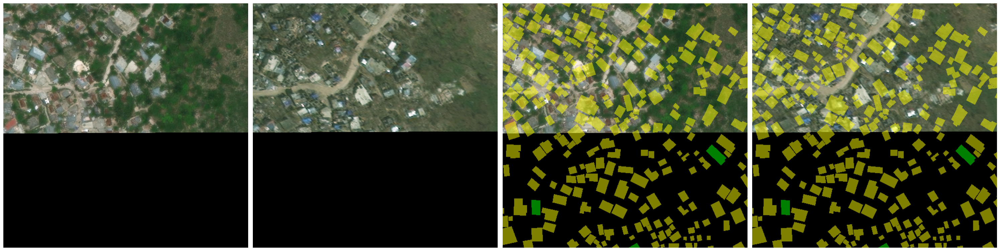

In [ ]:
show_sample(train_loader[0][0][0],train_loader[0][1][0])

In [ ]:
show_sample(train_loader[0][0][4],train_loader[0][1][4])

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
show_sample(train_loader[0][0][4],train_loader[0][1][4])

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
show_sample(valid_loader[0][0][0],valid_loader[0][1][0])

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
show_sample(valid_loader[0][0][0],valid_loader[0][1][0])

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
show_sample(valid_loader[0][0][1],valid_loader[0][1][1])

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
show_sample(valid_loader[0][0][1],valid_loader[0][1][1])

Output hidden; open in https://colab.research.google.com to view.

#Train

In [ ]:
import segmentation_models as sm
from segmentation_models import Unet
from segmentation_models import Linknet
from segmentation_models import FPN
from segmentation_models import PSPNet

from keras.layers import Input, Conv2D
from keras.models import Model

from tqdm import tqdm
import matplotlib.pyplot as plt

from keras.optimizers import Adam
from keras.regularizers import l2

Segmentation Models: using `keras` framework.


In [ ]:
from keras.optimizers import Adam
from tensorflow.keras.optimizers.schedules import InverseTimeDecay
from tensorflow.keras.optimizers.schedules import PiecewiseConstantDecay
from keras import backend as K

class AdamW(Adam):
    """Otimizador Adam com correção de decaimento de peso (Weight Decay).
    # Argumentos
        learning_rate: float >= 0. Taxa de aprendizado.
        weight_decay: float >= 0. Taxa de decaimento de peso.
        beta_1: float, 0 < beta < 1. Fator de decaimento para o primeiro momento estimado.
        beta_2: float, 0 < beta < 1. Fator de decaimento para o segundo momento estimado.
        epsilon: float >= 0. Epsilon para evitar divisão por zero.
        amsgrad: boolean. Se True, aplica a variante AMSGrad do Adam.
        name: nome do otimizador.
        decay_schedule_fn: Função que recebe um step (inteiro) e retorna a taxa de decaimento (float).
    """

    def __init__(self, learning_rate=0.001, weight_decay=0.01, beta_1=0.9,
                 beta_2=0.999, epsilon=1e-7, amsgrad=False, name="AdamW",
                 decay_schedule_fn=None, **kwargs):
        super().__init__(learning_rate=learning_rate, beta_1=beta_1, beta_2=beta_2,
                         epsilon=epsilon, amsgrad=amsgrad, name=name, **kwargs)
        self.weight_decay = weight_decay
        self.decay_schedule_fn = decay_schedule_fn
        self.apply_decay = weight_decay != 0.

    def get_updates(self, loss, params):
        gradients = self.get_gradients(loss, params)
        self.updates = [K.update_add(self.iterations, 1)]

        learning_rate = self.learning_rate
        if self.decay_schedule_fn:
            learning_rate = learning_rate * (1.0 / (1.0 + self.decay_schedule_fn(self.iterations)))

        # Apply Weight Decay
        if self.apply_decay:
            for i, (param, grad) in enumerate(zip(params, gradients)):
                if self._is_trainable(param):
                    gradients[i] = grad + self.weight_decay * param

        # Apply other updates as per the Adam optimizer
        self.get_updates_helper(
            params, gradients, learning_rate=learning_rate, beta_1=self.beta_1,
            beta_2=self.beta_2, epsilon=self.epsilon)

        return self.updates

In [ ]:
def train_experiment(name, epochs, weights_loss, LR_optim, model, train_loader, valid_loader, save_path):
  #Compile
  inp = Input(shape=(1024, 1024, 6))
  l1 = Conv2D(3, (1, 1))(inp) # map N channels data to 3 channels
  out = model(l1)
  model = Model(inp, out, name=model.name)
  dice_loss = sm.losses.DiceLoss(class_weights=weights_loss)
  focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
  total_loss = dice_loss + (1 * focal_loss)
  optim = AdamW(weight_decay=1e-6, learning_rate=0.0001)
  metrics = [sm.metrics.FScore()]
  model.compile(optimizer='adam', loss=total_loss, metrics=metrics)

  #Train
  history = model.fit(train_loader, epochs=epochs, validation_data=valid_loader)

  #Plot
  plt.figure(figsize=(30, 5))
  plt.subplot(121)
  plt.plot(history.history['f1-score'])
  plt.plot(history.history['val_f1-score'])
  plt.title('Model f1-score')
  plt.ylabel('f1-score')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')
  plt.subplot(122)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('Model loss')
  plt.ylabel('Loss')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')
  plt.show()

  #Save
  caminho_pasta = save_path+name
  if not os.path.exists(caminho_pasta):
    # cria a pasta
    os.mkdir(caminho_pasta)
    print(f'Pasta "{name}" criada com sucesso!')
  else:
      print(f'Pasta "{name}" já existe.')

  model.save(caminho_pasta+name+'.hdf5')

  #Del
  del model

  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1/40
100/100 [==============================] - 1158s 12s/step - loss: 0.8433 - f1-score: 0.1792 - val_loss: 0.8526 - val_f1-score: 0.1859
Epoch 2/40
100/100 [==============================] - 231s 2s/step - loss: 0.8262 - f1-score: 0.1930 - val_loss: 0.8333 - val_f1-score: 0.1874
Epoch 3/40
100/100 [==============================] - 222s 2s/step - loss: 0.8267 - f1-score: 0.1919 - val_loss: 0.8276 - val_f1-score: 0.1906
Epoch 4/40
100/100 [==============================] - 230s 2s/step - loss: 0.8279 - f1-score: 0.1919 - val_loss: 0.8296 - val_f1-score: 0.1930
Epoch 5/40
100/100 [==============================] - 230s 2s/step - loss: 0.8267 - f1-score: 0.1920 - val_loss: 0.8310 - val_f1-score: 0.1926
Epoch 6/40
100/100 [==============================] - 231s 2s/step - loss: 0.8262 - f1-score: 0.1929 - val_loss: 0.8334 - val_f1-score: 0.1866
Epoch 7/40
100/100 [==============================] - 227s 2s/step - loss: 0.8272 - f1-score: 0.1921 - val_loss: 0.8329 - val_f1-score: 0.18

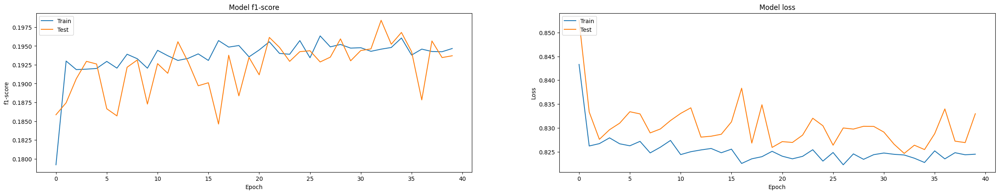

Pasta "Unet_vgg16" já existe.


 33%|███▎      | 1/3 [2:45:56<5:31:52, 9956.37s/it]

94592056/94592056 [==============================] - 78s 1us/step
Epoch 1/40
100/100 [==============================] - 202s 2s/step - loss: 0.8428 - f1-score: 0.1797 - val_loss: 0.8952 - val_f1-score: 0.1904
Epoch 2/40
100/100 [==============================] - 185s 2s/step - loss: 0.8272 - f1-score: 0.1920 - val_loss: 0.8367 - val_f1-score: 0.1852
Epoch 3/40
100/100 [==============================] - 186s 2s/step - loss: 0.8257 - f1-score: 0.1934 - val_loss: 0.9162 - val_f1-score: 0.1873
Epoch 4/40
100/100 [==============================] - 185s 2s/step - loss: 0.8244 - f1-score: 0.1948 - val_loss: 0.8467 - val_f1-score: 0.1850
Epoch 5/40
100/100 [==============================] - 184s 2s/step - loss: 0.8258 - f1-score: 0.1937 - val_loss: 0.8290 - val_f1-score: 0.1936
Epoch 6/40
100/100 [==============================] - 183s 2s/step - loss: 0.8249 - f1-score: 0.1943 - val_loss: 0.8266 - val_f1-score: 0.1978
Epoch 7/40
100/100 [==============================] - 185s 2s/step - loss: 0

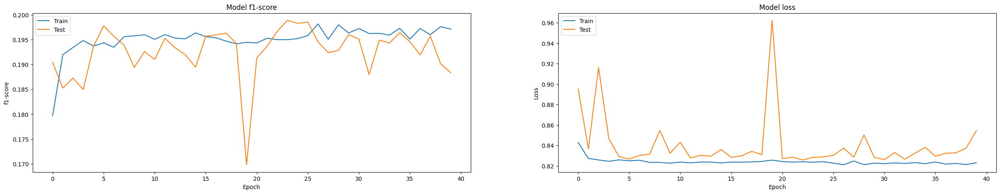

Pasta "Unet_resnet50" já existe.


 67%|██████▋   | 2/3 [4:52:31<2:22:47, 8567.55s/it]

234326024/234326024 [==============================] - 14s 0us/step
Epoch 1/40


 67%|██████▋   | 2/3 [4:53:20<2:26:40, 8800.20s/it]


ResourceExhaustedError: ignored

In [ ]:
#Experiments Unet
list_backbones = ['vgg16','resnet50',
                  'resnet152']

for backbone in tqdm(list_backbones):
  #Parms
  name = 'Unet_' + backbone
  n_classes = 5
  LR_optim = 0.0001
  epochs = 40
  weights_loss = np.array([1, 1, 1, 1, 1])
  save_path = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/'
  #Model
  model = Unet(backbone_name=backbone, classes=n_classes, activation='softmax', encoder_weights='imagenet')
  #Experiments
  train_experiment(name=name,
                  epochs=epochs,
                  weights_loss=weights_loss,
                  LR_optim=LR_optim,
                  model=model,
                  train_loader=train_loader,
                  valid_loader=valid_loader,
                  save_path=save_path)

  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1/40
100/100 [==============================] - 210s 2s/step - loss: 0.7933 - f1-score: 0.2285 - val_loss: 0.9578 - val_f1-score: 0.1611
Epoch 2/40
100/100 [==============================] - 205s 2s/step - loss: 0.7538 - f1-score: 0.2686 - val_loss: 0.7808 - val_f1-score: 0.2498
Epoch 3/40
100/100 [==============================] - 201s 2s/step - loss: 0.7382 - f1-score: 0.2857 - val_loss: 0.8359 - val_f1-score: 0.2216
Epoch 4/40
100/100 [==============================] - 200s 2s/step - loss: 0.7267 - f1-score: 0.2980 - val_loss: 0.7423 - val_f1-score: 0.2841
Epoch 5/40
100/100 [==============================] - 200s 2s/step - loss: 0.7173 - f1-score: 0.3077 - val_loss: 0.7491 - val_f1-score: 0.2804
Epoch 6/40
100/100 [==============================] - 200s 2s/step - loss: 0.7105 - f1-score: 0.3149 - val_loss: 0.7377 - val_f1-score: 0.2877
Epoch 7/40
100/100 [==============================] - 199s 2s/step - loss: 0.7054 - f1-score: 0.3199 - val_loss: 0.7223 - val_f1-score: 0.3031

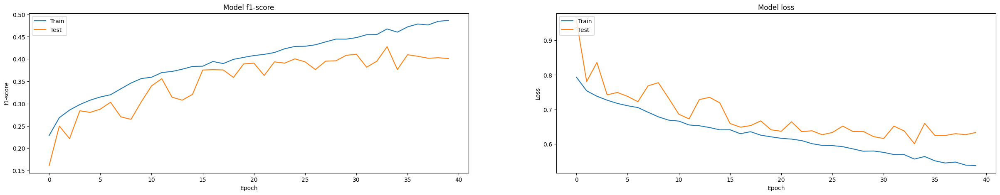

Pasta "Linknet_vgg16" criada com sucesso!


 33%|███▎      | 1/3 [2:13:10<4:26:21, 7990.73s/it]

Epoch 1/40
100/100 [==============================] - 105s 1s/step - loss: 0.7911 - f1-score: 0.2327 - val_loss: 1.2139 - val_f1-score: 0.1466
Epoch 2/40
100/100 [==============================] - 101s 1s/step - loss: 0.6915 - f1-score: 0.3332 - val_loss: 0.8344 - val_f1-score: 0.2310
Epoch 3/40
100/100 [==============================] - 101s 1s/step - loss: 0.6618 - f1-score: 0.3653 - val_loss: 0.9078 - val_f1-score: 0.2223
Epoch 4/40
100/100 [==============================] - 100s 1s/step - loss: 0.6398 - f1-score: 0.3870 - val_loss: 0.7437 - val_f1-score: 0.3094
Epoch 5/40
100/100 [==============================] - 100s 1s/step - loss: 0.6244 - f1-score: 0.4022 - val_loss: 0.6533 - val_f1-score: 0.3839
Epoch 6/40
100/100 [==============================] - 101s 1s/step - loss: 0.6189 - f1-score: 0.4082 - val_loss: 0.6565 - val_f1-score: 0.3758
Epoch 7/40
100/100 [==============================] - 101s 1s/step - loss: 0.5946 - f1-score: 0.4311 - val_loss: 0.6938 - val_f1-score: 0.3479

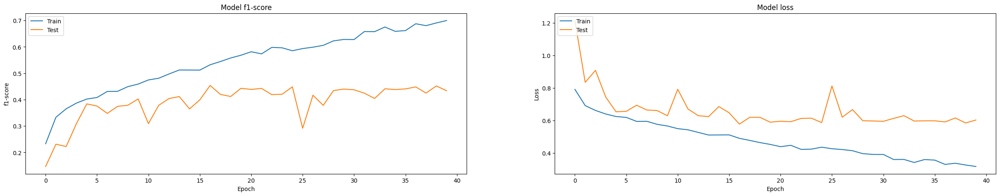

Pasta "Linknet_resnet18" criada com sucesso!


 67%|██████▋   | 2/3 [3:20:28<1:34:25, 5665.24s/it]

94592056/94592056 [==============================] - 5s 0us/step
Epoch 1/40
100/100 [==============================] - 180s 2s/step - loss: 0.7783 - f1-score: 0.2429 - val_loss: 0.9294 - val_f1-score: 0.1864
Epoch 2/40
100/100 [==============================] - 167s 2s/step - loss: 0.7086 - f1-score: 0.3141 - val_loss: 0.8741 - val_f1-score: 0.2318
Epoch 3/40
100/100 [==============================] - 166s 2s/step - loss: 0.6745 - f1-score: 0.3496 - val_loss: 0.8038 - val_f1-score: 0.2818
Epoch 4/40
100/100 [==============================] - 166s 2s/step - loss: 0.6507 - f1-score: 0.3725 - val_loss: 0.8581 - val_f1-score: 0.2372
Epoch 5/40
100/100 [==============================] - 166s 2s/step - loss: 0.6295 - f1-score: 0.3935 - val_loss: 0.6572 - val_f1-score: 0.3707
Epoch 6/40
100/100 [==============================] - 166s 2s/step - loss: 0.6209 - f1-score: 0.4020 - val_loss: 0.7113 - val_f1-score: 0.3359
Epoch 7/40
100/100 [==============================] - 166s 2s/step - loss: 0.

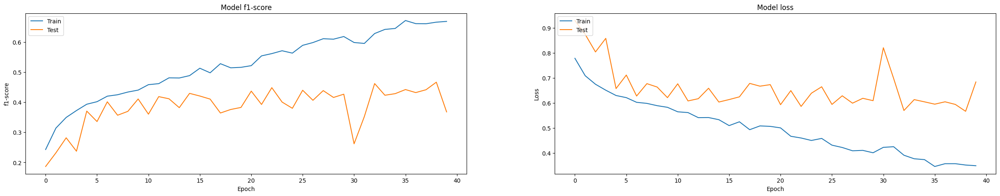

Pasta "Linknet_resnet50" criada com sucesso!


100%|██████████| 3/3 [5:11:35<00:00, 6231.75s/it]


In [ ]:
#Experiments Unet
list_backbones = ['vgg16','resnet18','resnet50']

for backbone in tqdm(list_backbones):
  session = tf.compat.v1.InteractiveSession()
  #Parms
  name = 'Linknet_' + backbone
  n_classes = 5
  LR_optim = 0.0001
  epochs = 40
  weights_loss = np.array([1, 1, 1, 1, 1])
  save_path = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/'
  #Model
  model = Linknet(backbone_name=backbone, classes=n_classes, activation='softmax', encoder_weights='imagenet')
  #Experiments
  train_experiment(name=name,
                  epochs=epochs,
                  weights_loss=weights_loss,
                  LR_optim=LR_optim,
                  model=model,
                  train_loader=train_loader,
                  valid_loader=valid_loader,
                  save_path=save_path)
  tf.compat.v1.keras.backend.clear_session()
  tf.config.experimental.list_physical_devices('GPU')
  session.close()

In [ ]:
#Experiments FPN
list_backbones = ['vgg16','resnet18','resnet50']

for backbone in tqdm(list_backbones):
  session = tf.compat.v1.InteractiveSession()
  #Parms
  name = 'FPN_' + backbone
  n_classes = 5
  LR_optim = 0.0001
  epochs = 40
  weights_loss = np.array([1, 1, 1, 1, 1])
  save_path = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/'
  #Model
  model = FPN(backbone_name=backbone, classes=n_classes, activation='softmax', encoder_weights='imagenet')
  #Experiments
  train_experiment(name=name,
                  epochs=epochs,
                  weights_loss=weights_loss,
                  LR_optim=LR_optim,
                  model=model,
                  train_loader=train_loader,
                  valid_loader=valid_loader,
                  save_path=save_path)
  tf.compat.v1.keras.backend.clear_session()
  tf.config.experimental.list_physical_devices('GPU')
  session.close()

  0%|          | 0/3 [00:00<?, ?it/s]

58889256/58889256 [==============================] - 0s 0us/step


/usr/local/lib/python3.9/dist-packages/imgaug/imgaug.py:184: DeprecationWarning:

Function `ContrastNormalization()` is deprecated. Use `imgaug.contrast.LinearContrast` instead.

/usr/local/lib/python3.9/dist-packages/imgaug/augmenters/contrast.py:834: UserWarning:

Got image with 6 channels in _IntensityChannelBasedApplier (parents: UnnamedSequential, UnnamedSomeOf, UnnamedCLAHE), expected 0, 1, 3 or 4 channels.



Epoch 1/40
200/200 [==============================] - 2266s 11s/step - loss: 0.8297 - f1-score: 0.1923 - val_loss: 0.8452 - val_f1-score: 0.1775
Epoch 2/40
200/200 [==============================] - 227s 1s/step - loss: 0.8231 - f1-score: 0.1946 - val_loss: 0.8603 - val_f1-score: 0.1868
Epoch 3/40
200/200 [==============================] - 228s 1s/step - loss: 0.8216 - f1-score: 0.1954 - val_loss: 0.8352 - val_f1-score: 0.1919
Epoch 4/40
200/200 [==============================] - 230s 1s/step - loss: 0.8225 - f1-score: 0.1953 - val_loss: 0.8396 - val_f1-score: 0.1849
Epoch 5/40
200/200 [==============================] - 230s 1s/step - loss: 0.8219 - f1-score: 0.1957 - val_loss: 0.8395 - val_f1-score: 0.1925
Epoch 6/40
200/200 [==============================] - 227s 1s/step - loss: 0.8206 - f1-score: 0.1960 - val_loss: 0.8462 - val_f1-score: 0.1748
Epoch 7/40
200/200 [==============================] - 228s 1s/step - loss: 0.8207 - f1-score: 0.1953 - val_loss: 0.8331 - val_f1-score: 0.19

In [ ]:
#Experiments PSPNet
list_backbones = ['vgg16','resnet18','resnet50']

for backbone in tqdm(list_backbones):
  session = tf.compat.v1.InteractiveSession()
  #Parms
  name = 'PSPNet_' + backbone
  n_classes = 5
  LR_optim = 0.0001
  epochs = 40
  weights_loss = np.array([1, 1, 1, 1, 1])
  save_path = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/'
  #Model
  model = PSPNet(backbone_name=backbone, classes=n_classes, activation='softmax', encoder_weights='imagenet')
  #Experiments
  train_experiment(name=name,
                  epochs=epochs,
                  weights_loss=weights_loss,
                  LR_optim=LR_optim,
                  model=model,
                  train_loader=train_loader,
                  valid_loader=valid_loader,
                  save_path=save_path)
  tf.compat.v1.keras.backend.clear_session()
  tf.config.experimental.list_physical_devices('GPU')
  session.close()

In [ ]:
['resnet34','resnext50','senet154']

# Train Siamese Models

In [ ]:
import tensorflow as tf
from keras.utils import to_categorical

class ImageMaskDataset(Dataset):
    def __init__(
        self,
        pre_image_filenames: List[str],
        post_image_filenames: List[str],
        post_mask_filenames: Optional[List[str]],
        pre_processing: bool = False
    ):
        assert len(pre_image_filenames) == len(post_image_filenames)

        self.pre_image_filenames = pre_image_filenames
        self.post_image_filenames = post_image_filenames
        self.post_mask_filenames = post_mask_filenames

        self.pre_processing = pre_processing

    def __getitem__(self, index):
        pre_image = read_image_rgb(self.pre_image_filenames[index]) # 1024x1024x3
        post_image = read_image_rgb(self.post_image_filenames[index]) # 1024x1024x3
        mask = read_mask(self.post_mask_filenames[index]) # 1024x1024

        image_pre = pre_image.astype(np.uint8)
        image_post = post_image.astype(np.uint8)

        if self.pre_processing is not False:
            image_pre, mask_pre = preprocess_image_and_mask(image_pre, mask)
            image_post, mask_post = preprocess_image_and_mask(image_post, mask)
            mask = to_categorical(mask, 5)

        # convert images to tensors
        image_pre = tf.convert_to_tensor(image_pre, dtype=tf.float32)
        image_post = tf.convert_to_tensor(image_post, dtype=tf.float32)

        return (image_pre, image_post), mask

    def __len__(self):
        return len(self.pre_image_filenames)

In [ ]:
train_ds = ImageMaskDataset(
    train_img_pre,
    train_img_post,
    train_mask_post,
    pre_processing=True,
)

valid_ds = ImageMaskDataset(
    valid_img_pre,
    valid_img_post,
    valid_mask_post,
    pre_processing=True,
)

holdout_ds = ImageMaskDataset(
    holdout_img_pre,
    holdout_img_post,
    holdout_mask_post,
    pre_processing=True,
)

print(len(train_ds), len(valid_ds), len(holdout_ds))

300 50 10


In [ ]:
train_ds[0]

/usr/local/lib/python3.9/dist-packages/imgaug/imgaug.py:184: DeprecationWarning:

Function `ContrastNormalization()` is deprecated. Use `imgaug.contrast.LinearContrast` instead.



((<tf.Tensor: shape=(1024, 1024, 3), dtype=float32, numpy=
  array([[[106., 119.,  95.],
          [112., 123., 100.],
          [117., 126., 104.],
          ...,
          [ 95., 109.,  84.],
          [ 94., 108.,  83.],
          [ 92., 108.,  81.]],
  
         [[118., 129., 105.],
          [125., 134., 110.],
          [130., 137., 114.],
          ...,
          [ 97., 111.,  86.],
          [ 95., 110.,  84.],
          [ 93., 109.,  83.]],
  
         [[123., 132., 108.],
          [130., 137., 114.],
          [135., 141., 118.],
          ...,
          [100., 114.,  88.],
          [ 98., 113.,  87.],
          [ 95., 112.,  85.]],
  
         ...,
  
         [[  0.,   0.,   0.],
          [  0.,   0.,   0.],
          [  0.,   0.,   0.],
          ...,
          [  0.,   0.,   0.],
          [  0.,   0.,   0.],
          [  0.,   0.,   0.]],
  
         [[  0.,   0.,   0.],
          [  0.,   0.,   0.],
          [  0.,   0.,   0.],
          ...,
          [  0.,   0., 

In [ ]:
import keras
from keras.utils import Sequence

class SiameseDataLoader(Sequence):
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

        self.on_epoch_end()

    def __getitem__(self, i):
      start = i * self.batch_size
      stop = (i + 1) * self.batch_size
      data = [self.dataset[j] for j in range(start, stop)]
      batch_pre = tf.stack([pre for pre, post in data])
      batch_post = tf.stack([post for pre, post in data])

      return (batch_pre, batch_post)


    def __len__(self):
        return len(self.indexes) // self.batch_size

    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [ ]:
# Crie um gerador de lotes usando o DataLoader e sua classe ImageMaskDataset
train_loader = SiameseDataLoader(train_ds, batch_size=3, shuffle=True)
valid_loader = SiameseDataLoader(valid_ds, batch_size=3, shuffle=False)
holdout_loader = SiameseDataLoader(holdout_ds, batch_size=3, shuffle=False)

In [ ]:
train_loader[0][0][0]

<tf.Tensor: shape=(2, 1024, 1024, 3), dtype=float32, numpy=
array([[[[149., 159., 129.],
         [163., 173., 141.],
         [153., 165., 133.],
         ...,
         [  9.,  36.,   6.],
         [  6.,  32.,   3.],
         [  4.,  30.,   2.]],

        [[151., 160., 130.],
         [165., 174., 142.],
         [165., 176., 144.],
         ...,
         [  9.,  35.,   4.],
         [  8.,  35.,   4.],
         [  7.,  33.,   4.]],

        [[160., 168., 138.],
         [172., 180., 149.],
         [171., 179., 147.],
         ...,
         [  9.,  36.,   4.],
         [  9.,  36.,   5.],
         [ 10.,  37.,   8.]],

        ...,

        [[ 69.,  86.,  63.],
         [ 53.,  71.,  48.],
         [ 46.,  65.,  41.],
         ...,
         [ 95., 108.,  81.],
         [ 85.,  99.,  72.],
         [ 77.,  91.,  65.]],

        [[ 81.,  98.,  74.],
         [ 54.,  72.,  49.],
         [ 43.,  62.,  39.],
         ...,
         [111., 125.,  96.],
         [ 99., 112.,  85.],
       

In [ ]:
print(train_loader[0][1][0].shape)
print(valid_loader[0][1][0].shape)
print(holdout_loader[0][1][0].shape)

(1024, 1024, 5)
(1024, 1024, 5)
(1024, 1024, 5)


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Input, Lambda, Conv2D

# Definindo uma função personalizada para quebrar a entrada em duas partes
def split_input(x):
    return [x[:, i, ...] for i in range(2)]

def create_siamese_model(input_shape, backbone, n_classes):
    input_tensor = Input(shape=input_shape)

    # Define as duas entradas da rede siamese
    input1, input2 = Lambda(split_input)(input_tensor)

    # Instanciar duas cópias da U-Net, uma para cada entrada
    model1 = Linknet(backbone_name=backbone, classes=n_classes, activation='softmax', encoder_weights='imagenet')
    model2 = Linknet(backbone_name=backbone, classes=n_classes, activation='softmax', encoder_weights='imagenet')

    # Passar cada entrada pela sua respectiva cópia da U-Net
    x1 = model1(input1)
    x2 = model2(input2)

    # Calcular a diferença absoluta entre as saídas das duas U-Nets
    diff = layers.Lambda(lambda x: tf.abs(x[0] - x[1]))([x1, x2])

    # Camada densa para prever a similaridade
    similarity = layers.Dense(n_classes, activation='softmax')(diff)

    # Definir o modelo
    siamese_model = Model(inputs=input_tensor, outputs=similarity)

    return siamese_model

In [ ]:
input_shape = (2, 1024, 1024, 3)
model = create_siamese_model(input_shape,'resnext50',5)

n_classes = 5
LR_optim = 0.0001
epochs = 40
weights_loss = np.array([1, 1, 1, 1, 1])

dice_loss = sm.losses.DiceLoss(class_weights=weights_loss)
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)
optim = AdamW(weight_decay=1e-6, learning_rate=0.0001)
metrics = [sm.metrics.FScore()]
model.compile(optimizer=optim, loss=total_loss, metrics=metrics)

In [ ]:
model.summary()

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 2, 1024, 10  0           []                               
                                24, 3)]                                                           
                                                                                                  
 lambda_1026 (Lambda)           [(None, 1024, 1024,  0           ['input_2[0][0]']                
                                 3),                                                              
                                 (None, 1024, 1024,                                               
                                 3)]                                                              
                                                                                            

In [ ]:
#Train
history = model.fit(train_loader, epochs=epochs, validation_data=valid_loader)

Epoch 1/40
100/100 [==============================] - 1119s 10s/step - loss: 0.9366 - f1-score: 0.1083 - val_loss: 0.9326 - val_f1-score: 0.1128
Epoch 2/40
100/100 [==============================] - 639s 6s/step - loss: 0.9197 - f1-score: 0.1178 - val_loss: 0.9127 - val_f1-score: 0.1241
Epoch 3/40
100/100 [==============================] - 638s 6s/step - loss: 0.9090 - f1-score: 0.1243 - val_loss: 0.9030 - val_f1-score: 0.1300
Epoch 4/40
100/100 [==============================] - 635s 6s/step - loss: 0.9024 - f1-score: 0.1284 - val_loss: 0.8968 - val_f1-score: 0.1341
Epoch 5/40
100/100 [==============================] - 636s 6s/step - loss: 0.8971 - f1-score: 0.1318 - val_loss: 0.8924 - val_f1-score: 0.1370
Epoch 6/40
100/100 [==============================] - 637s 6s/step - loss: 0.8927 - f1-score: 0.1348 - val_loss: 0.8880 - val_f1-score: 0.1399
Epoch 7/40
100/100 [==============================] - 635s 6s/step - loss: 0.8885 - f1-score: 0.1376 - val_loss: 0.8841 - val_f1-score: 0.14

In [ ]:
#Plot
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['f1-score'])
plt.plot(history.history['val_f1-score'])
plt.title('Model f1-score')
plt.ylabel('f1-score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
save_path = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/'

In [ ]:
model.save(save_path+'model_siames.hdf5')

# Train Difference of Images

In [ ]:
import segmentation_models as sm
from segmentation_models import Unet
from segmentation_models import Linknet
from segmentation_models import FPN
from segmentation_models import PSPNet

from keras.layers import Input, Conv2D
from keras.models import Model

from tqdm import tqdm
import matplotlib.pyplot as plt

from keras.optimizers import Adam
from keras.regularizers import l2

Segmentation Models: using `keras` framework.


In [ ]:
from keras.optimizers import Adam
from tensorflow.keras.optimizers.schedules import InverseTimeDecay
from tensorflow.keras.optimizers.schedules import PiecewiseConstantDecay
from keras import backend as K

class AdamW(Adam):
    """Otimizador Adam com correção de decaimento de peso (Weight Decay).
    # Argumentos
        learning_rate: float >= 0. Taxa de aprendizado.
        weight_decay: float >= 0. Taxa de decaimento de peso.
        beta_1: float, 0 < beta < 1. Fator de decaimento para o primeiro momento estimado.
        beta_2: float, 0 < beta < 1. Fator de decaimento para o segundo momento estimado.
        epsilon: float >= 0. Epsilon para evitar divisão por zero.
        amsgrad: boolean. Se True, aplica a variante AMSGrad do Adam.
        name: nome do otimizador.
        decay_schedule_fn: Função que recebe um step (inteiro) e retorna a taxa de decaimento (float).
    """

    def __init__(self, learning_rate=0.001, weight_decay=0.01, beta_1=0.9,
                 beta_2=0.999, epsilon=1e-7, amsgrad=False, name="AdamW",
                 decay_schedule_fn=None, **kwargs):
        super().__init__(learning_rate=learning_rate, beta_1=beta_1, beta_2=beta_2,
                         epsilon=epsilon, amsgrad=amsgrad, name=name, **kwargs)
        self.weight_decay = weight_decay
        self.decay_schedule_fn = decay_schedule_fn
        self.apply_decay = weight_decay != 0.

    def get_updates(self, loss, params):
        gradients = self.get_gradients(loss, params)
        self.updates = [K.update_add(self.iterations, 1)]

        learning_rate = self.learning_rate
        if self.decay_schedule_fn:
            learning_rate = learning_rate * (1.0 / (1.0 + self.decay_schedule_fn(self.iterations)))

        # Apply Weight Decay
        if self.apply_decay:
            for i, (param, grad) in enumerate(zip(params, gradients)):
                if self._is_trainable(param):
                    gradients[i] = grad + self.weight_decay * param

        # Apply other updates as per the Adam optimizer
        self.get_updates_helper(
            params, gradients, learning_rate=learning_rate, beta_1=self.beta_1,
            beta_2=self.beta_2, epsilon=self.epsilon)

        return self.updates

In [ ]:
def train_experiment(name, epochs, weights_loss, LR_optim, model, train_loader, valid_loader, save_path):
  #Compile
  dice_loss = sm.losses.DiceLoss(class_weights=weights_loss)
  focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
  total_loss = dice_loss + (1 * focal_loss)
  optim = AdamW(weight_decay=1e-6, learning_rate=LR_optim)
  metrics = [sm.metrics.FScore()]
  model.compile(optimizer=optim, loss=total_loss, metrics=metrics)
  model.summary()

  #Train
  history = model.fit(train_loader, epochs=epochs, validation_data=valid_loader)

  #Plot
  plt.figure(figsize=(30, 5))
  plt.subplot(121)
  plt.plot(history.history['f1-score'])
  plt.plot(history.history['val_f1-score'])
  plt.title('Model f1-score')
  plt.ylabel('f1-score')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')
  plt.subplot(122)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('Model loss')
  plt.ylabel('Loss')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')
  plt.show()

  #Save
  caminho_pasta = save_path+name
  if not os.path.exists(caminho_pasta):
    # cria a pasta
    os.mkdir(caminho_pasta)
    print(f'Pasta "{name}" criada com sucesso!')
  else:
      print(f'Pasta "{name}" já existe.')

  model.save(caminho_pasta+name+'.hdf5')

  #Del
  del model

In [ ]:
import tensorflow as tf
from keras.utils import to_categorical

class ImageMaskDataset(Dataset):
    def __init__(
        self,
        pre_image_filenames: List[str],
        post_image_filenames: List[str],
        post_mask_filenames: Optional[List[str]],
        pre_processing: bool = False
    ):
        assert len(pre_image_filenames) == len(post_image_filenames)

        self.pre_image_filenames = pre_image_filenames
        self.post_image_filenames = post_image_filenames
        self.post_mask_filenames = post_mask_filenames

        self.pre_processing = pre_processing

    def __getitem__(self, index):
        pre_image = read_image_rgb(self.pre_image_filenames[index]) # 1024x1024x3
        post_image = read_image_rgb(self.post_image_filenames[index]) # 1024x1024x3
        mask = read_mask(self.post_mask_filenames[index]) # 1024x1024

        image = np.dstack([pre_image, post_image]) # 1024x1024x6
        image = image.astype(np.uint8)

        if self.pre_processing is not False:
          image, mask = preprocess_image_and_mask(image,mask)

        # calculate difference between pre and post images
        image_diff = post_image - pre_image

        #convert mask em tensor
        image = tf.convert_to_tensor(image_diff, dtype=tf.float32)#tf.uint8 para visualização
        mask = tf.convert_to_tensor(mask, dtype=tf.float32) #tf.uint8 para visualização
        #mask = to_categorical(mask, 5) #mascara categórica para modelo

        return image, mask

    def __len__(self):
        return len(self.pre_image_filenames)

In [ ]:
train_ds = ImageMaskDataset(
    train_img_pre,
    train_img_post,
    train_mask_post,
    pre_processing=True,
)

valid_ds = ImageMaskDataset(
    valid_img_pre,
    valid_img_post,
    valid_mask_post,
    pre_processing=True,
)

holdout_ds = ImageMaskDataset(
    holdout_img_pre,
    holdout_img_post,
    holdout_mask_post,
    pre_processing=True,
)

print(len(train_ds), len(valid_ds), len(holdout_ds))

300 50 10


In [ ]:
train_ds[0][0]

<tf.Tensor: shape=(1024, 1024, 3), dtype=float32, numpy=
array([[[235., 246., 240.],
        [ 18.,  24.,  17.],
        [ 16.,  21.,  16.],
        ...,
        [  2.,   6.,   8.],
        [ 12.,  12.,  12.],
        [ 13.,  11.,  11.]],

       [[198., 213., 209.],
        [255.,   7.,   2.],
        [ 30.,  35.,  30.],
        ...,
        [  0.,   3.,   4.],
        [  7.,   6.,   8.],
        [ 14.,  10.,  12.]],

       [[189., 203., 200.],
        [238., 247., 244.],
        [ 37.,  43.,  38.],
        ...,
        [  3.,   7.,   7.],
        [  7.,   6.,   9.],
        [ 22.,  19.,  18.]],

       ...,

       [[  0.,   0.,   0.],
        [  0.,   0.,   0.],
        [  0.,   0.,   0.],
        ...,
        [  0.,   0.,   0.],
        [  0.,   0.,   0.],
        [  0.,   0.,   0.]],

       [[  0.,   0.,   0.],
        [  0.,   0.,   0.],
        [  0.,   0.,   0.],
        ...,
        [  0.,   0.,   0.],
        [  0.,   0.,   0.],
        [  0.,   0.,   0.]],

       [[  0., 

In [ ]:
print(train_ds[0][0].shape)
print(train_ds[0][1].shape)

(1024, 1024, 3)
(1024, 1024, 5)


In [ ]:
import keras

class Dataloder(keras.utils.Sequence):
    """Load data from dataset and form batches

    Args:
        dataset: instance of Dataset class for image loading and preprocessing.
        batch_size: Integet number of images in batch.
        shuffle: Boolean, if `True` shuffle image indexes each epoch.
    """

    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

        self.on_epoch_end()

    def __getitem__(self, i):

        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])

        # transpose list of lists
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]

        return batch

    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.indexes) // self.batch_size

    def on_epoch_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [ ]:
# Crie um gerador de lotes usando o DataLoader e sua classe ImageMaskDataset
train_loader = Dataloder(train_ds, batch_size=3, shuffle=True)
valid_loader = Dataloder(valid_ds, batch_size=3, shuffle=False)
holdout_loader = Dataloder(holdout_ds, batch_size=3, shuffle=False)

In [ ]:
print(train_loader[0][0][0].shape)
print(train_loader[0][1][0].shape)

print(valid_loader[0][0][0].shape)
print(valid_loader[0][1][0].shape)

print(holdout_loader[0][0][0].shape)
print(holdout_loader[0][1][0].shape)

(1024, 1024, 3)
(1024, 1024, 5)
(1024, 1024, 3)
(1024, 1024, 5)
(1024, 1024, 3)
(1024, 1024, 5)


  0%|          | 0/3 [00:00<?, ?it/s]

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 block1_conv1 (Conv2D)          (None, None, None,   1792        ['input_4[0][0]']                
                                64)                                                               
                                                                                                  
 block1_conv2 (Conv2D)          (None, None, None,   36928       ['block1_conv1[0][0]']           
                                64)                                                         

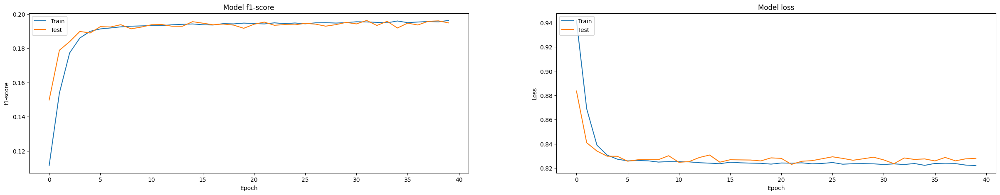

Pasta "Diference_Images_Linknet_vgg16" criada com sucesso!


 33%|███▎      | 1/3 [1:34:28<3:08:56, 5668.49s/it]

94592056/94592056 [==============================] - 1s 0us/step
Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 data (InputLayer)              [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 bn_data (BatchNormalization)   (None, None, None,   9           ['data[0][0]']                   
                                3)                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, None, None,   0          ['bn_data[0][0]']                
                           

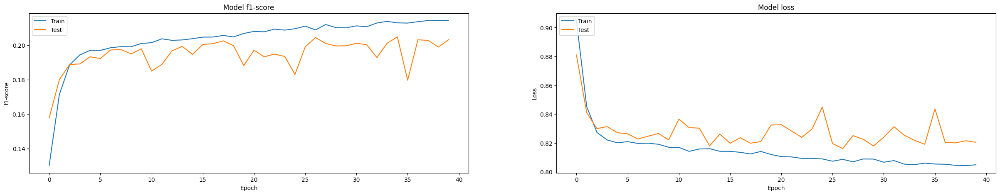

Pasta "Diference_Images_Linknet_resnet50" criada com sucesso!


 67%|██████▋   | 2/3 [2:58:05<1:28:05, 5285.52s/it]

234326024/234326024 [==============================] - 2s 0us/step
Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 data (InputLayer)              [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 bn_data (BatchNormalization)   (None, None, None,   9           ['data[0][0]']                   
                                3)                                                                
                                                                                                  
 zero_padding2d_18 (ZeroPadding  (None, None, None,   0          ['bn_data[0][0]']                
 2D)                     

 67%|██████▋   | 2/3 [2:58:44<1:29:22, 5362.22s/it]


ResourceExhaustedError: ignored

In [ ]:
#Experiments Linknet
list_backbones = ['vgg16','resnet50',
                  'resnet152']

for backbone in tqdm(list_backbones):
  #Parms
  name = 'Diference_Images_Linknet_' + backbone
  n_classes = 5
  LR_optim = 0.0001
  epochs = 40
  weights_loss = np.array([1, 1, 1, 1, 1])
  save_path = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/'
  #Model
  model = Linknet(backbone_name=backbone, classes=n_classes, activation='softmax', encoder_weights='imagenet')
  #Experiments
  train_experiment(name=name,
                  epochs=epochs,
                  weights_loss=weights_loss,
                  LR_optim=LR_optim,
                  model=model,
                  train_loader=train_loader,
                  valid_loader=valid_loader,
                  save_path=save_path)

# Train BDANet

In [ ]:
import numpy as np
from tensorflow.keras import Model
from tensorflow.keras.layers import Conv2D, Activation, UpSampling2D, Concatenate, Input
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.initializers import HeNormal
from tensorflow.keras import backend as K

class ConvRelu(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3):
        super(ConvRelu, self).__init__()
        self.layer = nn.Sequential(
            nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, padding=1),
            nn.ReLU(inplace=True, )
        )
    #@autocast()
    def forward(self, x):
        return self.layer(x)

In [ ]:
import numpy as np
import imgaug.augmenters as iaa
import albumentations as A

def random_crop_and_resize(image, mask, crop_size=(512, 512)):
    #mask = to_categorical(mask, 5)

    # escolher coordenadas aleatórias para o corte
    height, width = image.shape[:2]
    max_x = width - crop_size[1]
    max_y = height - crop_size[0]
    x1 = np.random.randint(0, max_x)
    y1 = np.random.randint(0, max_y)
    x2 = x1 + crop_size[1]
    y2 = y1 + crop_size[0]

    # aplicar corte na imagem e redimensioná-la
    image_transform = A.Compose([
        A.Crop(x_min=x1, y_min=y1, x_max=x2, y_max=y2),
        A.Resize(crop_size[0], crop_size[1])
    ])
    data = image_transform(image=image)
    cropped_image = data['image']

    # aplicar corte na máscara e redimensioná-la
    mask_transform = A.Compose([
        A.Crop(x_min=x1, y_min=y1, x_max=x2, y_max=y2),
        A.Resize(crop_size[0], crop_size[1])
    ])
    data = mask_transform(image=mask)
    cropped_mask = data['image']
    class_map = {0: 0, 1: 1, 2: 2, 3: 3, 4: 4}
    cropped_mask = np.argmax(cropped_mask, axis=-1)
    cropped_mask = np.vectorize(class_map.get)(cropped_mask)

    return cropped_image, cropped_mask

def preprocess_image_and_mask(image, mask):
    # escolher aleatoriamente um tamanho de corte entre (448, 448) e (736, 736)
    crop_size = np.random.randint(448, 737)

    # aplicar transformações de aumento de dados
    aug = iaa.Sequential([
        iaa.Fliplr(0.5),
        iaa.Flipud(0.5),
        iaa.Affine(rotate=(-10, 10)),
        iaa.Affine(scale=(0.8, 1.2)),
        iaa.SomeOf((0, 3), [
            iaa.CLAHE(),
            iaa.GaussianBlur(sigma=(0.0, 1.0)),
            iaa.AdditiveGaussianNoise(scale=(0.0, 0.05*255)),
        ]),
        iaa.SomeOf((0, 2), [
             iaa.Affine(scale=(0.5, 1.5), translate_px=(-20, 20)),
            iaa.ContrastNormalization((0.8, 1.2)),
            iaa.ElasticTransformation(alpha=50, sigma=5)
        ], random_order=True)
    ])

    # realizar o corte aleatório e redimensionar a imagem e a máscara
    #image, mask = random_crop_and_resize(image, mask, crop_size=[crop_size,crop_size])

    # aplicar transformações de aumento de dados na imagem
    image = aug.augment_image(image)

    # redimensionar a imagem para o tamanho original (1024, 1024) com as 4 test-time augmentations
    resize_transform = A.Compose([
        A.Resize(1024, 1024),
        A.HorizontalFlip(p=1.0),
        A.VerticalFlip(p=1.0),
        A.Rotate(limit=180, p=1.0)
    ])
    data = resize_transform(image=image, mask=mask)
    image = data['image']
    mask = data['mask']

    return image, mask

def cutmix(data, target, alpha):
    indices = torch.randperm(data.size(0))
    print(indices)
    shuffled_data = data[indices]
    shuffled_target = target[indices]

    lam = np.random.beta(alpha, alpha)
    image_h, image_w = data.shape[2:]
    cx = np.random.uniform(0, image_w)
    cy = np.random.uniform(0, image_h)
    w = image_w * np.sqrt(1 - lam)
    h = image_h * np.sqrt(1 - lam)
    x0 = int(np.round(max(cx - w / 2, 0)))
    x1 = int(np.round(min(cx + w / 2, image_w)))
    y0 = int(np.round(max(cy - h / 2, 0)))
    y1 = int(np.round(min(cy + h / 2, image_h)))

    data[:, :, y0:y1, x0:x1] = shuffled_data[:, :, y0:y1, x0:x1]
    target[:, y0:y1, x0:x1] = shuffled_target[:, y0:y1, x0:x1]

    return data, target

In [ ]:
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from typing import List, Optional


class ImageMaskDataset(Dataset):
    def __init__(
        self,
        pre_image_filenames: List[str],
        post_image_filenames: List[str],
        post_mask_filenames: Optional[List[str]],
        pre_processing: bool = False,
    ):
        assert len(pre_image_filenames) == len(post_image_filenames)

        self.pre_image_filenames = pre_image_filenames
        self.post_image_filenames = post_image_filenames
        self.post_mask_filenames = post_mask_filenames

        self.pre_processing = pre_processing

    def __getitem__(self, index):
      pre_image = read_image_rgb(self.pre_image_filenames[index]) # 1024x1024x3
      post_image = read_image_rgb(self.post_image_filenames[index]) # 1024x1024x3
      mask = read_mask(self.post_mask_filenames[index]) # 1024x1024

      image = np.dstack([pre_image, post_image]) # 1024x1024x6
      image = image.astype(np.uint8)

      if self.pre_processing is not False:
        image, mask = preprocess_image_and_mask(image,mask)

      # PyTorch usa canais primeiro, então vamos alterar as dimensões
      image = np.concatenate([pre_image.transpose(2, 0, 1), post_image.transpose(2, 0, 1)], axis=0) # 6x1024x1024

      #convert mask em tensor
      image = torch.from_numpy(image).float()
      mask = torch.from_numpy(mask).float()

      return image, mask

    def __len__(self):
        return len(self.pre_image_filenames)

# Dataloaders
batch_size = 10  # Defina aqui o tamanho do seu lote

# Supondo que você já definiu suas listas de caminhos de arquivos de imagem
train_dataset = ImageMaskDataset(train_img_pre,train_img_post,train_mask_post,pre_processing=False)
val_dataset = ImageMaskDataset(valid_img_pre,valid_img_post,valid_mask_post,pre_processing=False)
holdout_ds = ImageMaskDataset(holdout_img_pre, holdout_img_post,holdout_mask_post,pre_processing=False)
holdout_loader = DataLoader(holdout_ds, batch_size=batch_size, shuffle=False, num_workers=4)

dataloaders = {
    'train': DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4),
    'val': DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
}

# Tamanhos dos conjuntos de dados
dataset_sizes = {x: len(dataloaders[x].dataset) for x in ['train', 'val']}

In [ ]:
train_visualize = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)

In [ ]:
import time
import numpy as np
import matplotlib.pyplot as plt

def plot_cut_mix(inputs,labels):
  # Converta os tensores para numpy
  image = inputs.cpu().numpy()
  mask = labels.cpu().numpy()

  # Selecione os 3 primeiros canais e faça a transposição dos eixos para o formato (altura, largura, canais)
  image_pre = image[:3].transpose((1, 2, 0))
  image_post = image[3:].transpose((1, 2, 0))

  # Transponha os eixos da máscara para o formato (altura, largura)
  mask = mask.transpose((0, 1))

  # Crie uma figura com 3 subplots: um para a imagem e outro para a máscara
  fig, axs = plt.subplots(1, 3, figsize=(18, 6))

  # Mostre a imagem
  axs[0].imshow(image_pre.astype(int))
  axs[0].axis('off')
  #axs[0].set_title('Image Pre')

  # Mostre a imagem
  axs[1].imshow(image_post.astype(int))
  axs[1].axis('off')
  #axs[1].set_title('Image Post')

  # Mostre a máscara
  axs[2].imshow(overlay_damage_mask(image_post,mask), cmap='gray')
  axs[2].axis('off')
  #axs[2].set_title('Mask')

  # Exiba a figura
  plt.show()

def visualize_cut_mix(dataloaders, cutmix_prob=0.5):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    since = time.time()

    # Iterate over data.
    for inputs, labels in dataloaders:
        inputs = inputs.to(device)
        labels = labels.to(device).long()  # Convertendo labels para Long

        # CutMix is applied only during training
        inputs, labels = cutmix(inputs, labels, alpha=0.4)

        inputs_1 = inputs[0]
        labels_1 = labels[0]
        plot_cut_mix(inputs_1,labels_1)

        inputs_2 = inputs[1]
        labels_2 = labels[1]
        plot_cut_mix(inputs_2,labels_2)

        inputs_3 = inputs[2]
        labels_3 = labels[2]
        plot_cut_mix(inputs_3,labels_3)

        inputs_4 = inputs[3]
        labels_4 = labels[3]
        plot_cut_mix(inputs_4,labels_4)

        inputs_5 = inputs[4]
        labels_5 = labels[4]
        plot_cut_mix(inputs_5,labels_5)

        inputs_6 = inputs[5]
        labels_6 = labels[5]
        plot_cut_mix(inputs_6,labels_6)

        break

visualize_cut_mix(train_visualize)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
visualize_cut_mix(train_visualize)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
visualize_cut_mix(train_visualize)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
dataset_sizes

{'train': 2799, 'val': 906}

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

In [ ]:
"""
ResNet code gently borrowed from
https://github.com/pytorch/vision/blob/master/torchvision/models/resnet.py
"""

from collections import OrderedDict
import math

import torch
import torch.nn as nn
from torch.utils import model_zoo

__all__ = ['SENet', 'senet154', 'se_resnet50', 'se_resnet101', 'se_resnet152',
           'se_resnext50_32x4d', 'se_resnext101_32x4d']

pretrained_settings = {
    'senet154': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/senet154-c7b49a05.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnet50': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnet50-ce0d4300.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnet101': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnet101-7e38fcc6.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnet152': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnet152-d17c99b7.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnext50_32x4d': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnext50_32x4d-a260b3a4.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnext101_32x4d': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnext101_32x4d-3b2fe3d8.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
}


class SEModule(nn.Module):

    def __init__(self, channels, reduction, concat=False):
        super(SEModule, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc1 = nn.Conv2d(channels, channels // reduction, kernel_size=1,
                             padding=0)
        self.relu = nn.ReLU(inplace=True)
        self.fc2 = nn.Conv2d(channels // reduction, channels, kernel_size=1,
                             padding=0)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        module_input = x
        x = self.avg_pool(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.sigmoid(x)
        return module_input * x

class SCSEModule(nn.Module):
    # according to https://arxiv.org/pdf/1808.08127.pdf concat is better
    def __init__(self, channels, reduction=16, concat=False):
        super(SCSEModule, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc1 = nn.Conv2d(channels, channels // reduction, kernel_size=1,
                             padding=0)
        self.relu = nn.ReLU(inplace=True)
        self.fc2 = nn.Conv2d(channels // reduction, channels, kernel_size=1,
                             padding=0)
        self.sigmoid = nn.Sigmoid()

        self.spatial_se = nn.Sequential(nn.Conv2d(channels, 1, kernel_size=1,
                                                  stride=1, padding=0, bias=False),
                                        nn.Sigmoid())
        self.concat = concat

    def forward(self, x):
        module_input = x

        x = self.avg_pool(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        chn_se = self.sigmoid(x)
        chn_se = chn_se * module_input

        spa_se = self.spatial_se(module_input)
        spa_se = module_input * spa_se
        if self.concat:
            return torch.cat([chn_se, spa_se], dim=1)
        else:
            return chn_se + spa_se

class Bottleneck(nn.Module):
    """
    Base class for bottlenecks that implements `forward()` method.
    """
    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out = self.se_module(out) + residual
        out = self.relu(out)

        return out


class SEBottleneck(Bottleneck):
    """
    Bottleneck for SENet154.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None):
        super(SEBottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes * 2, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes * 2)
        self.conv2 = nn.Conv2d(planes * 2, planes * 4, kernel_size=3,
                               stride=stride, padding=1, groups=groups,
                               bias=False)
        self.bn2 = nn.BatchNorm2d(planes * 4)
        self.conv3 = nn.Conv2d(planes * 4, planes * 4, kernel_size=1,
                               bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SCSEBottleneck(Bottleneck):
    """
    Bottleneck for SENet154.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None):
        super(SCSEBottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes * 2, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes * 2)
        self.conv2 = nn.Conv2d(planes * 2, planes * 4, kernel_size=3,
                               stride=stride, padding=1, groups=groups,
                               bias=False)
        self.bn2 = nn.BatchNorm2d(planes * 4)
        self.conv3 = nn.Conv2d(planes * 4, planes * 4, kernel_size=1,
                               bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SCSEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SEResNetBottleneck(Bottleneck):
    """
    ResNet bottleneck with a Squeeze-and-Excitation module. It follows Caffe
    implementation and uses `stride=stride` in `conv1` and not in `conv2`
    (the latter is used in the torchvision implementation of ResNet).
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None):
        super(SEResNetBottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False,
                               stride=stride)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, padding=1,
                               groups=groups, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv3 = nn.Conv2d(planes, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SEResNeXtBottleneck(Bottleneck):
    """
    ResNeXt bottleneck type C with a Squeeze-and-Excitation module.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None, base_width=4):
        super(SEResNeXtBottleneck, self).__init__()
        width = math.floor(planes * (base_width / 64)) * groups
        self.conv1 = nn.Conv2d(inplanes, width, kernel_size=1, bias=False,
                               stride=1)
        self.bn1 = nn.BatchNorm2d(width)
        self.conv2 = nn.Conv2d(width, width, kernel_size=3, stride=stride,
                               padding=1, groups=groups, bias=False)
        self.bn2 = nn.BatchNorm2d(width)
        self.conv3 = nn.Conv2d(width, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride



class SCSEResNeXtBottleneck(Bottleneck):
    """
    ResNeXt bottleneck type C with a Concurrent Spatial Squeeze-and-Excitation module.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None, base_width=4, final=False):
        super(SCSEResNeXtBottleneck, self).__init__()
        width = math.floor(planes * (base_width / 64)) * groups
        self.conv1 = nn.Conv2d(inplanes, width, kernel_size=1, bias=False,
                               stride=1)
        self.bn1 = nn.BatchNorm2d(width)
        self.conv2 = nn.Conv2d(width, width, kernel_size=3, stride=stride,
                               padding=1, groups=groups, bias=False)
        self.bn2 = nn.BatchNorm2d(width)
        self.conv3 = nn.Conv2d(width, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SCSEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SENet(nn.Module):

    def __init__(self, block, layers, groups, reduction, dropout_p=0.2,
                 inplanes=128, input_3x3=True, downsample_kernel_size=3,
                 downsample_padding=1, num_classes=1000):
        """
        Parameters
        ----------
        block (nn.Module): Bottleneck class.
            - For SENet154: SEBottleneck
            - For SE-ResNet models: SEResNetBottleneck
            - For SE-ResNeXt models:  SEResNeXtBottleneck
        layers (list of ints): Number of residual blocks for 4 layers of the
            network (layer1...layer4).
        groups (int): Number of groups for the 3x3 convolution in each
            bottleneck block.
            - For SENet154: 64
            - For SE-ResNet models: 1
            - For SE-ResNeXt models:  32
        reduction (int): Reduction ratio for Squeeze-and-Excitation modules.
            - For all models: 16
        dropout_p (float or None): Drop probability for the Dropout layer.
            If `None` the Dropout layer is not used.
            - For SENet154: 0.2
            - For SE-ResNet models: None
            - For SE-ResNeXt models: None
        inplanes (int):  Number of input channels for layer1.
            - For SENet154: 128
            - For SE-ResNet models: 64
            - For SE-ResNeXt models: 64
        input_3x3 (bool): If `True`, use three 3x3 convolutions instead of
            a single 7x7 convolution in layer0.
            - For SENet154: True
            - For SE-ResNet models: False
            - For SE-ResNeXt models: False
        downsample_kernel_size (int): Kernel size for downsampling convolutions
            in layer2, layer3 and layer4.
            - For SENet154: 3
            - For SE-ResNet models: 1
            - For SE-ResNeXt models: 1
        downsample_padding (int): Padding for downsampling convolutions in
            layer2, layer3 and layer4.
            - For SENet154: 1
            - For SE-ResNet models: 0
            - For SE-ResNeXt models: 0
        num_classes (int): Number of outputs in `last_linear` layer.
            - For all models: 1000
        """
        super(SENet, self).__init__()
        self.inplanes = inplanes
        if input_3x3:
            layer0_modules = [
                ('conv1', nn.Conv2d(3, 64, 3, stride=2, padding=1,
                                    bias=False)),
                ('bn1', nn.BatchNorm2d(64)),
                ('relu1', nn.ReLU(inplace=True)),
                ('conv2', nn.Conv2d(64, 64, 3, stride=1, padding=1,
                                    bias=False)),
                ('bn2', nn.BatchNorm2d(64)),
                ('relu2', nn.ReLU(inplace=True)),
                ('conv3', nn.Conv2d(64, inplanes, 3, stride=1, padding=1,
                                    bias=False)),
                ('bn3', nn.BatchNorm2d(inplanes)),
                ('relu3', nn.ReLU(inplace=True)),
            ]
        else:
            layer0_modules = [
                ('conv1', nn.Conv2d(3, inplanes, kernel_size=7, stride=2,
                                    padding=3, bias=False)),
                ('bn1', nn.BatchNorm2d(inplanes)),
                ('relu1', nn.ReLU(inplace=True)),
            ]
        # To preserve compatibility with Caffe weights `ceil_mode=True`
        # is used instead of `padding=1`.
        self.pool = nn.MaxPool2d(3, stride=2, ceil_mode=True)
        self.layer0 = nn.Sequential(OrderedDict(layer0_modules))
        self.layer1 = self._make_layer(
            block,
            planes=64,
            blocks=layers[0],
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=1,
            downsample_padding=0
        )
        self.layer2 = self._make_layer(
            block,
            planes=128,
            blocks=layers[1],
            stride=2,
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=downsample_kernel_size,
            downsample_padding=downsample_padding
        )
        self.layer3 = self._make_layer(
            block,
            planes=256,
            blocks=layers[2],
            stride=2,
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=downsample_kernel_size,
            downsample_padding=downsample_padding
        )
        self.layer4 = self._make_layer(
            block,
            planes=512,
            blocks=layers[3],
            stride=2,
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=downsample_kernel_size,
            downsample_padding=downsample_padding
        )
        self.avg_pool = nn.AvgPool2d(7, stride=1)
        self.dropout = nn.Dropout(dropout_p) if dropout_p is not None else None
        self.last_linear = nn.Linear(512 * block.expansion, num_classes)
        self._initialize_weights()

    def _make_layer(self, block, planes, blocks, groups, reduction, stride=1,
                    downsample_kernel_size=1, downsample_padding=0):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=downsample_kernel_size, stride=stride,
                          padding=downsample_padding, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = []
        layers.append(block(self.inplanes, planes, groups, reduction, stride,
                            downsample))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes, groups, reduction))

        return nn.Sequential(*layers)

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
                m.weight.data = nn.init.kaiming_normal_(m.weight.data)
                if m.bias is not None:
                    m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def features(self, x):
        x = self.layer0(x)
        x = self.pool(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        return x

    def logits(self, x):
        x = self.avg_pool(x)
        if self.dropout is not None:
            x = self.dropout(x)
        x = x.view(x.size(0), -1)
        x = self.last_linear(x)
        return x

    def forward(self, x):
        x = self.features(x)
        x = self.logits(x)
        return x


def initialize_pretrained_model(model, num_classes, settings):
    assert num_classes == settings['num_classes'], \
        'num_classes should be {}, but is {}'.format(
            settings['num_classes'], num_classes)
    model.load_state_dict(model_zoo.load_url(settings['url']), strict=False)
    model.input_space = settings['input_space']
    model.input_size = settings['input_size']
    model.input_range = settings['input_range']
    model.mean = settings['mean']
    model.std = settings['std']


def senet154(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEBottleneck, [3, 8, 36, 3], groups=64, reduction=16,
                  dropout_p=0.2, num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['senet154'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model

def scsenet154(num_classes=1000, pretrained='imagenet'):
    print("scsenet154")
    model = SENet(SCSEBottleneck, [3, 8, 36, 3], groups=64, reduction=16,
                  dropout_p=0.2, num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['senet154'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnet50(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNetBottleneck, [3, 4, 6, 3], groups=1, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnet50'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnet101(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNetBottleneck, [3, 4, 23, 3], groups=1, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnet101'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnet152(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNetBottleneck, [3, 8, 36, 3], groups=1, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnet152'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnext50_32x4d(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNeXtBottleneck, [3, 4, 6, 3], groups=32, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnext50_32x4d'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def scse_resnext50_32x4d(num_classes=1000, pretrained='imagenet'):
    model = SENet(SCSEResNeXtBottleneck, [3, 4, 6, 3], groups=32, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnext50_32x4d'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnext101_32x4d(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNeXtBottleneck, [3, 4, 23, 3], groups=32, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnext101_32x4d'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model

In [ ]:
class SeResNext50_Unet_2Ssum(nn.Module):
    def __init__(self, pretrained='imagenet', **kwargs):
        super(SeResNext50_Unet_2Ssum, self).__init__()

        encoder_filters = [64, 256, 512, 1024, 2048]
        decoder_filters = np.asarray([64, 96, 128, 256, 512]) // 2

        self.conv6 = ConvRelu(encoder_filters[-1], decoder_filters[-1])
        self.conv6_2 = ConvRelu(decoder_filters[-1] + encoder_filters[-2], decoder_filters[-1])
        self.conv7 = ConvRelu(decoder_filters[-1], decoder_filters[-2])
        self.conv7_2 = ConvRelu(decoder_filters[-2] + encoder_filters[-3] , decoder_filters[-2] )
        self.conv8 = ConvRelu(decoder_filters[-2], decoder_filters[-3])
        self.conv8_2 = ConvRelu(decoder_filters[-3] + encoder_filters[-4] , decoder_filters[-3])
        self.conv9 = ConvRelu(decoder_filters[-3], decoder_filters[-4])
        self.conv9_2 = ConvRelu(decoder_filters[-4] + encoder_filters[-5], decoder_filters[-4])

        # self.convx9_3 = ConvRelu(encoder_filters[-4], encoder_filters[-4])


        self.conv10 = ConvRelu(decoder_filters[-4], decoder_filters[-5])
        self.conv10_s = nn.Sequential(ConvRelu(decoder_filters[-5], decoder_filters[-5]),
                                      nn.Conv2d(decoder_filters[-5] , 1, 1, stride=1, padding=0),
                                      nn.Sigmoid())
        # self.convxx = nn.Sequential(ConvRelu(decoder_filters[-5]*2, decoder_filters[-5]*2),
        #                             nn.Conv2d(decoder_filters[-5] * 2, decoder_filters[-5], 1, stride=1, padding=0))

        self.res = nn.Conv2d(decoder_filters[-5] * 2, 5, 1, stride=1, padding=0)

        self._initialize_weights()

        encoder = se_resnext50_32x4d(pretrained=pretrained)
        #encoder = torchvision.models.resnet50(pretrained=pretrained)
        self.conv1 = nn.Sequential(encoder.layer0.conv1, encoder.layer0.bn1, encoder.layer0.relu1) #encoder.layer0.conv1
        self.conv2 = nn.Sequential(encoder.pool, encoder.layer1)
        self.conv3 = encoder.layer2
        self.conv4 = encoder.layer3
        self.conv5 = encoder.layer4


    def forward1(self, x):
        batch_size, C, H, W = x.shape
        xx = F.interpolate(x, scale_factor=0.5, mode='bilinear', align_corners=False)

        enc1 = self.conv1(x)
        enc2 = self.conv2(enc1)
        enc3 = self.conv3(enc2)
        enc4 = self.conv4(enc3)
        enc5 = self.conv5(enc4)

        encx1 = self.conv1(xx)   # 64 128 128
        encx2 = self.conv2(encx1) # 64
        encx3 = self.conv3(encx2) # 32
        encx4 = self.conv4(encx3) # 16
        encx5 = self.conv5(encx4) # 8

        dec6 = self.conv6(F.interpolate(enc5, scale_factor=2))
        dec6 = self.conv6_2(torch.cat([dec6, enc4 ], 1))
        dec7 = self.conv7(F.interpolate(dec6, scale_factor=2))
        dec7 = self.conv7_2(torch.cat([dec7, enc3], 1))
        dec8 = self.conv8(F.interpolate(dec7, scale_factor=2))
        dec8 = self.conv8_2(torch.cat([dec8, enc2], 1))
        dec9 = self.conv9(F.interpolate(dec8, scale_factor=2))
        dec9 = self.conv9_2(torch.cat([dec9,  enc1], 1))   #256

        decx6 = self.conv6(F.interpolate(encx5, scale_factor=2))
        decx6 = self.conv6_2(torch.cat([decx6, encx4 ], 1))
        decx7 = self.conv7(F.interpolate(decx6, scale_factor=2))
        decx7 = self.conv7_2(torch.cat([decx7, encx3], 1))
        decx8 = self.conv8(F.interpolate(decx7, scale_factor=2))
        decx8 = self.conv8_2(torch.cat([decx8, encx2], 1))
        decx9 = self.conv9(F.interpolate(decx8, scale_factor=2))
        decx9 = self.conv9_2(torch.cat([decx9,  encx1], 1))   #128
        #decx9 = self.convx9_3(F.interpolate(decx9, scale_factor=4))


        dec10 = self.conv10(F.interpolate(dec9, scale_factor=2))
        alpha = self.conv10_s(dec10)
        decx10 = self.conv10(F.interpolate(decx9, scale_factor=4))

        dec = alpha * dec10 + (1-alpha)*decx10

        return dec

    def forward(self, x):
        dec10_0 = self.forward1(x[:, :3, :, :])
        dec10_1 = self.forward1(x[:, 3:, :, :])

        dec10 = torch.cat([dec10_0, dec10_1], 1)

        return self.res(dec10)


    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Linear):
                m.weight.data = nn.init.kaiming_normal_(m.weight.data)
                if m.bias is not None:
                    m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

In [ ]:
import ssl
ssl._create_default_https_context = ssl._create_unverified_context

In [ ]:
model = SeResNext50_Unet_2Ssum(pretrained='imagenet')

Downloading: "http://data.lip6.fr/cadene/pretrainedmodels/se_resnext50_32x4d-a260b3a4.pth" to /root/.cache/torch/hub/checkpoints/se_resnext50_32x4d-a260b3a4.pth
100%|██████████| 105M/105M [05:10<00:00, 356kB/s]


In [ ]:
print(model)

SeResNext50_Unet_2Ssum(
  (conv6): ConvRelu(
    (layer): Sequential(
      (0): Conv2d(2048, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
  )
  (conv6_2): ConvRelu(
    (layer): Sequential(
      (0): Conv2d(1280, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
  )
  (conv7): ConvRelu(
    (layer): Sequential(
      (0): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
  )
  (conv7_2): ConvRelu(
    (layer): Sequential(
      (0): Conv2d(640, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
  )
  (conv8): ConvRelu(
    (layer): Sequential(
      (0): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
  )
  (conv8_2): ConvRelu(
    (layer): Sequential(
      (0): Conv2d(320, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inpl

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

In [ ]:
criterion = nn.CrossEntropyLoss()  # Função de perda
optimizer = torch.optim.Adam(model.parameters())  # Otimizador

In [ ]:
def f1_score(y_true, y_pred, classes=[0., 1., 2., 3., 4.], is_training=False):
    epsilon = 1e-7
    f1_total = 0

    for cls in classes:
        true_cls = (y_true == cls).to(torch.float32)
        pred_cls = (y_pred == cls).to(torch.float32)

        tp = (true_cls * pred_cls).sum()
        tn = ((1 - true_cls) * (1 - pred_cls)).sum()
        fp = ((1 - true_cls) * pred_cls).sum()
        fn = (true_cls * (1 - pred_cls)).sum()

        precision = tp / (tp + fp + epsilon)
        recall = tp / (tp + fn + epsilon)

        f1 = 2 * (precision * recall) / (precision + recall + epsilon)
        f1.requires_grad = is_training
        f1_total += f1

    return f1_total / len(classes)

def f1_score(y_true, y_pred, is_training=False):
    assert y_true.ndim == 1 and y_pred.ndim == 1

    tp = (y_true * y_pred).sum().to(torch.float32)
    tn = ((1 - y_true) * (1 - y_pred)).sum().to(torch.float32)
    fp = ((1 - y_true) * y_pred).sum().to(torch.float32)
    fn = (y_true * (1 - y_pred)).sum().to(torch.float32)

    epsilon = 1e-7

    precision = tp / (tp + fp + epsilon)
    recall = tp / (tp + fn + epsilon)

    f1 = 2* (precision*recall) / (precision + recall + epsilon)
    f1.requires_grad = is_training
    return f1

In [ ]:
import time

def train_model(model, dataloaders, criterion, optimizer, num_epochs=10):
    since = time.time()

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_f1 = 0.0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device).long()  # Convertendo labels para Long

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)
                    f1 = f1_score(labels.view(-1), preds.view(-1), is_training=phase=='train')

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_f1 += f1.item() * inputs.size(0)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_f1 = running_f1 / dataset_sizes[phase]

            print('{} Loss: {:.4f} F1: {:.4f}'.format(
                phase, epoch_loss, epoch_f1))

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))

    return model

In [ ]:
import time
import numpy as np

def train_model(model, dataloaders, criterion, optimizer, num_epochs=10, cutmix_prob=0.5):
    since = time.time()

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_f1 = 0.0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device).long()  # Convertendo labels para Long

                # CutMix is applied only during training
                if phase == 'train' and np.random.rand() < cutmix_prob:
                    inputs, labels = cutmix(inputs, labels, alpha=0.4)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)
                    f1 = f1_score(labels.view(-1), preds.view(-1), is_training=phase=='train')

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_f1 += f1.item() * inputs.size(0)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_f1 = running_f1 / dataset_sizes[phase]

            print('{} Loss: {:.4f} F1: {:.4f}'.format(
                phase, epoch_loss, epoch_f1))

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))

    return model

In [ ]:
from torch.optim import lr_scheduler
exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

# Iniciando o treinamento
model = train_model(model, dataloaders, criterion, optimizer)

Epoch 0/9
----------
tensor([0, 2, 1])
tensor([2, 0, 1])
tensor([2, 0, 1])
tensor([2, 1, 0])
tensor([1, 2, 0])
tensor([1, 0, 2])
tensor([2, 1, 0])
tensor([2, 1, 0])
tensor([2, 1, 0])
tensor([0, 2, 1])
tensor([1, 2, 0])
tensor([0, 1, 2])
tensor([1, 0, 2])
tensor([2, 0, 1])
tensor([0, 1, 2])
tensor([0, 2, 1])
tensor([0, 1, 2])
tensor([0, 2, 1])
tensor([1, 2, 0])
tensor([2, 1, 0])
tensor([2, 1, 0])
tensor([2, 0, 1])
tensor([0, 1, 2])
tensor([1, 2, 0])
tensor([0, 1, 2])
tensor([2, 0, 1])
tensor([0, 1, 2])
tensor([1, 0, 2])
tensor([0, 2, 1])
tensor([0, 1, 2])
tensor([0, 2, 1])
tensor([0, 1, 2])
tensor([2, 1, 0])
tensor([0, 1, 2])
tensor([2, 1, 0])
tensor([0, 2, 1])
tensor([1, 2, 0])
tensor([2, 0, 1])
tensor([0, 1, 2])
tensor([0, 1, 2])
tensor([2, 1, 0])
tensor([1, 0, 2])
tensor([0, 2, 1])
tensor([1, 0, 2])
tensor([0, 1, 2])
tensor([1, 2, 0])
tensor([1, 0, 2])
tensor([0, 2, 1])
tensor([0, 2, 1])
tensor([0, 2, 1])
tensor([1, 2, 0])
tensor([2, 1, 0])
tensor([1, 2, 0])
tensor([1, 0, 2])
tensor(

In [ ]:
#torch.save(model, '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/modelBDA.pth')
#torch.save(model, '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/modelBDA_1.pth')
torch.save(model, '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/modelBDA_2.pth')

# Visualizing predictions and evaluate

Let's take a look what predictions our model can make at this point. We use holdout dataset here to ensure we're not overfitting to the validation set.

In [ ]:
def show_predictions(image_pre,image_post, gt_mask, pred_mask):
    print(image_pre.shape,image_post.shape, gt_mask.shape, pred_mask.shape)
    f, ax = plt.subplots(2, 3, figsize=(30,10))

    gt_overlay = overlay_damage_mask(image_post, gt_mask)
    pred_overlay = overlay_damage_mask(image_post, pred_mask)

    ax[0][0].imshow(image_pre)
    ax[0][0].axis('off')

    ax[0][1].imshow(gt_overlay)
    ax[0][1].axis('off')

    ax[0][2].imshow(pred_overlay)
    ax[0][2].axis('off')

    ax[1][0].imshow(image_post)
    ax[1][0].axis('off')

    ax[1][1].imshow(gt_mask)
    ax[1][1].axis('off')

    ax[1][2].imshow(pred_mask)
    ax[1][2].axis('off')

    f.tight_layout()
    f.show()

In [ ]:
def visualize_predict(modelo,font_imagem,font_mascara):
  imagem_de_consulta = font_imagem.astype(np.int)
  imagem_expandida = np.expand_dims(imagem_de_consulta, axis=0)
  mascara = font_mascara
  mascara_predita = modelo.predict(imagem_expandida)
  mascara_predita_agregada = np.argmax(mascara_predita, axis=-1)[0,:,:]
  mascara_predita_int = mascara_predita_agregada.astype(np.float32)

  print(imagem_de_consulta.shape)
  print(imagem_expandida.shape)
  print(mascara.shape)
  print(mascara_predita.shape)
  print(mascara_predita_agregada.shape)
  print(mascara_predita_int.shape)

  show_predictions(imagem_de_consulta[:,:,:3],imagem_de_consulta[:,:,3:],mascara,mascara_predita_int)

In [ ]:
from sklearn.metrics import precision_recall_fscore_support
import numpy as np

def metrics_dataset(modelo,dataset):
  # Define as classes e inicializa os acumuladores
  classes = [0., 1., 2., 3., 4.]
  precisions = {c: [] for c in classes}
  recalls = {c: [] for c in classes}
  f1_scores = {c: [] for c in classes}
  y_true = [[] for i in range(len(holdout_ds))]
  y_pred = [[] for i in range(len(holdout_ds))]

  # Itera sobre os dados no loader
  for images, labels in dataset:
      # Itera sobre cada imagem no batch
      for i, image in enumerate(images):
          # Faça a predição para a imagem atual
          imagem_expandida = np.expand_dims(image, axis=0)
          preds = modelo(imagem_expandida)
          preds = preds.cpu().numpy()
          preds = np.argmax(preds, axis=-1)[0,:,:]
          preds = preds.astype(np.float32)

          # Acumula os rótulos verdadeiros e preditos para a imagem atual
          y_true[i] += labels[i].ravel().tolist()
          y_pred[i] += preds.ravel().tolist()

          # Calcula as métricas de precisão, recall e F1-score por classe para a imagem atual
          p, r, f1, _ = precision_recall_fscore_support(labels[i].ravel(), preds.ravel(), labels=classes, average=None)
          for j, c in enumerate(classes):
              precisions[c].append(p[j])
              recalls[c].append(r[j])
              f1_scores[c].append(f1[j])

  # Calcula a média das métricas por classe
  for c in classes:
      precision_mean = np.mean(precisions[c])
      recall_mean = np.mean(recalls[c])
      f1_mean = np.mean(f1_scores[c])
      print(f"Classe {c}: Precisão = {precision_mean:.4f}, Recall = {recall_mean:.4f}, F1-score = {f1_mean:.4f}")

  # Calcula a média das métricas para todas as classes
  precision_macro = np.mean(list(precisions.values()))
  recall_macro = np.mean(list(recalls.values()))
  f1_macro = np.mean(list(f1_scores.values()))
  print(f"Média macro: Precisão = {precision_macro:.4f}, Recall = {recall_macro:.4f}, F1-score = {f1_macro:.4f}")

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

def visualize_predict_pytorch(model, input_image, mask_path,device):
    model = model.eval()  # Set the model to evaluation mode

    with torch.no_grad():
        output = model(input_image)  # Make sure to pass input_image here
        predicted_mask = torch.argmax(output, dim=1)  # Get the predicted class

    # Convert to numpy arrays for visualization
    input_image_np = input_image.squeeze().to(device).numpy()
    predicted_mask_np = predicted_mask.squeeze().to(device).numpy()
    mask_np = mask_path.numpy().to(device)
    print(predicted_mask_np)

    # Use your visualization function
    show_predictions(input_image_np[:3, :, :], input_image_np[3:, :, :], mask_np, predicted_mask_np)

def show_predictions_pytorch(image, gt_mask, pred_mask):
    f, ax = plt.subplots(2, 2, figsize=(30,10))

    gt_overlay = overlay_damage_mask(image, gt_mask)
    pred_overlay = overlay_damage_mask(image, pred_mask)

    ax[0][0].imshow(image)
    ax[0][0].axis('off')

    ax[0][1].imshow(gt_overlay)
    ax[0][1].axis('off')

    ax[1][0].imshow(pred_overlay)
    ax[1][0].axis('off')

    ax[1][1].imshow(pred_mask)
    ax[1][1].axis('off')

    f.tight_layout()
    plt.show()

from sklearn.metrics import precision_recall_fscore_support
import numpy as np

def metrics_dataset_pytorch(modelo,dataset):
  # Define as classes e inicializa os acumuladores
  classes = [0., 1., 2., 3., 4.]
  precisions = {c: [] for c in classes}
  recalls = {c: [] for c in classes}
  f1_scores = {c: [] for c in classes}
  y_true = [[] for i in range(len(holdout_ds))]
  y_pred = [[] for i in range(len(holdout_ds))]

  # Itera sobre os dados no loader
  for images, labels in dataset:
      # Itera sobre cada imagem no batch
      for i, image in enumerate(images):
          # Faça a predição para a imagem atual
          imagem_expandida = np.expand_dims(image, axis=0)
          imagem_expandida = torch.from_numpy(imagem_expandida).to(device).float()
          preds = modelo(imagem_expandida)
          preds = preds.cpu().detach().numpy()
          preds = np.argmax(preds, axis=-1)[0,:,:]
          preds = preds.astype(np.float32)

          # Acumula os rótulos verdadeiros e preditos para a imagem atual
          y_true[i] += labels[i].ravel().tolist()
          y_pred[i] += preds.ravel().tolist()

          # Calcula as métricas de precisão, recall e F1-score por classe para a imagem atual
          p, r, f1, _ = precision_recall_fscore_support(labels[i].ravel(), preds.ravel(), labels=classes, average=None)
          for j, c in enumerate(classes):
              precisions[c].append(p[j])
              recalls[c].append(r[j])
              f1_scores[c].append(f1[j])

  # Calcula a média das métricas por classe
  for c in classes:
      precision_mean = np.mean(precisions[c])
      recall_mean = np.mean(recalls[c])
      f1_mean = np.mean(f1_scores[c])
      print(f"Classe {c}: Precisão = {precision_mean:.4f}, Recall = {recall_mean:.4f}, F1-score = {f1_mean:.4f}")

  # Calcula a média das métricas para todas as classes
  precision_macro = np.mean(list(precisions.values()))
  recall_macro = np.mean(list(recalls.values()))
  f1_macro = np.mean(list(f1_scores.values()))
  print(f"Média macro: Precisão = {precision_macro:.4f}, Recall = {recall_macro:.4f}, F1-score = {f1_macro:.4f}")

## Linknet_vgg16Linknet_vgg16

In [ ]:
model_path = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/Linknet_vgg16Linknet_vgg16.hdf5'

In [ ]:
import tensorflow as tf

dice_loss = sm.losses.DiceLoss(class_weights=weights_loss)
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)
optim = AdamW(weight_decay=1e-6, learning_rate=0.0001)
metrics = [sm.metrics.FScore()]

# carregando o modelo salvo
modelo = tf.keras.models.load_model(model_path, custom_objects={'dice_loss_plus_1focal_loss': total_loss,
                                                                'f1-score': metrics})

In [ ]:
modelo.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 1024, 1024, 6)]   0         
                                                                 
 conv2d_3 (Conv2D)           (None, 1024, 1024, 3)     21        
                                                                 
 model_2 (Functional)        (None, None, None, 5)     20325717  
                                                                 
Total params: 20,325,738
Trainable params: 20,318,922
Non-trainable params: 6,816
_________________________________________________________________


In [ ]:
metrics_dataset(modelo,holdout_loader)

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this beh

Classe 0.0: Precisão = 0.9662, Recall = 0.9819, F1-score = 0.9735
Classe 1.0: Precisão = 0.2308, Recall = 0.1182, F1-score = 0.1442
Classe 2.0: Precisão = 0.1654, Recall = 0.2476, F1-score = 0.1877
Classe 3.0: Precisão = 0.1451, Recall = 0.0484, F1-score = 0.0668
Classe 4.0: Precisão = 0.1706, Recall = 0.2399, F1-score = 0.1837
Média macro: Precisão = 0.3356, Recall = 0.3272, F1-score = 0.3112


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



1/1 [==============================] - 0s 47ms/step


<ipython-input-232-02fa19bb4794>:4: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



(1024, 1024, 6)
(1, 1024, 1024, 6)
(1024, 1024)
(1, 1024, 1024, 5)
(1024, 1024)
(1024, 1024)


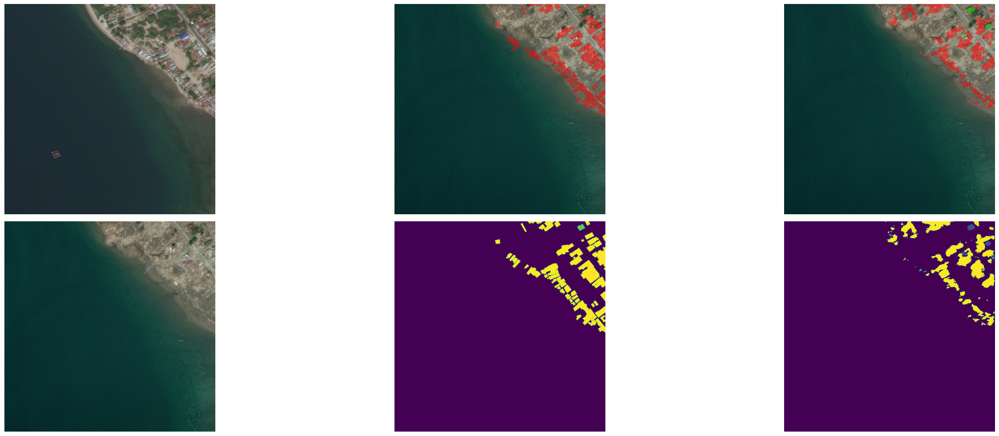

In [ ]:
font_imagem = holdout_loader[2][0][2]
font_mascara = holdout_loader[2][1][2]

imagem_de_consulta = font_imagem.astype(np.int)
imagem_expandida = np.expand_dims(imagem_de_consulta, axis=0)
mascara = font_mascara
mascara_predita = modelo.predict(imagem_expandida)
mascara_predita_agregada = np.argmax(mascara_predita, axis=-1)[0,:,:]
mascara_predita_int = mascara_predita_agregada.astype(np.float32)

print(imagem_de_consulta.shape)
print(imagem_expandida.shape)
print(mascara.shape)
print(mascara_predita.shape)
print(mascara_predita_agregada.shape)
print(mascara_predita_int.shape)

show_predictions(imagem_de_consulta[:,:,:3],imagem_de_consulta[:,:,3:],mascara,mascara_predita_int)

In [ ]:
font_imagem = holdout_loader[2][0][0]
font_mascara = holdout_loader[2][1][0]

visualize_predict(modelo, font_imagem, font_mascara)

Output hidden; open in https://colab.research.google.com to view.

1/1 [==============================] - 0s 46ms/step


<ipython-input-235-d0109265d17a>:2: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



(1024, 1024, 6)
(1, 1024, 1024, 6)
(1024, 1024)
(1, 1024, 1024, 5)
(1024, 1024)
(1024, 1024)


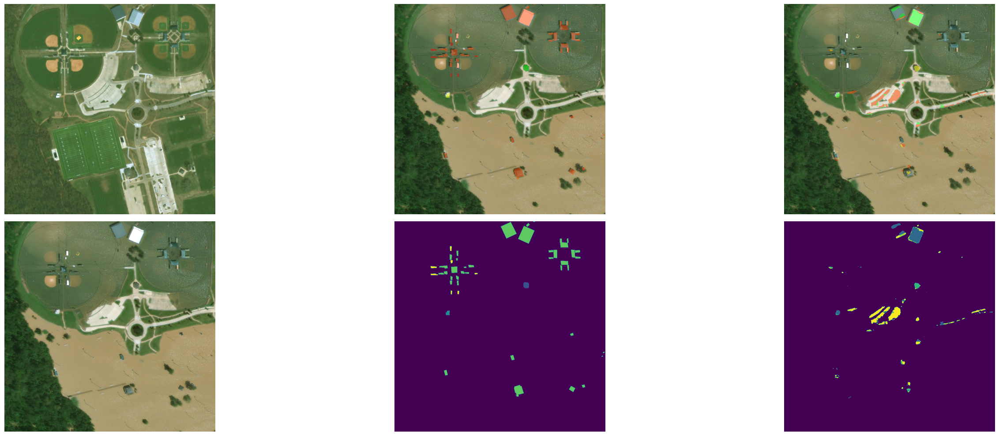

In [ ]:
font_imagem = holdout_loader[0][0][1]
font_mascara = holdout_loader[0][1][1]

visualize_predict(modelo, font_imagem, font_mascara)

In [ ]:
font_imagem = holdout_loader[0][0][2]
font_mascara = holdout_loader[0][1][2]

visualize_predict(modelo, font_imagem, font_mascara)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
font_imagem = holdout_loader[1][0][2]
font_mascara = holdout_loader[1][1][2]

visualize_predict(modelo, font_imagem, font_mascara)

Output hidden; open in https://colab.research.google.com to view.

## BDAnet

In [ ]:
model = torch.load('/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/modelBDA.pth')

In [ ]:
def visualize_predict_pytorch(model, input_image, mask_path, device):
    input_image = input_image.unsqueeze(0)  # Add batch dimension

    with torch.no_grad():
        output = model(input_image.to(device))  # Make sure to pass input_image here
        predicted_mask = torch.argmax(output, dim=1)  # Get the predicted class

    # Convert to numpy arrays for visualization
    input_image_np = input_image.squeeze().cpu().numpy()
    predicted_mask_np = predicted_mask.squeeze().cpu().numpy()
    mask_np = mask_path.cpu().numpy()

    # Separate pre and post disaster images
    pre_disaster_image = input_image_np[:3,:,:]
    post_disaster_image = input_image_np[3:,:,:]

    pre_disaster_image = (pre_disaster_image - pre_disaster_image.min()) / (pre_disaster_image.max() - pre_disaster_image.min())
    post_disaster_image = (post_disaster_image - post_disaster_image.min()) / (post_disaster_image.max() - post_disaster_image.min())

    pre_disaster_image = np.transpose(pre_disaster_image, (1, 2, 0))
    post_disaster_image = np.transpose(post_disaster_image, (1, 2, 0))

    # Visualization
    show_predictions(pre_disaster_image,post_disaster_image, mask_np, predicted_mask_np)

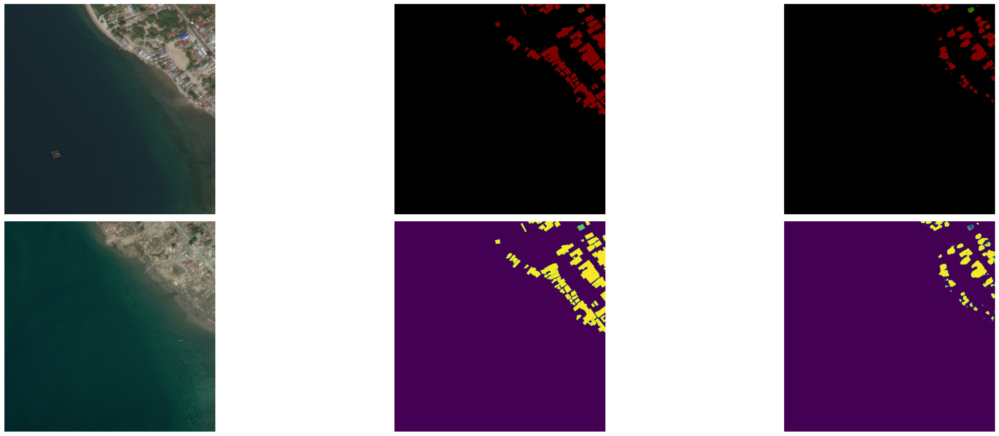

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

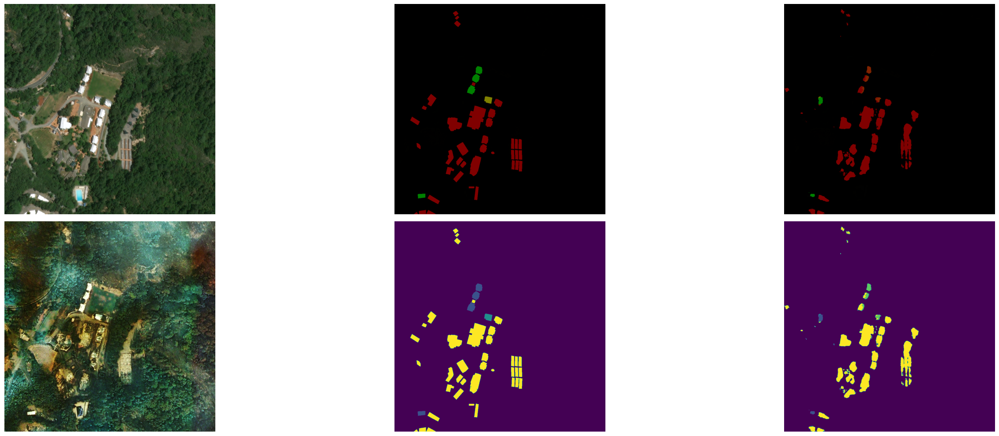

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[0].to(device)
font_mascara = first_batch_masks[0].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

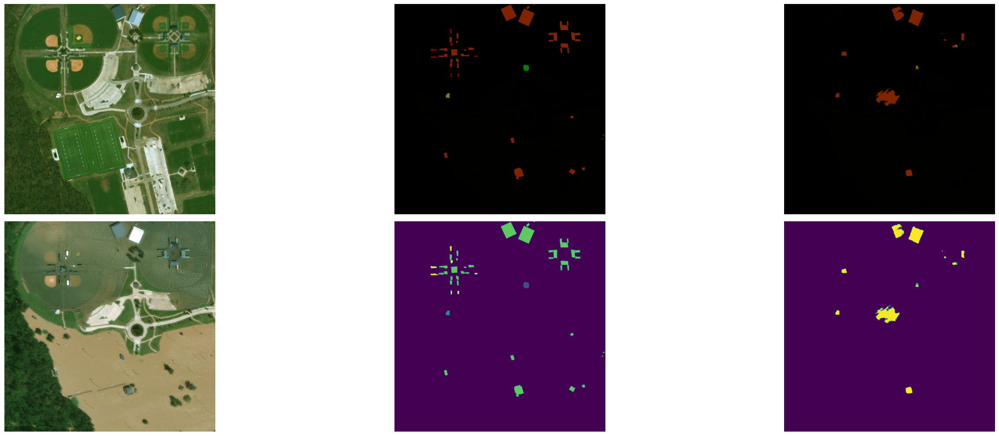

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[1].to(device)
font_mascara = first_batch_masks[1].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

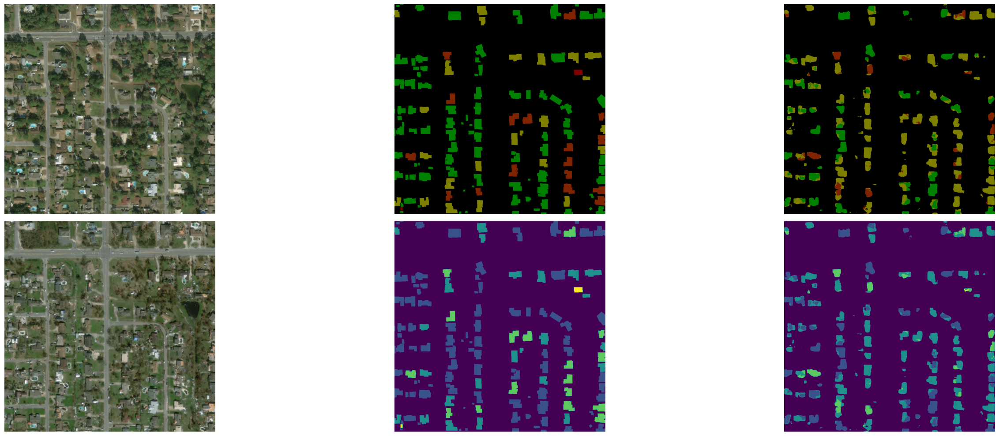

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

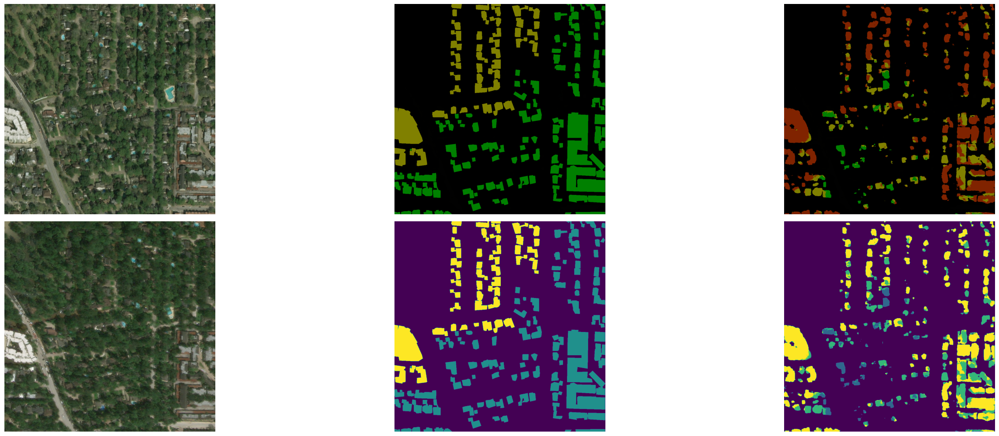

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

In [ ]:
def metrics_dataset_pytorch(modelo, dataset):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    classes = np.array([0, 1, 2, 3, 4])
    precisions = {c: [] for c in classes}
    recalls = {c: [] for c in classes}
    f1s = {c: [] for c in classes}

    # Itera sobre o dataset
    for i, (image, labels) in enumerate(dataset):
        image = image.to(device)
        labels = labels.to(device)

        # Faça a predição para a imagem atual
        preds = modelo(image)
        preds = torch.argmax(preds, dim=1).cpu().numpy()

        # Calcula as métricas de precisão, recall e F1-score por classe para a imagem atual
        p, r, f1, _ = precision_recall_fscore_support(labels.cpu().numpy().ravel(), preds.ravel(), labels=classes, average=None)
        for j, c in enumerate(classes):
            precisions[c].append(p[j])
            recalls[c].append(r[j])
            f1s[c].append(f1[j])

    # Calcula as médias das métricas por classe
    avg_precisions = {c: np.mean(precisions[c]) for c in classes}
    avg_recalls = {c: np.mean(recalls[c]) for c in classes}
    avg_f1s = {c: np.mean(f1s[c]) for c in classes}

    return avg_precisions, avg_recalls, avg_f1s

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

metrics_dataset_pytorch(model,holdout_loader)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


({0: 0.9754756185831022,
  1: 0.4586172319752671,
  2: 0.36536188415252074,
  3: 0.30543565733374933,
  4: 0.47293853271762637},
 {0: 0.9953861700862475,
  1: 0.12413308496066407,
  2: 0.25022987559611587,
  3: 0.2864413700072809,
  4: 0.13911821836278873},
 {0: 0.9852882382984726,
  1: 0.1803990085367212,
  2: 0.2444045182473309,
  3: 0.28616195486582807,
  4: 0.17728164935386703})

## BDAnet 1

In [ ]:
model = torch.load('/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/modelBDA_1.pth')

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


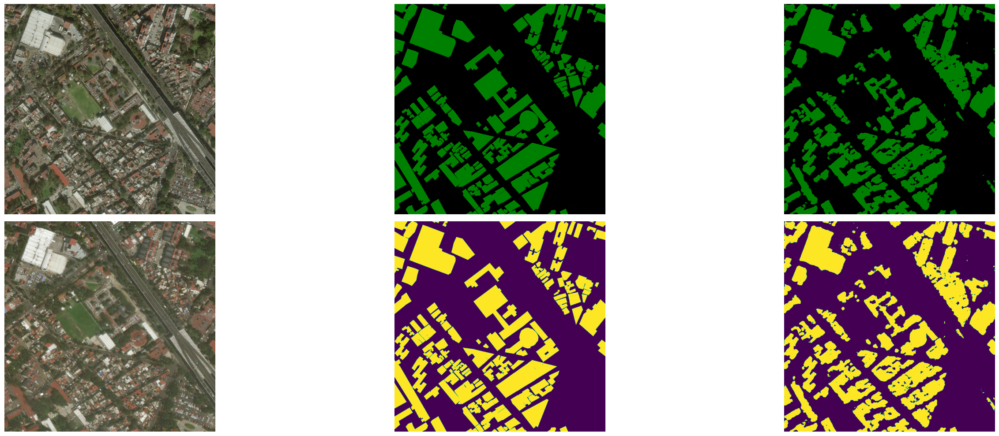

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


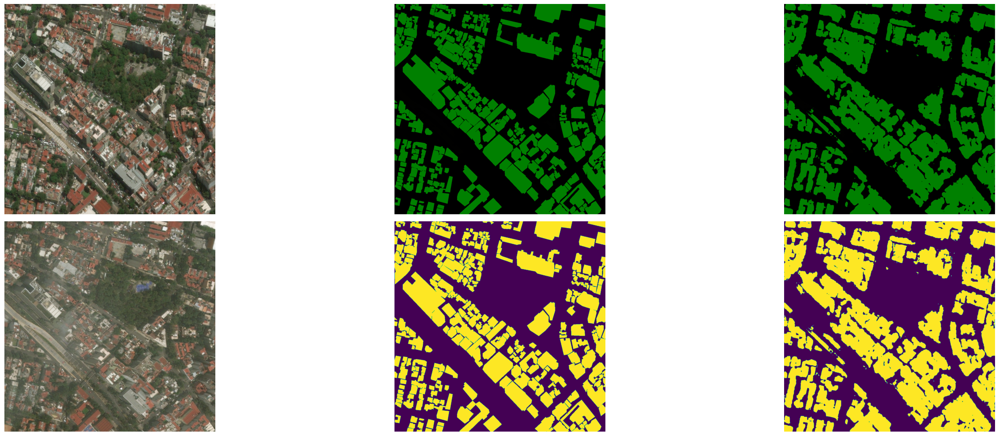

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[0].to(device)
font_mascara = first_batch_masks[0].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


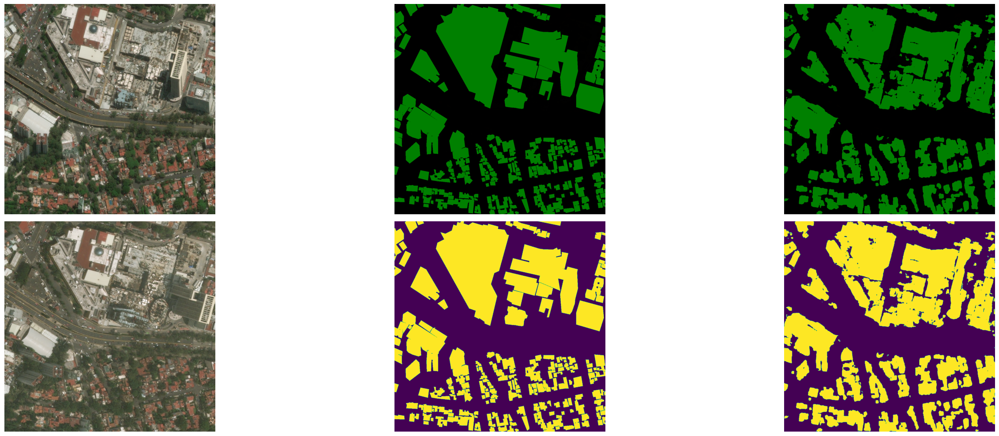

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


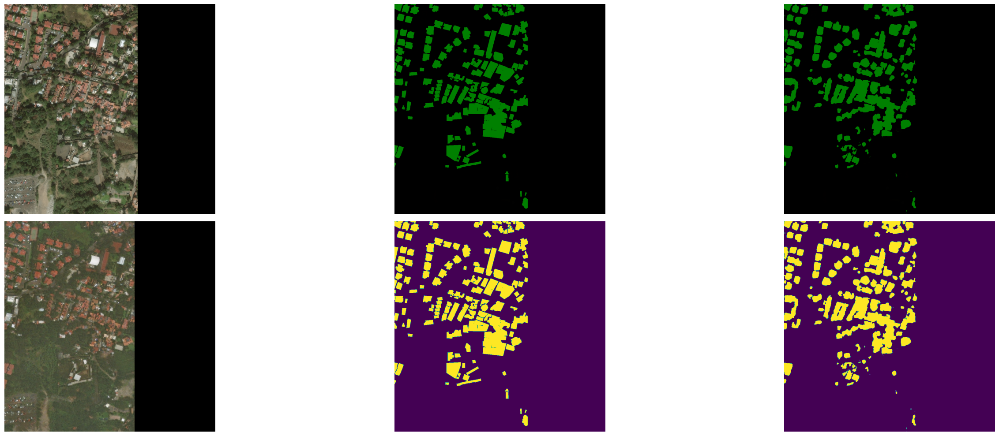

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

In [ ]:
font_imagem.shape

torch.Size([6, 1024, 1024])

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

metrics_dataset_pytorch(model,holdout_loader)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.

({0: 0.9861379582315618,
  1: 0.5856633156544618,
  2: 0.05430699926909963,
  3: 0.2125127216426888,
  4: 0.28195350031783567},
 {0: 0.9913942569996602,
  1: 0.6332483882508592,
  2: 2.7026458112648624e-05,
  3: 0.09954887059124229,
  4: 0.172702437338884},
 {0: 0.9887157153353865,
  1: 0.5789875149168519,
  2: 5.387773922279805e-05,
  3: 0.10559440688786081,
  4: 0.1969258005237046})

## BDAnet 2

In [ ]:
model = torch.load('/content/drive/MyDrive/Modeling Satelities Images Building Damaged/models/modelBDA_2.pth')

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


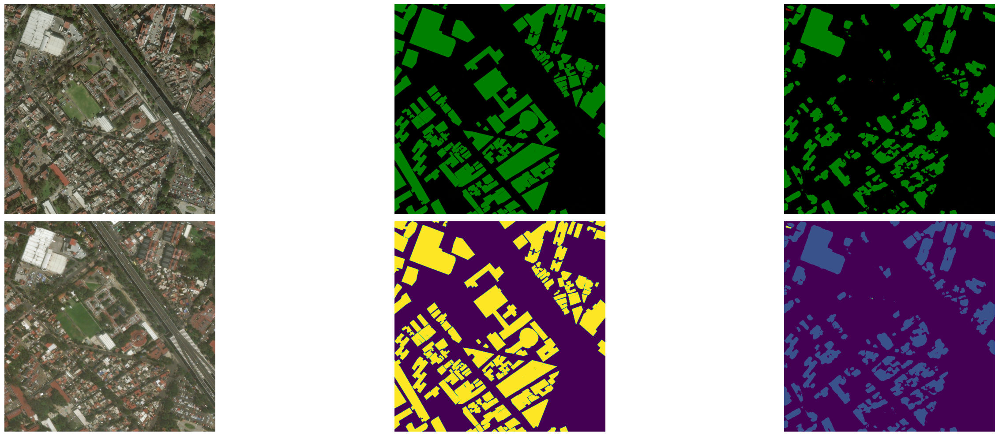

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


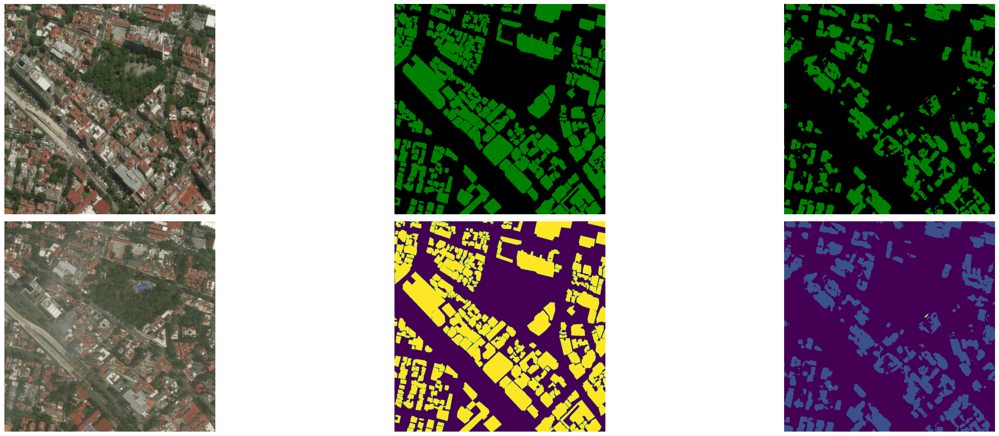

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[0].to(device)
font_mascara = first_batch_masks[0].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


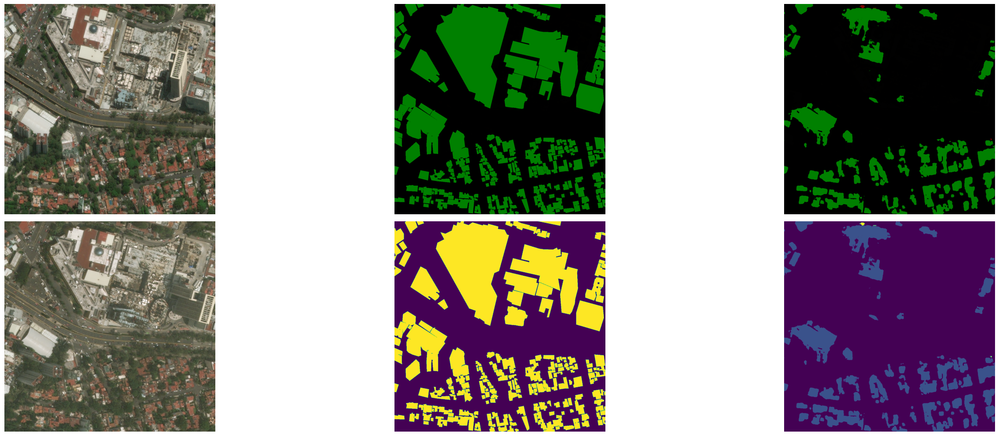

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

(1024, 1024, 3) (1024, 1024, 3) (1024, 1024) (1024, 1024)


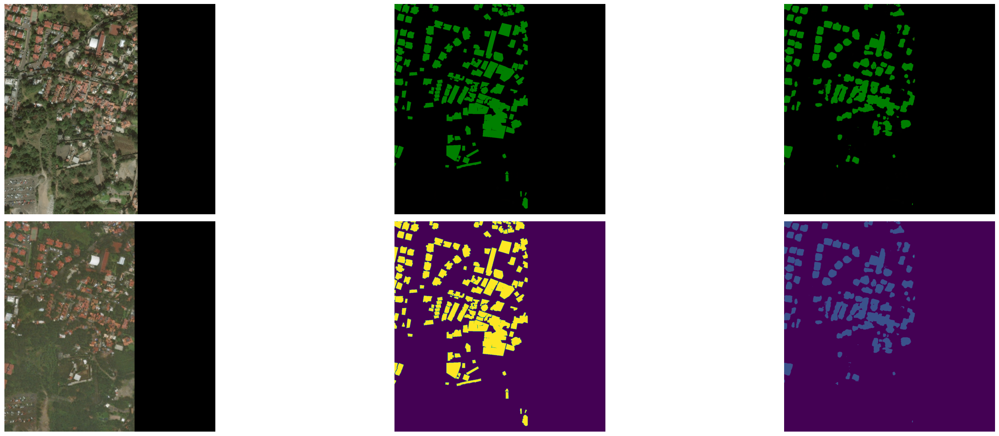

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(holdout_loader)

# Pega o primeiro lote
first_batch_images, first_batch_masks = next(data_iter)
first_batch_images, first_batch_masks = next(data_iter)

font_imagem = first_batch_images[2].to(device)
font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

visualize_predict_pytorch(model, font_imagem, font_mascara, device)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

metrics_dataset_pytorch(model,holdout_loader)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.

({0: 0.9752807785547203,
  1: 0.6152814355987223,
  2: 0.009186954524575103,
  3: 0.1996225855741137,
  4: 0.25526375160426545},
 {0: 0.9962922110192046,
  1: 0.5135552310779179,
  2: 8.60352723560046e-07,
  3: 0.03213680431479129,
  4: 0.14219549887784402},
 {0: 0.9853523553827821,
  1: 0.5273142760260713,
  2: 1.7203906131546591e-06,
  3: 0.047937985780007866,
  4: 0.16893186800844284})

## test_train_3

### Importação do modelo

In [196]:
import numpy as np
from tensorflow.keras import Model
from tensorflow.keras.layers import Conv2D, Activation, UpSampling2D, Concatenate, Input
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.initializers import HeNormal
from tensorflow.keras import backend as K

class ConvRelu(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3):
        super(ConvRelu, self).__init__()
        self.layer = nn.Sequential(
            nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, padding=1),
            nn.ReLU(inplace=True, )
        )
    #@autocast()
    def forward(self, x):
        return self.layer(x)

In [197]:
"""
ResNet code gently borrowed from
https://github.com/pytorch/vision/blob/master/torchvision/models/resnet.py
"""

from collections import OrderedDict
import math

import torch
import torch.nn as nn
from torch.utils import model_zoo

__all__ = ['SENet', 'senet154', 'se_resnet50', 'se_resnet101', 'se_resnet152',
           'se_resnext50_32x4d', 'se_resnext101_32x4d']

pretrained_settings = {
    'senet154': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/senet154-c7b49a05.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnet50': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnet50-ce0d4300.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnet101': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnet101-7e38fcc6.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnet152': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnet152-d17c99b7.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnext50_32x4d': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnext50_32x4d-a260b3a4.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
    'se_resnext101_32x4d': {
        'imagenet': {
            'url': 'http://data.lip6.fr/cadene/pretrainedmodels/se_resnext101_32x4d-3b2fe3d8.pth',
            'input_space': 'RGB',
            'input_size': [3, 224, 224],
            'input_range': [0, 1],
            'mean': [0.485, 0.456, 0.406],
            'std': [0.229, 0.224, 0.225],
            'num_classes': 1000
        }
    },
}


class SEModule(nn.Module):

    def __init__(self, channels, reduction, concat=False):
        super(SEModule, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc1 = nn.Conv2d(channels, channels // reduction, kernel_size=1,
                             padding=0)
        self.relu = nn.ReLU(inplace=True)
        self.fc2 = nn.Conv2d(channels // reduction, channels, kernel_size=1,
                             padding=0)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        module_input = x
        x = self.avg_pool(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.sigmoid(x)
        return module_input * x

class SCSEModule(nn.Module):
    # according to https://arxiv.org/pdf/1808.08127.pdf concat is better
    def __init__(self, channels, reduction=16, concat=False):
        super(SCSEModule, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc1 = nn.Conv2d(channels, channels // reduction, kernel_size=1,
                             padding=0)
        self.relu = nn.ReLU(inplace=True)
        self.fc2 = nn.Conv2d(channels // reduction, channels, kernel_size=1,
                             padding=0)
        self.sigmoid = nn.Sigmoid()

        self.spatial_se = nn.Sequential(nn.Conv2d(channels, 1, kernel_size=1,
                                                  stride=1, padding=0, bias=False),
                                        nn.Sigmoid())
        self.concat = concat

    def forward(self, x):
        module_input = x

        x = self.avg_pool(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        chn_se = self.sigmoid(x)
        chn_se = chn_se * module_input

        spa_se = self.spatial_se(module_input)
        spa_se = module_input * spa_se
        if self.concat:
            return torch.cat([chn_se, spa_se], dim=1)
        else:
            return chn_se + spa_se

class Bottleneck(nn.Module):
    """
    Base class for bottlenecks that implements `forward()` method.
    """
    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out = self.se_module(out) + residual
        out = self.relu(out)

        return out


class SEBottleneck(Bottleneck):
    """
    Bottleneck for SENet154.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None):
        super(SEBottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes * 2, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes * 2)
        self.conv2 = nn.Conv2d(planes * 2, planes * 4, kernel_size=3,
                               stride=stride, padding=1, groups=groups,
                               bias=False)
        self.bn2 = nn.BatchNorm2d(planes * 4)
        self.conv3 = nn.Conv2d(planes * 4, planes * 4, kernel_size=1,
                               bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SCSEBottleneck(Bottleneck):
    """
    Bottleneck for SENet154.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None):
        super(SCSEBottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes * 2, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes * 2)
        self.conv2 = nn.Conv2d(planes * 2, planes * 4, kernel_size=3,
                               stride=stride, padding=1, groups=groups,
                               bias=False)
        self.bn2 = nn.BatchNorm2d(planes * 4)
        self.conv3 = nn.Conv2d(planes * 4, planes * 4, kernel_size=1,
                               bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SCSEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SEResNetBottleneck(Bottleneck):
    """
    ResNet bottleneck with a Squeeze-and-Excitation module. It follows Caffe
    implementation and uses `stride=stride` in `conv1` and not in `conv2`
    (the latter is used in the torchvision implementation of ResNet).
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None):
        super(SEResNetBottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False,
                               stride=stride)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, padding=1,
                               groups=groups, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv3 = nn.Conv2d(planes, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SEResNeXtBottleneck(Bottleneck):
    """
    ResNeXt bottleneck type C with a Squeeze-and-Excitation module.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None, base_width=4):
        super(SEResNeXtBottleneck, self).__init__()
        width = math.floor(planes * (base_width / 64)) * groups
        self.conv1 = nn.Conv2d(inplanes, width, kernel_size=1, bias=False,
                               stride=1)
        self.bn1 = nn.BatchNorm2d(width)
        self.conv2 = nn.Conv2d(width, width, kernel_size=3, stride=stride,
                               padding=1, groups=groups, bias=False)
        self.bn2 = nn.BatchNorm2d(width)
        self.conv3 = nn.Conv2d(width, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride



class SCSEResNeXtBottleneck(Bottleneck):
    """
    ResNeXt bottleneck type C with a Concurrent Spatial Squeeze-and-Excitation module.
    """
    expansion = 4

    def __init__(self, inplanes, planes, groups, reduction, stride=1,
                 downsample=None, base_width=4, final=False):
        super(SCSEResNeXtBottleneck, self).__init__()
        width = math.floor(planes * (base_width / 64)) * groups
        self.conv1 = nn.Conv2d(inplanes, width, kernel_size=1, bias=False,
                               stride=1)
        self.bn1 = nn.BatchNorm2d(width)
        self.conv2 = nn.Conv2d(width, width, kernel_size=3, stride=stride,
                               padding=1, groups=groups, bias=False)
        self.bn2 = nn.BatchNorm2d(width)
        self.conv3 = nn.Conv2d(width, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.se_module = SCSEModule(planes * 4, reduction=reduction)
        self.downsample = downsample
        self.stride = stride


class SENet(nn.Module):

    def __init__(self, block, layers, groups, reduction, dropout_p=0.2,
                 inplanes=128, input_3x3=True, downsample_kernel_size=3,
                 downsample_padding=1, num_classes=1000):
        """
        Parameters
        ----------
        block (nn.Module): Bottleneck class.
            - For SENet154: SEBottleneck
            - For SE-ResNet models: SEResNetBottleneck
            - For SE-ResNeXt models:  SEResNeXtBottleneck
        layers (list of ints): Number of residual blocks for 4 layers of the
            network (layer1...layer4).
        groups (int): Number of groups for the 3x3 convolution in each
            bottleneck block.
            - For SENet154: 64
            - For SE-ResNet models: 1
            - For SE-ResNeXt models:  32
        reduction (int): Reduction ratio for Squeeze-and-Excitation modules.
            - For all models: 16
        dropout_p (float or None): Drop probability for the Dropout layer.
            If `None` the Dropout layer is not used.
            - For SENet154: 0.2
            - For SE-ResNet models: None
            - For SE-ResNeXt models: None
        inplanes (int):  Number of input channels for layer1.
            - For SENet154: 128
            - For SE-ResNet models: 64
            - For SE-ResNeXt models: 64
        input_3x3 (bool): If `True`, use three 3x3 convolutions instead of
            a single 7x7 convolution in layer0.
            - For SENet154: True
            - For SE-ResNet models: False
            - For SE-ResNeXt models: False
        downsample_kernel_size (int): Kernel size for downsampling convolutions
            in layer2, layer3 and layer4.
            - For SENet154: 3
            - For SE-ResNet models: 1
            - For SE-ResNeXt models: 1
        downsample_padding (int): Padding for downsampling convolutions in
            layer2, layer3 and layer4.
            - For SENet154: 1
            - For SE-ResNet models: 0
            - For SE-ResNeXt models: 0
        num_classes (int): Number of outputs in `last_linear` layer.
            - For all models: 1000
        """
        super(SENet, self).__init__()
        self.inplanes = inplanes
        if input_3x3:
            layer0_modules = [
                ('conv1', nn.Conv2d(3, 64, 3, stride=2, padding=1,
                                    bias=False)),
                ('bn1', nn.BatchNorm2d(64)),
                ('relu1', nn.ReLU(inplace=True)),
                ('conv2', nn.Conv2d(64, 64, 3, stride=1, padding=1,
                                    bias=False)),
                ('bn2', nn.BatchNorm2d(64)),
                ('relu2', nn.ReLU(inplace=True)),
                ('conv3', nn.Conv2d(64, inplanes, 3, stride=1, padding=1,
                                    bias=False)),
                ('bn3', nn.BatchNorm2d(inplanes)),
                ('relu3', nn.ReLU(inplace=True)),
            ]
        else:
            layer0_modules = [
                ('conv1', nn.Conv2d(3, inplanes, kernel_size=7, stride=2,
                                    padding=3, bias=False)),
                ('bn1', nn.BatchNorm2d(inplanes)),
                ('relu1', nn.ReLU(inplace=True)),
            ]
        # To preserve compatibility with Caffe weights `ceil_mode=True`
        # is used instead of `padding=1`.
        self.pool = nn.MaxPool2d(3, stride=2, ceil_mode=True)
        self.layer0 = nn.Sequential(OrderedDict(layer0_modules))
        self.layer1 = self._make_layer(
            block,
            planes=64,
            blocks=layers[0],
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=1,
            downsample_padding=0
        )
        self.layer2 = self._make_layer(
            block,
            planes=128,
            blocks=layers[1],
            stride=2,
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=downsample_kernel_size,
            downsample_padding=downsample_padding
        )
        self.layer3 = self._make_layer(
            block,
            planes=256,
            blocks=layers[2],
            stride=2,
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=downsample_kernel_size,
            downsample_padding=downsample_padding
        )
        self.layer4 = self._make_layer(
            block,
            planes=512,
            blocks=layers[3],
            stride=2,
            groups=groups,
            reduction=reduction,
            downsample_kernel_size=downsample_kernel_size,
            downsample_padding=downsample_padding
        )
        self.avg_pool = nn.AvgPool2d(7, stride=1)
        self.dropout = nn.Dropout(dropout_p) if dropout_p is not None else None
        self.last_linear = nn.Linear(512 * block.expansion, num_classes)
        self._initialize_weights()

    def _make_layer(self, block, planes, blocks, groups, reduction, stride=1,
                    downsample_kernel_size=1, downsample_padding=0):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=downsample_kernel_size, stride=stride,
                          padding=downsample_padding, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = []
        layers.append(block(self.inplanes, planes, groups, reduction, stride,
                            downsample))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes, groups, reduction))

        return nn.Sequential(*layers)

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
                m.weight.data = nn.init.kaiming_normal_(m.weight.data)
                if m.bias is not None:
                    m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def features(self, x):
        x = self.layer0(x)
        x = self.pool(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        return x

    def logits(self, x):
        x = self.avg_pool(x)
        if self.dropout is not None:
            x = self.dropout(x)
        x = x.view(x.size(0), -1)
        x = self.last_linear(x)
        return x

    def forward(self, x):
        x = self.features(x)
        x = self.logits(x)
        return x


def initialize_pretrained_model(model, num_classes, settings):
    assert num_classes == settings['num_classes'], \
        'num_classes should be {}, but is {}'.format(
            settings['num_classes'], num_classes)
    model.load_state_dict(model_zoo.load_url(settings['url']), strict=False)
    model.input_space = settings['input_space']
    model.input_size = settings['input_size']
    model.input_range = settings['input_range']
    model.mean = settings['mean']
    model.std = settings['std']


def senet154(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEBottleneck, [3, 8, 36, 3], groups=64, reduction=16,
                  dropout_p=0.2, num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['senet154'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model

def scsenet154(num_classes=1000, pretrained='imagenet'):
    print("scsenet154")
    model = SENet(SCSEBottleneck, [3, 8, 36, 3], groups=64, reduction=16,
                  dropout_p=0.2, num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['senet154'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnet50(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNetBottleneck, [3, 4, 6, 3], groups=1, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnet50'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnet101(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNetBottleneck, [3, 4, 23, 3], groups=1, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnet101'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnet152(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNetBottleneck, [3, 8, 36, 3], groups=1, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnet152'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnext50_32x4d(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNeXtBottleneck, [3, 4, 6, 3], groups=32, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnext50_32x4d'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def scse_resnext50_32x4d(num_classes=1000, pretrained='imagenet'):
    model = SENet(SCSEResNeXtBottleneck, [3, 4, 6, 3], groups=32, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnext50_32x4d'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model


def se_resnext101_32x4d(num_classes=1000, pretrained='imagenet'):
    model = SENet(SEResNeXtBottleneck, [3, 4, 23, 3], groups=32, reduction=16,
                  dropout_p=None, inplanes=64, input_3x3=False,
                  downsample_kernel_size=1, downsample_padding=0,
                  num_classes=num_classes)
    if pretrained is not None:
        settings = pretrained_settings['se_resnext101_32x4d'][pretrained]
        initialize_pretrained_model(model, num_classes, settings)
    return model

In [198]:
class SeResNext50_Unet_2Ssum(nn.Module):
    def __init__(self, pretrained='imagenet', **kwargs):
        super(SeResNext50_Unet_2Ssum, self).__init__()

        encoder_filters = [64, 256, 512, 1024, 2048]
        decoder_filters = np.asarray([64, 96, 128, 256, 512]) // 2

        self.conv6 = ConvRelu(encoder_filters[-1], decoder_filters[-1])
        self.conv6_2 = ConvRelu(decoder_filters[-1] + encoder_filters[-2], decoder_filters[-1])
        self.conv7 = ConvRelu(decoder_filters[-1], decoder_filters[-2])
        self.conv7_2 = ConvRelu(decoder_filters[-2] + encoder_filters[-3] , decoder_filters[-2] )
        self.conv8 = ConvRelu(decoder_filters[-2], decoder_filters[-3])
        self.conv8_2 = ConvRelu(decoder_filters[-3] + encoder_filters[-4] , decoder_filters[-3])
        self.conv9 = ConvRelu(decoder_filters[-3], decoder_filters[-4])
        self.conv9_2 = ConvRelu(decoder_filters[-4] + encoder_filters[-5], decoder_filters[-4])

        # self.convx9_3 = ConvRelu(encoder_filters[-4], encoder_filters[-4])


        self.conv10 = ConvRelu(decoder_filters[-4], decoder_filters[-5])
        self.conv10_s = nn.Sequential(ConvRelu(decoder_filters[-5], decoder_filters[-5]),
                                      nn.Conv2d(decoder_filters[-5] , 1, 1, stride=1, padding=0),
                                      nn.Sigmoid())
        # self.convxx = nn.Sequential(ConvRelu(decoder_filters[-5]*2, decoder_filters[-5]*2),
        #                             nn.Conv2d(decoder_filters[-5] * 2, decoder_filters[-5], 1, stride=1, padding=0))

        self.res = nn.Conv2d(decoder_filters[-5] * 2, 5, 1, stride=1, padding=0)

        self._initialize_weights()

        encoder = se_resnext50_32x4d(pretrained=pretrained)
        #encoder = torchvision.models.resnet50(pretrained=pretrained)
        self.conv1 = nn.Sequential(encoder.layer0.conv1, encoder.layer0.bn1, encoder.layer0.relu1) #encoder.layer0.conv1
        self.conv2 = nn.Sequential(encoder.pool, encoder.layer1)
        self.conv3 = encoder.layer2
        self.conv4 = encoder.layer3
        self.conv5 = encoder.layer4


    def forward1(self, x):
        batch_size, C, H, W = x.shape
        xx = F.interpolate(x, scale_factor=0.5, mode='bilinear', align_corners=False)

        enc1 = self.conv1(x)
        enc2 = self.conv2(enc1)
        enc3 = self.conv3(enc2)
        enc4 = self.conv4(enc3)
        enc5 = self.conv5(enc4)

        encx1 = self.conv1(xx)   # 64 128 128
        encx2 = self.conv2(encx1) # 64
        encx3 = self.conv3(encx2) # 32
        encx4 = self.conv4(encx3) # 16
        encx5 = self.conv5(encx4) # 8

        dec6 = self.conv6(F.interpolate(enc5, scale_factor=2))
        dec6 = self.conv6_2(torch.cat([dec6, enc4 ], 1))
        dec7 = self.conv7(F.interpolate(dec6, scale_factor=2))
        dec7 = self.conv7_2(torch.cat([dec7, enc3], 1))
        dec8 = self.conv8(F.interpolate(dec7, scale_factor=2))
        dec8 = self.conv8_2(torch.cat([dec8, enc2], 1))
        dec9 = self.conv9(F.interpolate(dec8, scale_factor=2))
        dec9 = self.conv9_2(torch.cat([dec9,  enc1], 1))   #256

        decx6 = self.conv6(F.interpolate(encx5, scale_factor=2))
        decx6 = self.conv6_2(torch.cat([decx6, encx4 ], 1))
        decx7 = self.conv7(F.interpolate(decx6, scale_factor=2))
        decx7 = self.conv7_2(torch.cat([decx7, encx3], 1))
        decx8 = self.conv8(F.interpolate(decx7, scale_factor=2))
        decx8 = self.conv8_2(torch.cat([decx8, encx2], 1))
        decx9 = self.conv9(F.interpolate(decx8, scale_factor=2))
        decx9 = self.conv9_2(torch.cat([decx9,  encx1], 1))   #128
        #decx9 = self.convx9_3(F.interpolate(decx9, scale_factor=4))


        dec10 = self.conv10(F.interpolate(dec9, scale_factor=2))
        alpha = self.conv10_s(dec10)
        decx10 = self.conv10(F.interpolate(decx9, scale_factor=4))

        dec = alpha * dec10 + (1-alpha)*decx10

        return dec

    def forward(self, x):
        dec10_0 = self.forward1(x[:, :3, :, :])
        dec10_1 = self.forward1(x[:, 3:, :, :])

        dec10 = torch.cat([dec10_0, dec10_1], 1)

        return self.res(dec10)


    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Linear):
                m.weight.data = nn.init.kaiming_normal_(m.weight.data)
                if m.bias is not None:
                    m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

In [199]:
import numpy as np
import torch
import torch.nn.functional as F
from torch import nn
from torch.autograd import Variable

try:
    from itertools import ifilterfalse
except ImportError:  # py3k
    from itertools import filterfalse

eps = 1e-6

def dice_round(preds, trues):
    preds = preds.float()
    return soft_dice_loss(preds, trues)


def iou_round(preds, trues):
    preds = preds.float()
    return jaccard(preds, trues)


def soft_dice_loss(outputs, targets, per_image=False):
    batch_size = outputs.size()[0]
    if not per_image:
        batch_size = 1
    dice_target = targets.contiguous().view(batch_size, -1).float()
    dice_output = outputs.contiguous().view(batch_size, -1)
    intersection = torch.sum(dice_output * dice_target, dim=1)
    union = torch.sum(dice_output, dim=1) + torch.sum(dice_target, dim=1) + eps
    loss = (1 - (2 * intersection + eps) / union).mean()
    return loss


def jaccard(outputs, targets, per_image=False):
    batch_size = outputs.size()[0]
    if not per_image:
        batch_size = 1
    dice_target = targets.contiguous().view(batch_size, -1).float()
    dice_output = outputs.contiguous().view(batch_size, -1)
    intersection = torch.sum(dice_output * dice_target, dim=1)
    union = torch.sum(dice_output, dim=1) + torch.sum(dice_target, dim=1) - intersection + eps
    losses = 1 - (intersection + eps) / union
    return losses.mean()


class DiceLoss(nn.Module):
    def __init__(self, weight=None, size_average=True, per_image=False):
        super().__init__()
        self.size_average = size_average
        self.register_buffer('weight', weight)
        self.per_image = per_image

    def forward(self, input, target):
        return soft_dice_loss(input, target, per_image=self.per_image)


class JaccardLoss(nn.Module):
    def __init__(self, weight=None, size_average=True, per_image=False):
        super().__init__()
        self.size_average = size_average
        self.register_buffer('weight', weight)
        self.per_image = per_image

    def forward(self, input, target):
        return jaccard(input, target, per_image=self.per_image)


class StableBCELoss(nn.Module):
    def __init__(self):
        super(StableBCELoss, self).__init__()

    def forward(self, input, target):
        input = input.float().view(-1)
        target = target.float().view(-1)
        neg_abs = - input.abs()
        # todo check correctness
        loss = input.clamp(min=0) - input * target + (1 + neg_abs.exp()).log()
        return loss.mean()


class ComboLoss(nn.Module):
    def __init__(self, weights, per_image=False):
        super().__init__()
        self.weights = weights
        self.bce = StableBCELoss()
        self.dice = DiceLoss(per_image=False)
        self.jaccard = JaccardLoss(per_image=False)
        self.lovasz = LovaszLoss(per_image=per_image)
        self.lovasz_sigmoid = LovaszLossSigmoid(per_image=per_image)
        self.focal = FocalLoss2d()
        self.mapping = {'bce': self.bce,
                        'dice': self.dice,
                        'focal': self.focal,
                        'jaccard': self.jaccard,
                        'lovasz': self.lovasz,
                        'lovasz_sigmoid': self.lovasz_sigmoid}
        self.expect_sigmoid = {'dice', 'focal', 'jaccard', 'lovasz_sigmoid'}
        self.values = {}

    def forward(self, outputs, targets):
        loss = 0
        weights = self.weights
        sigmoid_input = torch.sigmoid(outputs)
        for k, v in weights.items():
            if not v:
                continue
            val = self.mapping[k](sigmoid_input if k in self.expect_sigmoid else outputs, targets)
            self.values[k] = val
            loss += self.weights[k] * val
        return loss


def lovasz_grad(gt_sorted):
    """
    Computes gradient of the Lovasz extension w.r.t sorted errors
    See Alg. 1 in paper
    """
    p = len(gt_sorted)
    gts = gt_sorted.sum()
    intersection = gts.float() - gt_sorted.float().cumsum(0)
    union = gts.float() + (1 - gt_sorted).float().cumsum(0)
    jaccard = 1. - intersection / union
    if p > 1:  # cover 1-pixel case
        jaccard[1:p] = jaccard[1:p] - jaccard[0:-1]
    return jaccard


def lovasz_hinge(logits, labels, per_image=True, ignore=None):
    """
    Binary Lovasz hinge loss
      logits: [B, H, W] Variable, logits at each pixel (between -\infty and +\infty)
      labels: [B, H, W] Tensor, binary ground truth masks (0 or 1)
      per_image: compute the loss per image instead of per batch
      ignore: void class id
    """
    if per_image:
        loss = mean(lovasz_hinge_flat(*flatten_binary_scores(log.unsqueeze(0), lab.unsqueeze(0), ignore))
                    for log, lab in zip(logits, labels))
    else:
        loss = lovasz_hinge_flat(*flatten_binary_scores(logits, labels, ignore))
    return loss


def lovasz_hinge_flat(logits, labels):
    """
    Binary Lovasz hinge loss
      logits: [P] Variable, logits at each prediction (between -\infty and +\infty)
      labels: [P] Tensor, binary ground truth labels (0 or 1)
      ignore: label to ignore
    """
    if len(labels) == 0:
        # only void pixels, the gradients should be 0
        return logits.sum() * 0.
    signs = 2. * labels.float() - 1.
    errors = (1. - logits * Variable(signs))
    errors_sorted, perm = torch.sort(errors, dim=0, descending=True)
    perm = perm.data
    gt_sorted = labels[perm]
    grad = lovasz_grad(gt_sorted)
    loss = torch.dot(F.relu(errors_sorted), Variable(grad))
    return loss


def flatten_binary_scores(scores, labels, ignore=None):
    """
    Flattens predictions in the batch (binary case)
    Remove labels equal to 'ignore'
    """
    scores = scores.view(-1)
    labels = labels.view(-1)
    if ignore is None:
        return scores, labels
    valid = (labels != ignore)
    vscores = scores[valid]
    vlabels = labels[valid]
    return vscores, vlabels


def lovasz_sigmoid(probas, labels, per_image=False, ignore=None):
    """
    Multi-class Lovasz-Softmax loss
      probas: [B, C, H, W] Variable, class probabilities at each prediction (between 0 and 1)
      labels: [B, H, W] Tensor, ground truth labels (between 0 and C - 1)
      only_present: average only on classes present in ground truth
      per_image: compute the loss per image instead of per batch
      ignore: void class labels
    """
    if per_image:
        loss = mean(lovasz_sigmoid_flat(*flatten_binary_scores(prob.unsqueeze(0), lab.unsqueeze(0), ignore))
                          for prob, lab in zip(probas, labels))
    else:
        loss = lovasz_sigmoid_flat(*flatten_binary_scores(probas, labels, ignore))
    return loss


def lovasz_sigmoid_flat(probas, labels):
    """
    Multi-class Lovasz-Softmax loss
      probas: [P, C] Variable, class probabilities at each prediction (between 0 and 1)
      labels: [P] Tensor, ground truth labels (between 0 and C - 1)
      only_present: average only on classes present in ground truth
    """
    fg = labels.float()
    errors = (Variable(fg) - probas).abs()
    errors_sorted, perm = torch.sort(errors, 0, descending=True)
    perm = perm.data
    fg_sorted = fg[perm]
    loss = torch.dot(errors_sorted, Variable(lovasz_grad(fg_sorted)))
    return loss


def mean(l, ignore_nan=False, empty=0):
    """
    nanmean compatible with generators.
    """
    l = iter(l)
    if ignore_nan:
        l = ifilterfalse(np.isnan, l)
    try:
        n = 1
        acc = next(l)
    except StopIteration:
        if empty == 'raise':
            raise ValueError('Empty mean')
        return empty
    for n, v in enumerate(l, 2):
        acc += v
    if n == 1:
        return acc
    return acc / n


class LovaszLoss(nn.Module):
    def __init__(self, ignore_index=255, per_image=True):
        super().__init__()
        self.ignore_index = ignore_index
        self.per_image = per_image

    def forward(self, outputs, targets):
        outputs = outputs.contiguous()
        targets = targets.contiguous()
        return lovasz_hinge(outputs, targets, per_image=self.per_image, ignore=self.ignore_index)


class LovaszLossSigmoid(nn.Module):
    def __init__(self, ignore_index=255, per_image=True):
        super().__init__()
        self.ignore_index = ignore_index
        self.per_image = per_image

    def forward(self, outputs, targets):
        outputs = outputs.contiguous()
        targets = targets.contiguous()
        return lovasz_sigmoid(outputs, targets, per_image=self.per_image, ignore=self.ignore_index)


class FocalLoss2d(nn.Module):
    def __init__(self, gamma=2, ignore_index=255):
        super().__init__()
        self.gamma = gamma
        self.ignore_index = ignore_index

    def forward(self, outputs, targets):
        outputs = outputs.contiguous()
        targets = targets.contiguous()
        # eps = 1e-8
        non_ignored = targets.view(-1) != self.ignore_index
        targets = targets.view(-1)[non_ignored].float()
        outputs = outputs.contiguous().view(-1)[non_ignored]
        outputs = torch.clamp(outputs, eps, 1. - eps)
        targets = torch.clamp(targets, eps, 1. - eps)
        pt = (1 - targets) * (1 - outputs) + targets * outputs
        return (-(1. - pt) ** self.gamma * torch.log(pt)).mean()

In [200]:
import ssl
import torch.optim.lr_scheduler as lr_scheduler
ssl._create_default_https_context = ssl._create_unverified_context
model = SeResNext50_Unet_2Ssum().cuda()

params = model.parameters()

optimizer = AdamW(params, lr=0.000202, weight_decay=1e-6)     #0.002

#model, optimizer = amp.initialize(model, optimizer, opt_level="O1")
#model = nn.DataParallel(model).cuda()

scheduler = lr_scheduler.MultiStepLR(optimizer, milestones=[5, 13, 19, 23, 28, 47, 50, 60, 70, 90, 110, 130, 150, 170, 180, 190], gamma=0.5)
#scheduler = lr_scheduler.MultiStepLR(optimizer, milestones=[5, 11, 15, 23,  29, 33, 47, 50, 60, 70, 90, 110, 130, 150, 170, 180, 190], gamma=0.5)

#snap_to_load = 'res50_cls_cutmixCE1_{}_0_best'.format(seed)
#print("=> loading checkpoint '{}'".format(snap_to_load))
#checkpoint = torch.load(path.join(models_folder, snap_to_load), map_location='cpu')
#loaded_dict = checkpoint['state_dict']
#sd = model.state_dict()
#for k in model.state_dict():
#    if k in loaded_dict and sd[k].size() == loaded_dict[k].size():
#        sd[k] = loaded_dict[k]
#loaded_dict = sd
#model.load_state_dict(loaded_dict)
#print("loaded checkpoint '{}' (epoch {}, best_score {})"
#        .format(snap_to_load, checkpoint['epoch'], checkpoint['best_score']))
#del loaded_dict
#del sd
#del checkpoint
gc.collect()
torch.cuda.empty_cache()

model = nn.DataParallel(model).cuda()

seg_loss = ComboLoss({'dice': 0.5, 'focal': 2.0}, per_image=False).cuda()
#wei = [2., 2., 3., 3., 2.]
#wei = torch.tensor(wei)
ce_loss = nn.CrossEntropyLoss().cuda()
seg_lossSeesaw = None#SeesawLoss2().cuda()

In [201]:
model.load_state_dict(torch.load('/content/drive/MyDrive/Modeling Satelities Images Building Damaged/src/train/weights/res50_cls_2Ssum_13_0_best')['state_dict'])

<All keys matched successfully>

In [202]:
print(model)

DataParallel(
  (module): SeResNext50_Unet_2Ssum(
    (conv6): ConvRelu(
      (layer): Sequential(
        (0): Conv2d(2048, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (conv6_2): ConvRelu(
      (layer): Sequential(
        (0): Conv2d(1280, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (conv7): ConvRelu(
      (layer): Sequential(
        (0): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (conv7_2): ConvRelu(
      (layer): Sequential(
        (0): Conv2d(640, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (conv8): ConvRelu(
      (layer): Sequential(
        (0): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (conv8_2): ConvRelu(
      (layer): Sequential(
        

### Preparação dos dados

In [ ]:
def preprocess_inputs(x):
    x = np.asarray(x, dtype='float32')
    x /= 127
    x -= 1
    return x

In [ ]:
import os
os.environ["MKL_NUM_THREADS"] = "2"
os.environ["NUMEXPR_NUM_THREADS"] = "2"
os.environ["OMP_NUM_THREADS"] = "2"

from os import path, makedirs, listdir
import sys
import numpy as np
np.random.seed(1)
import random
random.seed(1)

import torch
from torch import nn
from torch.backends import cudnn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.optim.lr_scheduler as lr_scheduler

#from apex import amp

import pandas as pd
from tqdm import tqdm
import timeit
import cv2

from imgaug import augmenters as iaa

from skimage.morphology import square, dilation

from sklearn.model_selection import train_test_split

from sklearn.metrics import accuracy_score

import gc

cv2.setNumThreads(0)
cv2.ocl.setUseOpenCL(False)

train_dirs = ['/content/drive/MyDrive/Modeling Satelities Images Building Damaged/data/test']

models_folder = '/content/drive/MyDrive/Modeling Satelities Images Building Damaged/src/train/weights'

loc_folder = 'pred_loc_val'

input_shape = (512, 512)


all_files = []
for d in tqdm(train_dirs):
    for f in sorted(listdir(path.join(d, 'images'))):
        if '_pre_disaster.png' in f:
            post_disaster_file = f.replace('_pre_disaster.png', '_post_disaster.png')
            if path.exists(path.join(d, 'images', post_disaster_file)):
                all_files.append(path.join(d, 'images', f))

100%|██████████| 1/1 [00:00<00:00,  7.07it/s]


In [ ]:
def rand_bbox(size, lam):
    W = size[0]
    H = size[1]
    cut_rat = np.sqrt(1. - lam)
    cut_w = int(W * cut_rat)
    cut_h = int(H * cut_rat)
    # if cut_rat > 0.9:
    #   cut_w = np.int(W * cut_rat * 0.9)
    #   cut_h = np.int(H * cut_rat * 0.9)

    # uniform
    cx = np.random.randint(W)
    cy = np.random.randint(H)

    bbx1 = np.clip(cx - cut_w // 2, 0, W)
    bby1 = np.clip(cy - cut_h // 2, 0, H)
    bbx2 = np.clip(cx + cut_w // 2, 0, W)
    bby2 = np.clip(cy + cut_h // 2, 0, H)

    return bbx1, bby1, bbx2, bby2

class TrainData(Dataset):
    def __init__(self, train_idxs, low, high):
        super().__init__()
        self.train_idxs = train_idxs
        self.elastic = iaa.ElasticTransformation(alpha=(0.25, 1.2), sigma=0.2)
        self.low =low
        self.high = high

    def __len__(self):
        return len(self.train_idxs)

    def __getitem__(self, idx):
        _idx = self.train_idxs[idx]

        fn = all_files[_idx]

        img = cv2.imread(fn, cv2.IMREAD_COLOR)
        img2 = cv2.imread(fn.replace('_pre_disaster', '_post_disaster'), cv2.IMREAD_COLOR)
        if img is None and img2 is None:
          sample = {'img': None, 'msk': None, 'lbl_msk': None, 'fn': None}

        msk0 = cv2.imread(fn.replace('/images/', '/targets/').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)
        lbl_msk1 = cv2.imread(fn.replace('/images/', '/targets/').replace('_pre_disaster', '_post_disaster').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)
        msk1 = np.zeros_like(lbl_msk1)
        msk2 = np.zeros_like(lbl_msk1)
        msk3 = np.zeros_like(lbl_msk1)
        msk4 = np.zeros_like(lbl_msk1)
        msk2[lbl_msk1 == 2] = 255
        msk3[lbl_msk1 == 3] = 255
        msk4[lbl_msk1 == 4] = 255
        msk1[lbl_msk1 == 1] = 255

        try:
          if random.random() > 0.87:
              lam = np.random.beta(2, 1.8)
              rand_inx = torch.randint(low=self.low,high=self.high,size=(1,))
              ttt = self.train_idxs[rand_inx]
              fn_rand = all_files[ttt]
              img_random = cv2.imread(fn_rand, cv2.IMREAD_COLOR)
              img2_random = cv2.imread(fn_rand.replace('_pre_disaster', '_post_disaster'), cv2.IMREAD_COLOR)
              msk0_random = cv2.imread(fn_rand.replace('/images/', '/targets/').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)
              lbl_msk1_random = cv2.imread(fn_rand.replace('/images/', '/targets/').replace('_pre_disaster', '_post_disaster').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)
              bbx1, bby1, bbx2, bby2 = rand_bbox((1024, 1024), lam)
              img[bbx1:bbx2, bby1:bby2, :] = img_random[bbx1:bbx2, bby1:bby2, :]
              img2[bbx1:bbx2, bby1:bby2, :] = img2_random[bbx1:bbx2, bby1:bby2, :]
              msk0[bbx1:bbx2, bby1:bby2] = msk0_random[bbx1:bbx2, bby1:bby2]
              lbl_msk1[bbx1:bbx2, bby1:bby2] = lbl_msk1_random[bbx1:bbx2, bby1:bby2]
              # lbl_msk1[lbl_msk1==1]=70
              # lbl_msk1[lbl_msk1==2]=130
              # lbl_msk1[lbl_msk1==3]=190
              # lbl_msk1[lbl_msk1==4]=255
              # cv2.imshow('input_image', lbl_msk1)
              # cv2.waitKey(5000)
        except:
          None

        msk2[lbl_msk1 == 2] = 255
        msk3[lbl_msk1 == 3] = 255
        msk4[lbl_msk1 == 4] = 255
        msk1[lbl_msk1 == 1] = 255

        try:
          if random.random() > 0.5:
              img = img[::-1, ...]
              img2 = img2[::-1, ...]
              msk0 = msk0[::-1, ...]
              msk1 = msk1[::-1, ...]
              msk2 = msk2[::-1, ...]
              msk3 = msk3[::-1, ...]
              msk4 = msk4[::-1, ...]
        except:
          None

        try:
          if random.random() > 0.05:
              rot = random.randrange(4)
              if rot > 0:
                img = np.rot90(img, k=rot)
                img2 = np.rot90(img2, k=rot)
                msk0 = np.rot90(msk0, k=rot)
                msk1 = np.rot90(msk1, k=rot)
                msk2 = np.rot90(msk2, k=rot)
                msk3 = np.rot90(msk3, k=rot)
                msk4 = np.rot90(msk4, k=rot)
        except:
          None

        try:
          if random.random() > 0.8:
              shift_pnt = (random.randint(-320, 320), random.randint(-320, 320))
              img = shift_image(img, shift_pnt)
              img2 = shift_image(img2, shift_pnt)
              msk0 = shift_image(msk0, shift_pnt)
              msk1 = shift_image(msk1, shift_pnt)
              msk2 = shift_image(msk2, shift_pnt)
              msk3 = shift_image(msk3, shift_pnt)
              msk4 = shift_image(msk4, shift_pnt)
        except:
          None

        try:
          if random.random() > 0.2:
              rot_pnt =  (img.shape[0] // 2 + random.randint(-320, 320), img.shape[1] // 2 + random.randint(-320, 320))
              scale = 0.9 + random.random() * 0.2
              angle = random.randint(0, 20) - 10
              if (angle != 0) or (scale != 1):
                  img = rotate_image(img, angle, scale, rot_pnt)
                  img2 = rotate_image(img2, angle, scale, rot_pnt)
                  msk0 = rotate_image(msk0, angle, scale, rot_pnt)
                  msk1 = rotate_image(msk1, angle, scale, rot_pnt)
                  msk2 = rotate_image(msk2, angle, scale, rot_pnt)
                  msk3 = rotate_image(msk3, angle, scale, rot_pnt)
                  msk4 = rotate_image(msk4, angle, scale, rot_pnt)
        except:
          None

        crop_size = input_shape[0]

        try:
          if random.random() > 0.1:
              crop_size = random.randint(int(input_shape[0] / 1.15), int(input_shape[0] / 0.85))
        except:
          None

        try:
          bst_x0 = random.randint(0, img.shape[1] - crop_size)
          bst_y0 = random.randint(0, img.shape[0] - crop_size)
          bst_sc = -1
          try_cnt = random.randint(1, 10)
          for i in range(try_cnt):
              x0 = random.randint(0, img.shape[1] - crop_size)
              y0 = random.randint(0, img.shape[0] - crop_size)
              _sc = msk2[y0:y0+crop_size, x0:x0+crop_size].sum() * 5 + msk3[y0:y0+crop_size, x0:x0+crop_size].sum() * 5 + msk4[y0:y0+crop_size, x0:x0+crop_size].sum() * 2 + msk1[y0:y0+crop_size, x0:x0+crop_size].sum()
              if _sc > bst_sc:
                  bst_sc = _sc
                  bst_x0 = x0
                  bst_y0 = y0
          x0 = bst_x0
          y0 = bst_y0
          img = img[y0:y0+crop_size, x0:x0+crop_size, :]
          img2 = img2[y0:y0+crop_size, x0:x0+crop_size, :]
          msk0 = msk0[y0:y0+crop_size, x0:x0+crop_size]
          msk1 = msk1[y0:y0+crop_size, x0:x0+crop_size]
          msk2 = msk2[y0:y0+crop_size, x0:x0+crop_size]
          msk3 = msk3[y0:y0+crop_size, x0:x0+crop_size]
          msk4 = msk4[y0:y0+crop_size, x0:x0+crop_size]
        except:
          None

        if crop_size != input_shape[0]:
            img = cv2.resize(img, input_shape, interpolation=cv2.INTER_LINEAR)
            img2 = cv2.resize(img2, input_shape, interpolation=cv2.INTER_LINEAR)
            msk0 = cv2.resize(msk0, input_shape, interpolation=cv2.INTER_LINEAR)
            msk1 = cv2.resize(msk1, input_shape, interpolation=cv2.INTER_LINEAR)
            msk2 = cv2.resize(msk2, input_shape, interpolation=cv2.INTER_LINEAR)
            msk3 = cv2.resize(msk3, input_shape, interpolation=cv2.INTER_LINEAR)
            msk4 = cv2.resize(msk4, input_shape, interpolation=cv2.INTER_LINEAR)

        try:
          if random.random() > 0.96:
              img = shift_channels(img, random.randint(-5, 5), random.randint(-5, 5), random.randint(-5, 5))
          elif random.random() > 0.96:
              img2 = shift_channels(img2, random.randint(-5, 5), random.randint(-5, 5), random.randint(-5, 5))

          if random.random() > 0.96:
              img = change_hsv(img, random.randint(-5, 5), random.randint(-5, 5), random.randint(-5, 5))
          elif random.random() > 0.96:
              img2 = change_hsv(img2, random.randint(-5, 5), random.randint(-5, 5), random.randint(-5, 5))
        except:
          None

        try:
          if random.random() > 0.9:
              if random.random() > 0.96:
                  img = clahe(img)
              elif random.random() > 0.96:
                  img = gauss_noise(img)
              elif random.random() > 0.96:
                  img = cv2.blur(img, (3, 3))
          elif random.random() > 0.9:
              if random.random() > 0.96:
                  img = saturation(img, 0.9 + random.random() * 0.2)
              elif random.random() > 0.96:
                  img = brightness(img, 0.9 + random.random() * 0.2)
              elif random.random() > 0.96:
                  img = contrast(img, 0.9 + random.random() * 0.2)

          if random.random() > 0.9:
              if random.random() > 0.96:
                  img2 = clahe(img2)
              elif random.random() > 0.96:
                  img2 = gauss_noise(img2)
              elif random.random() > 0.96:
                  img2 = cv2.blur(img2, (3, 3))
          elif random.random() > 0.9:
              if random.random() > 0.96:
                  img2 = saturation(img2, 0.9 + random.random() * 0.2)
              elif random.random() > 0.96:
                  img2 = brightness(img2, 0.9 + random.random() * 0.2)
              elif random.random() > 0.96:
                  img2 = contrast(img2, 0.9 + random.random() * 0.2)
        except:
          None

        try:
          if random.random() > 0.96:
              el_det = self.elastic.to_deterministic()
              img = el_det.augment_image(img)

          if random.random() > 0.96:
              el_det = self.elastic.to_deterministic()
              img2 = el_det.augment_image(img2)
        except:
          None

        msk0 = msk0[..., np.newaxis]
        msk1 = msk1[..., np.newaxis]
        msk2 = msk2[..., np.newaxis]
        msk3 = msk3[..., np.newaxis]
        msk4 = msk4[..., np.newaxis]

        msk = np.concatenate([msk0, msk1, msk2, msk3, msk4], axis=2)
        msk = (msk > 127)

        msk[..., 0] = True
        msk[..., 1] = dilation(msk[..., 1], square(5))
        msk[..., 2] = dilation(msk[..., 2], square(5))
        msk[..., 3] = dilation(msk[..., 3], square(5))
        msk[..., 4] = dilation(msk[..., 4], square(5))
        msk[..., 1][msk[..., 2:].max(axis=2)] = False
        msk[..., 3][msk[..., 2]] = False
        msk[..., 4][msk[..., 2]] = False
        msk[..., 4][msk[..., 3]] = False
        msk[..., 0][msk[..., 1:].max(axis=2)] = False
        msk = msk * 1

        lbl_msk = msk.argmax(axis=2)

        img = np.concatenate([img, img2], axis=2)
        img = preprocess_inputs(img)

        img = torch.from_numpy(img.transpose((2, 0, 1))).float()
        msk = torch.from_numpy(msk.transpose((2, 0, 1))).long()

        sample = {'img': img, 'msk': msk, 'lbl_msk': lbl_msk, 'fn': fn}
        return sample


class ValData(Dataset):
    def __init__(self, image_idxs):
        super().__init__()
        self.image_idxs = image_idxs

    def __len__(self):
        return len(self.image_idxs)

    def __getitem__(self, idx):
        _idx = self.image_idxs[idx]

        fn = all_files[_idx]

        img = cv2.imread(fn, cv2.IMREAD_COLOR)
        img2 = cv2.imread(fn.replace('_pre_disaster', '_post_disaster'), cv2.IMREAD_COLOR)
        msk_loc = cv2.imread(fn.replace('/images/', '/targets/').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)# > (0.3*255)

        msk0 = cv2.imread(fn.replace('/images/', '/targets/').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)
        lbl_msk1 = cv2.imread(fn.replace('/images/', '/targets/').replace('_pre_disaster', '_post_disaster').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)
        msk1 = np.zeros_like(lbl_msk1)
        msk2 = np.zeros_like(lbl_msk1)
        msk3 = np.zeros_like(lbl_msk1)
        msk4 = np.zeros_like(lbl_msk1)
        msk1[lbl_msk1 == 1] = 255
        msk2[lbl_msk1 == 2] = 255
        msk3[lbl_msk1 == 3] = 255
        msk4[lbl_msk1 == 4] = 255

        msk0 = msk0[..., np.newaxis]
        msk1 = msk1[..., np.newaxis]
        msk2 = msk2[..., np.newaxis]
        msk3 = msk3[..., np.newaxis]
        msk4 = msk4[..., np.newaxis]

        msk = np.concatenate([msk0, msk1, msk2, msk3, msk4], axis=2)
        msk = (msk > 127)

        msk = msk * 1

        lbl_msk = msk[..., 1:].argmax(axis=2)

        img = np.concatenate([img, img2], axis=2)
        img = preprocess_inputs(img)

        img = torch.from_numpy(img.transpose((2, 0, 1))).float()
        msk = torch.from_numpy(msk.transpose((2, 0, 1))).long()

        sample = {'img': img, 'msk': msk, 'lbl_msk': lbl_msk, 'lbl_msk1': lbl_msk1, 'fn': fn, 'msk_loc': msk_loc}
        return sample


def validate(net, data_loader):
    dices0 = []

    tp = np.zeros((5,))
    fp = np.zeros((5,))
    fn = np.zeros((5,))

    _thr = 0.3

    with torch.no_grad():
        for i, sample in enumerate(tqdm(data_loader)):
            msks = sample["msk"].numpy()
            lbl_msk = sample["lbl_msk"].numpy()
            imgs = sample["img"].cuda(non_blocking=True)
            msk_loc = sample["msk_loc"].numpy() * 1
            out = model(imgs)

            msk_pred = msk_loc
            msk_damage_pred = torch.softmax(out, dim=1).cpu().numpy()[:, 1:, ...]

            for j in range(msks.shape[0]):
                tp[4] += np.logical_and(msks[j, 0] > 0, msk_pred[j] > 0).sum()
                fn[4] += np.logical_and(msks[j, 0] < 1, msk_pred[j] > 0).sum()
                fp[4] += np.logical_and(msks[j, 0] > 0, msk_pred[j] < 1).sum()


                targ = lbl_msk[j][msks[j, 0] > 0]
                pred = msk_damage_pred[j].argmax(axis=0)
                pred = pred * (msk_pred[j] > _thr)
                pred = pred[msks[j, 0] > 0]
                for c in range(4):
                    tp[c] += np.logical_and(pred == c, targ == c).sum()
                    fn[c] += np.logical_and(pred != c, targ == c).sum()
                    fp[c] += np.logical_and(pred == c, targ != c).sum()

    d0 = 2 * tp[4] / (2 * tp[4] + fp[4] + fn[4])

    f1_sc = np.zeros((4,))
    for c in range(4):
        f1_sc[c] = 2 * tp[c] / (2 * tp[c] + fp[c] + fn[c])

    f1 = 4 / np.sum(1.0 / (f1_sc + 1e-6))

    sc = 0.3 * d0 + 0.7 * f1
    print("Val Score: {}, Dice: {}, F1: {}, F1_0: {}, F1_1: {}, F1_2: {}, F1_3: {}".format(sc, d0, f1, f1_sc[0], f1_sc[1], f1_sc[2], f1_sc[3]))
    return sc


def evaluate_val(data_val, best_score, model, snapshot_name, current_epoch):
    model = model.eval()
    d = validate(model, data_loader=data_val)

    if d > best_score:
        torch.save({
            'epoch': current_epoch + 1,
            'state_dict': model.state_dict(),
            'best_score': d,
        }, path.join(models_folder, snapshot_name + '_best'))
        best_score = d

    print("score: {}\tscore_best: {}".format(d, best_score))
    return best_score


def train_epoch(current_epoch, seg_loss, ce_loss, seg_seesaw, model, optimizer, scheduler, train_data_loader):
    losses = AverageMeter()
    losses1 = AverageMeter()

    dices = AverageMeter()

    iterator = tqdm(train_data_loader)
    model.train()
    for i, sample in enumerate(iterator):
        imgs = sample["img"].cuda(non_blocking=True)
        msks = sample["msk"].cuda(non_blocking=True)
        lbl_msk = sample["lbl_msk"].cuda(non_blocking=True)

        out = model(imgs)

        # loss0 = seg_loss(out[:, 0, ...], msks[:, 0, ...])
        # loss1 = seg_loss(out[:, 1, ...], msks[:, 1, ...])
        # loss2 = seg_loss(out[:, 2, ...], msks[:, 2, ...])
        # loss3 = seg_loss(out[:, 3, ...], msks[:, 3, ...])
        # loss4 = seg_loss(out[:, 4, ...], msks[:, 4, ...])

        loss5 = ce_loss(out, lbl_msk)
        #loss5 = seg_seesaw(out, lbl_msk)
        loss = loss5
        #loss = 0.1 * loss0 + 0.1 * loss1 + 0.3 * loss2 + 0.3 * loss3 + 0.2 * loss4 + loss5 * 2

        with torch.no_grad():
            _probs = 1 - torch.sigmoid(out[:, 0, ...])
            dice_sc = 1 - dice_round(_probs, 1 - msks[:, 0, ...])

        losses.update(loss.item(), imgs.size(0))
        losses1.update(loss5.item(), imgs.size(0))

        dices.update(dice_sc, imgs.size(0))

        iterator.set_description(
            "epoch: {}; lr {:.7f}; Loss {loss.val:.4f} ({loss.avg:.4f}); cce_loss {loss1.val:.4f} ({loss1.avg:.4f}); Dice {dice.val:.4f} ({dice.avg:.4f})".format(
                current_epoch, scheduler.get_lr()[-1], loss=losses, loss1=losses1, dice=dices))

        optimizer.zero_grad()
        # loss.backward()
        with amp.scale_loss(loss, optimizer) as scaled_loss:
            scaled_loss.backward()
        torch.nn.utils.clip_grad_norm_(amp.master_params(optimizer), 0.999)
        optimizer.step()

    scheduler.step()

    print("epoch: {}; lr {:.7f}; Loss {loss.avg:.4f}; CCE_loss {loss1.avg:.4f}; Dice {dice.avg:.4f}".format(
            current_epoch, scheduler.get_lr()[-1], loss=losses, loss1=losses1, dice=dices))

def train_epoch(current_epoch, seg_loss, ce_loss, seg_seesaw, model, optimizer, scheduler, train_data_loader):
    losses = AverageMeter()
    losses1 = AverageMeter()

    dices = AverageMeter()

    iterator = tqdm(train_data_loader)
    model.train()
    for i, sample in enumerate(iterator):
        if sample["img"] is None or sample["msk"] is None or sample["lbl_msk"] is None:
              continue
        imgs = sample["img"].cuda(non_blocking=True)
        msks = sample["msk"].cuda(non_blocking=True)
        lbl_msk = sample["lbl_msk"].cuda(non_blocking=True)

        out = model(imgs)

        loss5 = ce_loss(out, lbl_msk)
        loss = loss5

        with torch.no_grad():
            _probs = 1 - torch.sigmoid(out[:, 0, ...])
            dice_sc = 1 - dice_round(_probs, 1 - msks[:, 0, ...])

        losses.update(loss.item(), imgs.size(0))
        losses1.update(loss5.item(), imgs.size(0))

        dices.update(dice_sc, imgs.size(0))

        iterator.set_description(
            "epoch: {}; lr {:.7f}; Loss {loss.val:.4f} ({loss.avg:.4f}); cce_loss {loss1.val:.4f} ({loss1.avg:.4f}); Dice {dice.val:.4f} ({dice.avg:.4f})".format(
                current_epoch, scheduler.get_lr()[-1], loss=losses, loss1=losses1, dice=dices))

        optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), 0.999)
        optimizer.step()

    scheduler.step()

    print("epoch: {}; lr {:.7f}; Loss {loss.avg:.4f}; CCE_loss {loss1.avg:.4f}; Dice {dice.avg:.4f}".format(
            current_epoch, scheduler.get_lr()[-1], loss=losses, loss1=losses1, dice=dices))

In [ ]:
# ttt = np.asarray([True, False, True, True])
# p1=ttt[0:].max()
# p2=ttt[1].max()
# ttt2 = np.asarray([True, True, False, False])
# p3=ttt2[1].max()
# p4=ttt2[2:3].max()
t0 = timeit.default_timer()

makedirs(models_folder, exist_ok=True)

seed = 13
#seed=0
# vis_dev = sys.argv[2]

# os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'
# os.environ["CUDA_VISIBLE_DEVICES"] = vis_dev

cudnn.benchmark = True

batch_size = 12
val_batch_size = 10

snapshot_name = 'res50_cls_2Ssum_{}_0'.format(seed)

file_classes = []
for fn in tqdm(all_files):
    fl = np.zeros((4,), dtype=bool)
    msk1 = cv2.imread(fn.replace('/images/', '/targets/').replace('_pre_disaster', '_post_disaster').replace('.png', '_target.png'), cv2.IMREAD_UNCHANGED)
    for c in range(1, 5):
        fl[c-1] = c in msk1
    file_classes.append(fl)
file_classes = np.asarray(file_classes)

val_idxs0 = np.arange(len(all_files))

val_idxs = []
for i in tqdm(val_idxs0):
    val_idxs.append(i)

100%|██████████| 906/906 [00:00<00:00, 2151777.70it/s]


In [ ]:
validation_steps = len(val_idxs) // val_batch_size

print('validation_steps', validation_steps)

val_train = ValData(val_idxs)

val_data_loader = DataLoader(val_train, batch_size=val_batch_size, num_workers=6, shuffle=False, pin_memory=False)

validation_steps 90


### Resultados

In [ ]:
import cv2
import numpy as np

def abertura(mask,kernel_size=5):
  # Criar o kernel
  kernel = np.ones((kernel_size,kernel_size),np.uint8)
  # Fazer a operação de abertura em cada label da máscara
  for label in np.unique(mask):
      if label != 0:  # geralmente, não queremos modificar o fundo
          # Obter uma máscara binária para o label atual
          binary_mask = (mask == label).astype(np.uint8)

          # Fazer a operação de abertura
          opening = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel)

          # Usar bitwise and para remover os pixels do rótulo atual que foram removidos pela operação de abertura
          mask = np.where((mask == label) & (opening == 0), 0, mask)

          # Usar bitwise or para adicionar os pixels do rótulo atual que foram adicionados pela operação de abertura
          mask = np.where((mask != label) & (opening != 0), label, mask)

  return mask

def fechamento(mask,kernel_size=5):
  # Criar o kernel
  kernel = np.ones((kernel_size,kernel_size),np.uint8)
  # Fazer a operação de fechamento em cada label da máscara
  for label in np.unique(mask):
      if label != 0:  # geralmente, não queremos modificar o fundo
          # Obter uma máscara binária para o label atual
          binary_mask = (mask == label).astype(np.uint8)

          # Fazer a operação de fechamento
          closing = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

          # Usar bitwise and para remover os pixels do rótulo atual que foram removidos pela operação de fechamento
          mask = np.where((mask == label) & (closing == 0), 0, mask)

          # Usar bitwise or para adicionar os pixels do rótulo atual que foram adicionados pela operação de fechamento
          mask = np.where((mask != label) & (closing != 0), label, mask)

  return mask

In [ ]:
def visualize_predict_pytorch(model, input_image, mask_path, device,
                              abertura_operation=False,
                              fechamento_operation=False,
                              abertura_fechamento_operation=False,
                              fechamento_abertura_operation=False,
                              kernel_size=5,title_index=0):
    input_image = input_image.unsqueeze(0)  # Add batch dimension

    with torch.no_grad():
        output = model(input_image.to(device))  # Make sure to pass input_image here
        predicted_mask = torch.argmax(output, dim=1)  # Get the predicted class

    # Convert to numpy arrays for visualization
    input_image_np = input_image.squeeze().cpu().numpy()
    predicted_mask_np = predicted_mask.squeeze().cpu().numpy()
    mask_np = mask_path.cpu().numpy()

    if abertura_operation == True:
      predicted_mask_np = abertura(predicted_mask_np,kernel_size)

    if fechamento_operation == True:
      predicted_mask_np = fechamento(predicted_mask_np,kernel_size)

    if abertura_fechamento_operation == True:
      predicted_mask_np = abertura(predicted_mask_np,kernel_size)
      predicted_mask_np = fechamento(predicted_mask_np,kernel_size)

    if fechamento_abertura_operation == True:
      predicted_mask_np = fechamento(predicted_mask_np,kernel_size)
      predicted_mask_np = abertura(predicted_mask_np,kernel_size)

    # Separate pre and post disaster images
    pre_disaster_image = input_image_np[:3,:,:]
    post_disaster_image = input_image_np[3:,:,:]

    pre_disaster_image = (pre_disaster_image - pre_disaster_image.min()) / (pre_disaster_image.max() - pre_disaster_image.min())
    post_disaster_image = (post_disaster_image - post_disaster_image.min()) / (post_disaster_image.max() - post_disaster_image.min())

    pre_disaster_image = np.transpose(pre_disaster_image, (1, 2, 0))
    post_disaster_image = np.transpose(post_disaster_image, (1, 2, 0))

    # Visualization
    show_predictions(pre_disaster_image,post_disaster_image, mask_np, predicted_mask_np,title_index)

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

def show_predictions(image_pre,image_post, gt_mask, pred_mask,title_index):

    image_pre = image_pre[:, :, ::-1]
    image_post = image_post[:, :, ::-1]
    f, ax = plt.subplots(1, 4, figsize=(13,8))

    gt_overlay = overlay_damage_mask(image_post, gt_mask)
    pred_overlay = overlay_damage_mask(image_post, pred_mask)

    ax[0].imshow(image_pre)
    ax[0].axis('off')
    #if title_index == 0:
      #ax[0].set_title('Image Pre Disaster',fontsize=20)

    ax[1].imshow(image_post)
    ax[1].axis('off')
    #if title_index == 0:
      #ax[1].set_title('Image Post Disaster',fontsize=20)

    ax[2].imshow(gt_overlay)
    ax[2].axis('off')
    #if title_index == 0:
      #ax[2].set_title('Mask',fontsize=20)

    ax[3].imshow(pred_overlay)
    ax[3].axis('off')
    #if title_index == 0:
      #ax[3].set_title('Predict Mask',fontsize=20)

    # Adicionando a legenda ao último subplot
    #if title_index == 0:
      # Criando uma lista de patches para a legenda
      #legend_elements = [Patch(facecolor='g', edgecolor='g', label='No damage'),
                        #Patch(facecolor='y', edgecolor='y', label='Minor damage'),
                        #Patch(facecolor='orange', edgecolor='orange', label='Major damage'),
                        #Patch(facecolor='r', edgecolor='r', label='Destroyed')]
      #ax[3].legend(handles=legend_elements, loc='center left', borderaxespad=0.)

    f.tight_layout()
    f.show()

In [ ]:
def overlay_damage_mask(image, mask):
    overlay = image.copy()
    overlay[mask == 1] = (0,   255, 0) # Regular buildingn are green
    overlay[mask == 2] = (255, 255, 0) # Destroyed buildings are yellow
    overlay[mask == 3] = (255,  69, 0) # Destroyed buildings are orange
    overlay[mask == 4] = (255,   0, 0) # Destroyed buildings are red
    image_overlay = cv2.addWeighted(overlay, 0.5, image, 0.5, 0, dtype=cv2.CV_8U)
    return image_overlay

In [ ]:
model = model.eval()

In [ ]:
# Exemplo importando os dados do jeito que treinei o modelo

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(val_data_loader)

# Pega o primeiro lote
#batch_images = next(data_iter)

for idx, batch_images in enumerate(data_iter):

  # Break the loop after 5 iterations
  if idx >= 5:
    break

  first_batch_images = batch_images['img']
  first_batch_masks = batch_images['lbl_msk1']

  font_imagem = first_batch_images[2].to(device)
  font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

  visualize_predict_pytorch(model=model, input_image=font_imagem, mask_path=font_mascara, device=device,
                                abertura_operation=False,
                                fechamento_operation=False,
                                abertura_fechamento_operation=False,
                                fechamento_abertura_operation=False,
                                kernel_size=5,
                                title_index=idx)

# Segundo desse

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# Exemplo importando os dados do jeito que treinei o modelo

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(val_data_loader)

# Pega o primeiro lote
#batch_images = next(data_iter)

for idx, batch_images in enumerate(data_iter):

  # Break the loop after 5 iterations
  if idx >= 50:
    break

  if idx > 35 and idx < 50:
    first_batch_images = batch_images['img']
    first_batch_masks = batch_images['lbl_msk1']

    font_imagem = first_batch_images[4].to(device)
    font_mascara = first_batch_masks[4].to(device)  # No need to add batch dimension for masks

    visualize_predict_pytorch(model=model, input_image=font_imagem, mask_path=font_mascara, device=device,
                                  abertura_operation=False,
                                  fechamento_operation=False,
                                  abertura_fechamento_operation=False,
                                  fechamento_abertura_operation=False,
                                  kernel_size=10,
                                  title_index=idx)

# Primeiro e ultimo desse

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# Exemplo importando os dados do jeito que treinei o modelo

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(val_data_loader)

# Pega o primeiro lote
#batch_images = next(data_iter)

for idx, batch_images in enumerate(data_iter):

  # Break the loop after 5 iterations
  if idx >= 60:
    break

  if idx > 50 and idx < 60:
    first_batch_images = batch_images['img']
    first_batch_masks = batch_images['lbl_msk1']

    font_imagem = first_batch_images[4].to(device)
    font_mascara = first_batch_masks[4].to(device)  # No need to add batch dimension for masks

    visualize_predict_pytorch(model=model, input_image=font_imagem, mask_path=font_mascara, device=device,
                                  abertura_operation=False,
                                  fechamento_operation=False,
                                  abertura_fechamento_operation=False,
                                  fechamento_abertura_operation=False,
                                  kernel_size=10,
                                  title_index=idx)

# Quarto e sexto desse

Output hidden; open in https://colab.research.google.com to view.

### Avaliação geral

In [ ]:
#Resultado do modelo sem operações de morfologia

model = model.eval()

d = validate(model, val_data_loader)
d

100%|██████████| 91/91 [05:57<00:00,  3.93s/it]

Val Score: 0.8332750537755778, Dice: 1.0, F1: 0.7618215053936824, F1_0: 0.9552722102452307, F1_1: 0.5755510920359858, F1_2: 0.7614217546920539, F1_3: 0.8673319582934632


0.8332750537755778

In [ ]:
torch.cuda.empty_cache()
del model

In [ ]:
torch.cuda.empty_cache()

In [ ]:
import cv2
import numpy as np

def abertura(mask,kernel_size,kernel_type):
  # Criar o kernel
  if kernel_type == 'retangular':
    kernel = np.ones((kernel_size,kernel_size),np.uint8)
  elif kernel_type == 'eliptico':
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(kernel_size,kernel_size))
  elif kernel_type == 'cruzado':
    kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(kernel_size,kernel_size))

  # Crie uma nova máscara para armazenar o resultado
  new_mask = np.zeros_like(mask)

  for label in np.unique(mask):
      # Obter uma máscara binária para o label atual
      binary_mask = (mask == label).astype(np.uint8)

      # Fazer a operação de abertura
      opening = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel)

      # Usar bitwise and para remover os pixels do rótulo atual que foram removidos pela operação de abertura
      new_mask = np.where((mask == label) & (opening == 0), 0, mask)

      # Usar bitwise or para adicionar os pixels do rótulo atual que foram adicionados pela operação de abertura
      new_mask = np.where((mask != label) & (opening != 0), label, new_mask)
  return new_mask

def fechamento(mask,kernel_size,kernel_type):
  # Criar o kernel
  if kernel_type == 'retangular':
    kernel = np.ones((kernel_size,kernel_size),np.uint8)
  elif kernel_type == 'eliptico':
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(kernel_size,kernel_size))
  elif kernel_type == 'cruzado':
    kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(kernel_size,kernel_size))

  # Crie uma nova máscara para armazenar o resultado
  new_mask = np.zeros_like(mask)

  for label in np.unique(mask):
    # Obter uma máscara binária para o label atual
    binary_mask = (mask == label).astype(np.uint8)

    # Fazer a operação de fechamento
    closing = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Usar bitwise and para remover os pixels do rótulo atual que foram removidos pela operação de fechamento
    new_mask = np.where((mask == label) & (closing == 0), 0, mask)

    # Usar bitwise or para adicionar os pixels do rótulo atual que foram adicionados pela operação de fechamento
    new_mask = np.where((mask != label) & (closing != 0), label, new_mask)
  return new_mask

In [ ]:
def validate(net,
             data_loader,
             abertura_operation=False,
            fechamento_operation=False,
            abertura_fechamento_operation=False,
            fechamento_abertura_operation=False,
            kernel_size=10,
            kernel_type='retangular'):
    dices0 = []

    tp = np.zeros((5,))
    fp = np.zeros((5,))
    fn = np.zeros((5,))

    _thr = 0.3

    with torch.no_grad():
        for i, sample in enumerate(tqdm(data_loader)):
            msks = sample["msk"].numpy()
            lbl_msk = sample["lbl_msk"].numpy()
            imgs = sample["img"].cuda(non_blocking=True)
            msk_loc = sample["msk_loc"].numpy() * 1
            out = model(imgs)

            msk_pred = msk_loc
            msk_damage_pred = torch.softmax(out, dim=1).cpu().numpy()[:, 1:, ...]

            for j in range(msks.shape[0]):
                tp[4] += np.logical_and(msks[j, 0] > 0, msk_pred[j] > 0).sum()
                fn[4] += np.logical_and(msks[j, 0] < 1, msk_pred[j] > 0).sum()
                fp[4] += np.logical_and(msks[j, 0] > 0, msk_pred[j] < 1).sum()


                targ = lbl_msk[j][msks[j, 0] > 0]
                pred = msk_damage_pred[j].argmax(axis=0)

                if abertura_operation == True:
                  pred = abertura(pred,kernel_size,kernel_type)

                if fechamento_operation == True:
                  pred = fechamento(pred,kernel_size,kernel_type)

                if abertura_fechamento_operation == True:
                  pred = abertura(pred,kernel_size,kernel_type)
                  pred = fechamento(pred,kernel_size,kernel_type)

                if fechamento_abertura_operation == True:
                  pred = fechamento(pred,kernel_size,kernel_type)
                  pred = abertura(pred,kernel_size,kernel_type)

                pred = pred * (msk_pred[j] > _thr)
                pred = pred[msks[j, 0] > 0]
                for c in range(4):
                    tp[c] += np.logical_and(pred == c, targ == c).sum()
                    fn[c] += np.logical_and(pred != c, targ == c).sum()
                    fp[c] += np.logical_and(pred == c, targ != c).sum()

    d0 = 2 * tp[4] / (2 * tp[4] + fp[4] + fn[4])

    f1_sc = np.zeros((4,))
    for c in range(4):
        f1_sc[c] = 2 * tp[c] / (2 * tp[c] + fp[c] + fn[c])

    f1 = 4 / np.sum(1.0 / (f1_sc + 1e-6))

    sc = 0.3 * d0 + 0.7 * f1
    print("Val Score: {}, Dice: {}, F1: {}, F1_0: {}, F1_1: {}, F1_2: {}, F1_3: {}".format(sc, d0, f1, f1_sc[0], f1_sc[1], f1_sc[2], f1_sc[3]))
    return [sc, d0, f1, f1_sc[0], f1_sc[1], f1_sc[2], f1_sc[3]]

In [ ]:
model = model.eval()

In [ ]:
operations = [[False,False,True,False],
              [False,False,False,True],
               [True,False,False,False],
              [False,True,False,False]]

kernels_size = [20,50,80]

kernels_type = ['retangular','eliptico','cruzado']

results_experiment = pd.DataFrame(None, columns=['id_experimento', 'abertura_operation', 'fechamento_operation',
       'abertura_e_fechamento_operation', 'fechamento_e_abertura_operation',
       'Kernel_size', 'Kernel_type', 'Val_Score', 'Dice', 'F1', 'F1_0', 'F1_1',
       'F1_2', 'F1_3'])

t0 = timeit.default_timer()

for operation in operations:
  for kernel_size in kernels_size:
    for idx, kernel_type in enumerate(kernels_type):
      print(f'Experimento com morfologia de imagem de número {idx+1}\n')
      print('abertura_operation: ',operation[0],'\n',
              'fechamento_operation: ',operation[1],'\n',
              'abertura_e_fechamento_operation: ',operation[2],'\n',
              'fechamento_e_abertura_operation: ',operation[3],'\n',
              'Kernel_size: ',kernel_size,'\n',
              'Kernel_type: ',kernel_type,'\n')
      d = validate(model,val_data_loader,
                  operation[0],operation[1],operation[2],operation[3],
                  kernel_size,kernel_type)
      result_iteration = pd.DataFrame([[idx+1,operation[0],operation[1],
                                       operation[2],operation[3],kernel_size,
                                       kernel_type,d[0],d[1],d[2],d[3],d[4],
                                       d[5],d[6]]],columns=results_experiment.columns)
      results_experiment = pd.concat([results_experiment,result_iteration])
      results_experiment.to_csv('/content/drive/MyDrive/Modeling Satelities Images Building Damaged/src/train/results_experiment_morfolog_test_train_3.csv')
      print('__________________________________________')
      print('\n')

elapsed = timeit.default_timer() - t0
print('Time: {:.3f} min'.format(elapsed / 60))

Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  retangular 



100%|██████████| 91/91 [06:57<00:00,  4.59s/it]


Val Score: 0.8342191369729488, Dice: 1.0, F1: 0.7631701956756413, F1_0: 0.9545846325109527, F1_1: 0.5810278297748693, F1_2: 0.7605015484060389, F1_3: 0.8637695225850845
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [08:18<00:00,  5.48s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8343259444041271, Dice: 1.0, F1: 0.7633227777201818, F1_0: 0.9546871824812448, F1_1: 0.5807735625451227, F1_2: 0.7605223405600778, F1_3: 0.8650043783358428
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:14<00:00,  4.78s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.834036917798801, Dice: 1.0, F1: 0.7629098825697157, F1_0: 0.9547865749213703, F1_1: 0.5778284864562266, F1_2: 0.7615350611772554, F1_3: 0.868069604769601
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  retangular 



100%|██████████| 91/91 [07:14<00:00,  4.77s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8273918886034302, Dice: 1.0, F1: 0.7534169837191861, F1_0: 0.9528140999350093, F1_1: 0.577067737718434, F1_2: 0.7547025612368591, F1_3: 0.8321506510363081
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [14:59<00:00,  9.88s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8303964480381247, Dice: 1.0, F1: 0.7577092114830355, F1_0: 0.9536167175264629, F1_1: 0.5788721470775543, F1_2: 0.7567250576974007, F1_3: 0.8464126431253529
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:33<00:00,  4.99s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8324931439677805, Dice: 1.0, F1: 0.7607044913825438, F1_0: 0.9537816909812864, F1_1: 0.581524334203335, F1_2: 0.7619035931890764, F1_3: 0.8491037597801679
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  retangular 



100%|██████████| 91/91 [07:24<00:00,  4.88s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.7992140063400706, Dice: 1.0, F1: 0.7131628662001009, F1_0: 0.9468128909357314, F1_1: 0.5625258166809352, F1_2: 0.7468350265584809, F1_3: 0.6963932598013839
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [26:05<00:00, 17.20s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8164271116243143, Dice: 1.0, F1: 0.7377530166061632, F1_0: 0.9500799566606609, F1_1: 0.5729584685256692, F1_2: 0.7514152306673708, F1_3: 0.7732851547942934
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  True 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:47<00:00,  5.13s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8255099506955974, Dice: 1.0, F1: 0.7507285009937108, F1_0: 0.951392633280687, F1_1: 0.5846407664357068, F1_2: 0.7614288780632242, F1_3: 0.7978922048390474
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  20 
 Kernel_type:  retangular 



100%|██████████| 91/91 [07:09<00:00,  4.72s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8339283135847302, Dice: 1.0, F1: 0.7627547336924717, F1_0: 0.9548505586484721, F1_1: 0.5759206239349342, F1_2: 0.761905478899558, F1_3: 0.8710623949149316
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  20 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [08:24<00:00,  5.54s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8323369751313623, Dice: 1.0, F1: 0.7604813930448032, F1_0: 0.9546172541448754, F1_1: 0.5705074156533504, F1_2: 0.762822627610284, F1_3: 0.8706653730595894
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  20 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:13<00:00,  4.77s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8327374858891003, Dice: 1.0, F1: 0.7610535512701433, F1_0: 0.9547592368717573, F1_1: 0.5725725714821065, F1_2: 0.7621643584058764, F1_3: 0.8696119532465673
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  50 
 Kernel_type:  retangular 



100%|██████████| 91/91 [07:19<00:00,  4.83s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8312425626589655, Dice: 1.0, F1: 0.7589179466556651, F1_0: 0.9531772644113151, F1_1: 0.5753959478645894, F1_2: 0.7580343932759088, F1_3: 0.8588029976024498
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  50 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [15:05<00:00,  9.95s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8292084376045323, Dice: 1.0, F1: 0.7560120537207604, F1_0: 0.9531776518141327, F1_1: 0.5641508473097918, F1_2: 0.7606426701808471, F1_3: 0.8661364072089256
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  50 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:38<00:00,  5.04s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8300908407616996, Dice: 1.0, F1: 0.7572726296595709, F1_0: 0.9533202945850017, F1_1: 0.5688186038610796, F1_2: 0.761737884486606, F1_3: 0.8603348275494211
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  80 
 Kernel_type:  retangular 



100%|██████████| 91/91 [07:28<00:00,  4.93s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8250136175242822, Dice: 1.0, F1: 0.7500194536061173, F1_0: 0.9513780362309122, F1_1: 0.5755642787582484, F1_2: 0.7535465094057843, F1_3: 0.8212796982687085
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  80 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [27:32<00:00, 18.16s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.824934587913281, Dice: 1.0, F1: 0.7499065541618299, F1_0: 0.9512337970120729, F1_1: 0.5627811869059482, F1_2: 0.7595570664725355, F1_3: 0.8408358586024911
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  True 
 Kernel_size:  80 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:58<00:00,  5.26s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8249889957020684, Dice: 1.0, F1: 0.7499842795743834, F1_0: 0.9512979337591617, F1_1: 0.5662591854517768, F1_2: 0.761102830817006, F1_3: 0.8316710596373511
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  retangular 



100%|██████████| 91/91 [06:43<00:00,  4.43s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8325710337845855, Dice: 1.0, F1: 0.7608157625494079, F1_0: 0.9541870913744802, F1_1: 0.5756557939125436, F1_2: 0.7612679710942362, F1_3: 0.8629898171378363
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [07:23<00:00,  4.87s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8327670514517853, Dice: 1.0, F1: 0.7610957877882647, F1_0: 0.9543182214760626, F1_1: 0.5756753836929103, F1_2: 0.761259503385471, F1_3: 0.8642920126977431
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [06:45<00:00,  4.46s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8332982605901709, Dice: 1.0, F1: 0.7618546579859585, F1_0: 0.9547274547427637, F1_1: 0.5756722757162911, F1_2: 0.7613920785317565, F1_3: 0.8677167053026837
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  retangular 



100%|██████████| 91/91 [06:48<00:00,  4.49s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8278086990511684, Dice: 1.0, F1: 0.754012427215955, F1_0: 0.9520963196106439, F1_1: 0.5757870440097067, F1_2: 0.7611012563654364, F1_3: 0.8305600196387947
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [10:53<00:00,  7.18s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8299605778201296, Dice: 1.0, F1: 0.7570865397430423, F1_0: 0.9528775099576949, F1_1: 0.5757812336391323, F1_2: 0.7609963655736561, F1_3: 0.8452165099892394
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [06:57<00:00,  4.58s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8306714349755606, Dice: 1.0, F1: 0.7581020499650868, F1_0: 0.9532571637349324, F1_1: 0.5758355112860708, F1_2: 0.761151326134505, F1_3: 0.8496894078161062
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  retangular 



100%|██████████| 91/91 [06:52<00:00,  4.53s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8045492990349281, Dice: 1.0, F1: 0.7207847129070402, F1_0: 0.9460217927484224, F1_1: 0.5759979836094454, F1_2: 0.7606214925842557, F1_3: 0.6936614015771642
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [17:08<00:00, 11.30s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8184676265748525, Dice: 1.0, F1: 0.740668037964075, F1_0: 0.9492809854055898, F1_1: 0.5759966080953068, F1_2: 0.7609230715058308, F1_3: 0.7711324519143288
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  True 
 fechamento_operation:  False 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:06<00:00,  4.68s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8229046064409848, Dice: 1.0, F1: 0.7470065806299785, F1_0: 0.9505850658693974, F1_1: 0.5760116765856712, F1_2: 0.7613151581398119, F1_3: 0.7979976688239532
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  retangular 



100%|██████████| 91/91 [06:44<00:00,  4.45s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8335477002283884, Dice: 1.0, F1: 0.7622110003262693, F1_0: 0.9553088663906524, F1_1: 0.5756881391694881, F1_2: 0.762382719341355, F1_3: 0.8677638808614515
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [07:21<00:00,  4.86s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8336204578968138, Dice: 1.0, F1: 0.7623149398525912, F1_0: 0.9553081198684187, F1_1: 0.575700252544312, F1_2: 0.762402520378159, F1_3: 0.8682504039355975
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  20 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [06:45<00:00,  4.45s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8335641706431818, Dice: 1.0, F1: 0.7622345294902598, F1_0: 0.9552734158029811, F1_1: 0.5758261430869344, F1_2: 0.7618104566602426, F1_3: 0.8683439779807434
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  retangular 



100%|██████████| 91/91 [06:47<00:00,  4.48s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8324594441814763, Dice: 1.0, F1: 0.7606563488306807, F1_0: 0.955309594516621, F1_1: 0.5756265043090333, F1_2: 0.7616456143699815, F1_3: 0.8608382494330548
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [10:51<00:00,  7.16s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8329192435209054, Dice: 1.0, F1: 0.761313205029865, F1_0: 0.9553488069684586, F1_1: 0.5756629201533664, F1_2: 0.7619898298630332, F1_3: 0.8636568514055493
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  50 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [06:58<00:00,  4.59s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8335151711558832, Dice: 1.0, F1: 0.7621645302226904, F1_0: 0.9552646251841513, F1_1: 0.5759635518724611, F1_2: 0.7619814925016819, F1_3: 0.8674541741135456
__________________________________________


Experimento com morfologia de imagem de número 1

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  retangular 



100%|██████████| 91/91 [06:51<00:00,  4.52s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8306361913465221, Dice: 1.0, F1: 0.7580517019236032, F1_0: 0.955236170511404, F1_1: 0.5756796361385531, F1_2: 0.7589357103942878, F1_3: 0.8509778450851027
__________________________________________


Experimento com morfologia de imagem de número 2

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  eliptico 



100%|██████████| 91/91 [17:07<00:00, 11.29s/it]
<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


Val Score: 0.8315204745862685, Dice: 1.0, F1: 0.7593149636946693, F1_0: 0.9552961899180588, F1_1: 0.5755033098083252, F1_2: 0.760514102812613, F1_3: 0.8557188177361069
__________________________________________


Experimento com morfologia de imagem de número 3

abertura_operation:  False 
 fechamento_operation:  True 
 abertura_e_fechamento_operation:  False 
 fechamento_e_abertura_operation:  False 
 Kernel_size:  80 
 Kernel_type:  cruzado 



100%|██████████| 91/91 [07:05<00:00,  4.67s/it]

Val Score: 0.8329609368984188, Dice: 1.0, F1: 0.7613727669977413, F1_0: 0.9552264991011821, F1_1: 0.5760568483228126, F1_2: 0.7613026227706504, F1_3: 0.8640611470951733
__________________________________________


Time: 342.661 min



<ipython-input-98-c9d769efb443>:34: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  results_experiment = pd.concat([results_experiment,result_iteration])


In [172]:
results_experiment = pd.read_csv('/content/drive/MyDrive/Modeling Satelities Images Building Damaged/src/train/results_experiment_morfolog_test_train_3.csv').iloc[:,1:]

results_experiment['F1_max'] = results_experiment['F1'] - 0.7618323591890777
results_experiment['F1_0_max'] = results_experiment['F1_0'] - 0.9552738481362872
results_experiment['F1_1_max'] = results_experiment['F1_1'] - 0.5755619719899544
results_experiment['F1_2_max'] = results_experiment['F1_2'] - 0.7614376578772566
results_experiment['F1_3_max'] = results_experiment['F1_3'] - 0.8673415396463575
results_experiment['Val_Score_max'] = results_experiment['Val_Score'] - 0.8332826514323544
results_experiment.sort_values(by=['Val_Score_max','F1_max'], ascending=False).head()

,id_experimento,abertura_operation,fechamento_operation,abertura_e_fechamento_operation,fechamento_e_abertura_operation,Kernel_size,Kernel_type,Val_Score,Dice,F1,F1_0,F1_1,F1_2,F1_3,F1_max,F1_0_max,F1_1_max,F1_2_max,F1_3_max,Val_Score_max
1,2,False,False,True,False,20,eliptico,0.834326,1.0,0.763323,0.954687,0.580774,0.760522,0.865004,0.001490,-0.000587,0.005212,-0.000915,-0.002337,0.001043
0,1,False,False,True,False,20,retangular,0.834219,1.0,0.763170,0.954585,0.581028,0.760502,0.863770,0.001338,-0.000689,0.005466,-0.000936,-0.003572,0.000936
2,3,False,False,True,False,20,cruzado,0.834037,1.0,0.762910,0.954787,0.577828,0.761535,0.868070,0.001078,-0.000487,0.002267,0.000097,0.000728,0.000754
9,1,False,False,False,True,20,retangular,0.833928,1.0,0.762755,0.954851,0.575921,0.761905,0.871062,0.000922,-0.000423,0.000359,0.000468,0.003721,0.000646
28,2,False,True,False,False,20,eliptico,0.833620,1.0,0.762315,0.955308,0.575700,0.762403,0.868250,0.000483,0.000034,0.000138,0.000965,0.000909,0.000338


In [195]:
try:
  del model
except:
  None
torch.cuda.empty_cache()

In [194]:
# Calculando os ranks para as colunas A e B
results_experiment['Rank_A'] = results_experiment['F1_0_max'].rank(ascending=False)
results_experiment['Rank_B'] = results_experiment['F1'].rank(ascending=False)

# Criando um novo score que é a soma dos ranks
results_experiment['Score'] = results_experiment['Rank_A'] + results_experiment['Rank_B']

# Ordenando o DataFrame pelo score (em ordem decrescente)
results_experiment.sort_values(by=['Score'], ascending=True).iloc[0]

id_experimento                            2
abertura_operation                    False
fechamento_operation                   True
abertura_e_fechamento_operation       False
fechamento_e_abertura_operation       False
Kernel_size                              20
Kernel_type                        eliptico
Val_Score                           0.83362
Dice                                    1.0
F1                                 0.762315
F1_0                               0.955308
F1_1                                 0.5757
F1_2                               0.762403
F1_3                                0.86825
F1_max                             0.000483
F1_0_max                           0.000034
F1_1_max                           0.000138
F1_2_max                           0.000965
F1_3_max                           0.000909
Val_Score_max                      0.000338
Rank_A                                  4.0
Rank_B                                  5.0
Score                           

In [183]:
# Calculando os ranks para as colunas A e B
results_experiment['Rank_A'] = results_experiment['F1_1_max'].rank(ascending=False)
results_experiment['Rank_B'] = results_experiment['F1'].rank(ascending=False)

# Criando um novo score que é a soma dos ranks
results_experiment['Score'] = results_experiment['Rank_A'] + results_experiment['Rank_B']

# Ordenando o DataFrame pelo score (em ordem decrescente)
results_experiment.sort_values(by=['Score'], ascending=True).iloc[0]

id_experimento                              1
abertura_operation                      False
fechamento_operation                    False
abertura_e_fechamento_operation          True
fechamento_e_abertura_operation         False
Kernel_size                                20
Kernel_type                        retangular
Val_Score                            0.834219
Dice                                      1.0
F1                                    0.76317
F1_0                                 0.954585
F1_1                                 0.581028
F1_2                                 0.760502
F1_3                                  0.86377
F1_max                               0.001338
F1_0_max                            -0.000689
F1_1_max                             0.005466
F1_2_max                            -0.000936
F1_3_max                            -0.003572
Val_Score_max                        0.000936
Rank_A                                    3.0
Rank_B                            

In [182]:
# Calculando os ranks para as colunas A e B
results_experiment['Rank_A'] = results_experiment['F1_2_max'].rank(ascending=False)
results_experiment['Rank_B'] = results_experiment['F1'].rank(ascending=False)

# Criando um novo score que é a soma dos ranks
results_experiment['Score'] = results_experiment['Rank_A'] + results_experiment['Rank_B']

# Ordenando o DataFrame pelo score (em ordem decrescente)
results_experiment.sort_values(by=['Score'], ascending=True).iloc[0]

id_experimento                            2
abertura_operation                    False
fechamento_operation                   True
abertura_e_fechamento_operation       False
fechamento_e_abertura_operation       False
Kernel_size                              20
Kernel_type                        eliptico
Val_Score                           0.83362
Dice                                    1.0
F1                                 0.762315
F1_0                               0.955308
F1_1                                 0.5757
F1_2                               0.762403
F1_3                                0.86825
F1_max                             0.000483
F1_0_max                           0.000034
F1_1_max                           0.000138
F1_2_max                           0.000965
F1_3_max                           0.000909
Val_Score_max                      0.000338
Rank_A                                  2.0
Rank_B                                  5.0
Score                           

In [181]:
# Calculando os ranks para as colunas A e B
results_experiment['Rank_A'] = results_experiment['F1_3_max'].rank(ascending=False)
results_experiment['Rank_B'] = results_experiment['F1'].rank(ascending=False)

# Criando um novo score que é a soma dos ranks
results_experiment['Score'] = results_experiment['Rank_A'] + results_experiment['Rank_B']

# Ordenando o DataFrame pelo score (em ordem decrescente)
results_experiment.sort_values(by=['Score'], ascending=True).iloc[0]

id_experimento                              1
abertura_operation                      False
fechamento_operation                    False
abertura_e_fechamento_operation         False
fechamento_e_abertura_operation          True
Kernel_size                                20
Kernel_type                        retangular
Val_Score                            0.833928
Dice                                      1.0
F1                                   0.762755
F1_0                                 0.954851
F1_1                                 0.575921
F1_2                                 0.761905
F1_3                                 0.871062
F1_max                               0.000922
F1_0_max                            -0.000423
F1_1_max                             0.000359
F1_2_max                             0.000468
F1_3_max                             0.003721
Val_Score_max                        0.000646
Rank_A                                    1.0
Rank_B                            

### Avaliação geral da morfologia

In [47]:
### Alterar daqui pra baixo quando rodar novamente

In [185]:
import cv2
import numpy as np

def mathematical_morphology(mask):
    # Dictionary to hold the specific operations, kernel sizes and shapes
    operations = {
        1: ('closing', 50, 'elliptical'),
        2: ('opening_closing', 80, 'cross'),
        3: ('closing_opening', 20, 'elliptical'),
        4: ('closing_opening', 20, 'rectangular'),
    }

    operations = {
        1: ('closing', 20, 'elliptical'),
        2: ('opening_closing', 20, 'rectangular'),
        3: ('closing', 20, 'elliptical'),
        4: ('closing_opening', 20, 'rectangular'),
    }

    # Resulting mask
    final_mask = np.zeros_like(mask)

    # Iterate over the classes in the mask
    for label in np.unique(mask):
        if label in operations:
            op, size, shape = operations[label]
            kernel = None
            if shape == 'cross':
                kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (size, size))
            elif shape == 'elliptical':
                kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (size, size))
            elif shape == 'rectangular':
                kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (size, size))
            # Apply operation
            temp_mask = np.where(mask == label, 1, 0).astype(np.uint8)
            if op == 'opening':
                temp_mask = cv2.morphologyEx(temp_mask, cv2.MORPH_OPEN, kernel)
            elif op == 'closing':
                temp_mask = cv2.morphologyEx(temp_mask, cv2.MORPH_CLOSE, kernel)
            elif op == 'opening_closing':
                temp_mask = cv2.morphologyEx(temp_mask, cv2.MORPH_OPEN, kernel)
                temp_mask = cv2.morphologyEx(temp_mask, cv2.MORPH_CLOSE, kernel)
            elif op == 'closing_opening':
                temp_mask = cv2.morphologyEx(temp_mask, cv2.MORPH_CLOSE, kernel)
                temp_mask = cv2.morphologyEx(temp_mask, cv2.MORPH_OPEN, kernel)
            # Add to the final mask
            final_mask += temp_mask * label
    return final_mask

In [186]:
def validate(net,
             data_loader):
    dices0 = []

    tp = np.zeros((5,))
    fp = np.zeros((5,))
    fn = np.zeros((5,))

    _thr = 0.3

    with torch.no_grad():
        for i, sample in enumerate(tqdm(data_loader)):
            msks = sample["msk"].numpy()
            lbl_msk = sample["lbl_msk"].numpy()
            imgs = sample["img"].cuda(non_blocking=True)
            msk_loc = sample["msk_loc"].numpy() * 1
            out = model(imgs)

            msk_pred = msk_loc
            msk_damage_pred = torch.softmax(out, dim=1).cpu().numpy()[:, 1:, ...]

            for j in range(msks.shape[0]):
                tp[4] += np.logical_and(msks[j, 0] > 0, msk_pred[j] > 0).sum()
                fn[4] += np.logical_and(msks[j, 0] < 1, msk_pred[j] > 0).sum()
                fp[4] += np.logical_and(msks[j, 0] > 0, msk_pred[j] < 1).sum()


                targ = lbl_msk[j][msks[j, 0] > 0]
                pred = msk_damage_pred[j].argmax(axis=0)
                pred = mathematical_morphology(pred)

                pred = pred * (msk_pred[j] > _thr)
                pred = pred[msks[j, 0] > 0]
                for c in range(4):
                    tp[c] += np.logical_and(pred == c, targ == c).sum()
                    fn[c] += np.logical_and(pred != c, targ == c).sum()
                    fp[c] += np.logical_and(pred == c, targ != c).sum()

    d0 = 2 * tp[4] / (2 * tp[4] + fp[4] + fn[4])

    f1_sc = np.zeros((4,))
    for c in range(4):
        f1_sc[c] = 2 * tp[c] / (2 * tp[c] + fp[c] + fn[c])

    f1 = 4 / np.sum(1.0 / (f1_sc + 1e-6))

    sc = 0.3 * d0 + 0.7 * f1
    print("Val Score: {}, Dice: {}, F1: {}, F1_0: {}, F1_1: {}, F1_2: {}, F1_3: {}".format(sc, d0, f1, f1_sc[0], f1_sc[1], f1_sc[2], f1_sc[3]))
    return [sc, d0, f1, f1_sc[0], f1_sc[1], f1_sc[2], f1_sc[3]]

In [187]:
def visualize_predict_pytorch(model, input_image, mask_path, device,title_index=0):
    input_image = input_image.unsqueeze(0)  # Add batch dimension

    with torch.no_grad():
        output = model(input_image.to(device))  # Make sure to pass input_image here
        predicted_mask = torch.argmax(output, dim=1)  # Get the predicted class

    # Convert to numpy arrays for visualization
    input_image_np = input_image.squeeze().cpu().numpy()
    predicted_mask_np = predicted_mask.squeeze().cpu().numpy()
    mask_np = mask_path.cpu().numpy()

    predicted_mask_np_morphology = mathematical_morphology(predicted_mask_np)

    # Separate pre and post disaster images
    pre_disaster_image = input_image_np[:3,:,:]
    post_disaster_image = input_image_np[3:,:,:]

    pre_disaster_image = (pre_disaster_image - pre_disaster_image.min()) / (pre_disaster_image.max() - pre_disaster_image.min())
    post_disaster_image = (post_disaster_image - post_disaster_image.min()) / (post_disaster_image.max() - post_disaster_image.min())

    pre_disaster_image = np.transpose(pre_disaster_image, (1, 2, 0))
    post_disaster_image = np.transpose(post_disaster_image, (1, 2, 0))

    # Visualization
    show_predictions(pre_disaster_image,post_disaster_image, mask_np, predicted_mask_np,title_index,predicted_mask_np_morphology)

In [188]:
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

def show_predictions(image_pre,image_post, gt_mask, pred_mask,title_index,predicted_mask_np_morphology):

    image_pre = image_pre[:, :, ::-1]
    image_post = image_post[:, :, ::-1]
    f, ax = plt.subplots(1, 5, figsize=(13,8))

    gt_overlay = overlay_damage_mask(image_post, gt_mask)
    pred_overlay = overlay_damage_mask(image_post, pred_mask)

    pred_morphology_overlay = overlay_damage_mask(image_post, predicted_mask_np_morphology)

    ax[0].imshow(image_pre)
    ax[0].axis('off')
    #if title_index == 0:
      #ax[0].set_title('Image Pre Disaster',fontsize=20)

    ax[1].imshow(image_post)
    ax[1].axis('off')
    #if title_index == 0:
      #ax[1].set_title('Image Post Disaster',fontsize=20)

    ax[2].imshow(gt_overlay)
    ax[2].axis('off')
    #if title_index == 0:
      #ax[2].set_title('Mask',fontsize=20)

    ax[3].imshow(pred_overlay)
    ax[3].axis('off')

    ax[4].imshow(pred_morphology_overlay)
    ax[4].axis('off')
    #if title_index == 0:
      #ax[3].set_title('Predict Mask',fontsize=20)

    # Adicionando a legenda ao último subplot
    #if title_index == 0:
      # Criando uma lista de patches para a legenda
      #legend_elements = [Patch(facecolor='g', edgecolor='g', label='No damage'),
                        #Patch(facecolor='y', edgecolor='y', label='Minor damage'),
                        #Patch(facecolor='orange', edgecolor='orange', label='Major damage'),
                        #Patch(facecolor='r', edgecolor='r', label='Destroyed')]
      #ax[3].legend(handles=legend_elements, loc='center left', borderaxespad=0.)

    f.tight_layout()
    f.show()

In [203]:
model = model.eval()

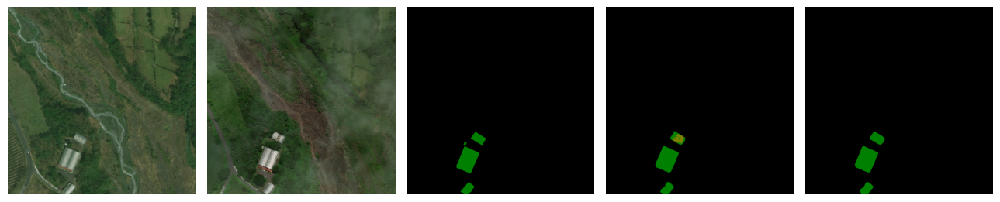

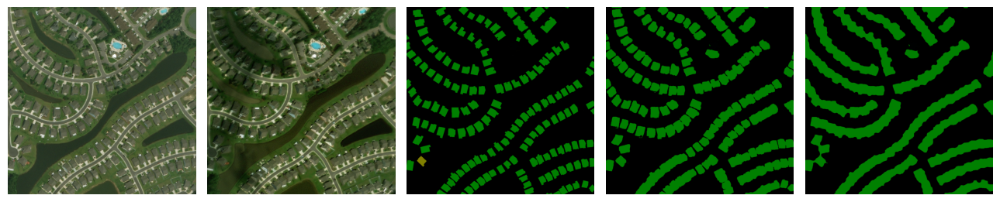

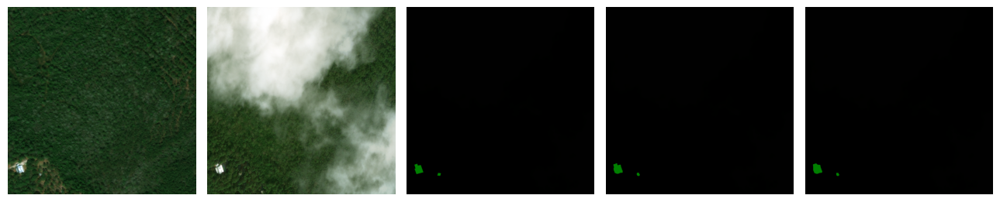

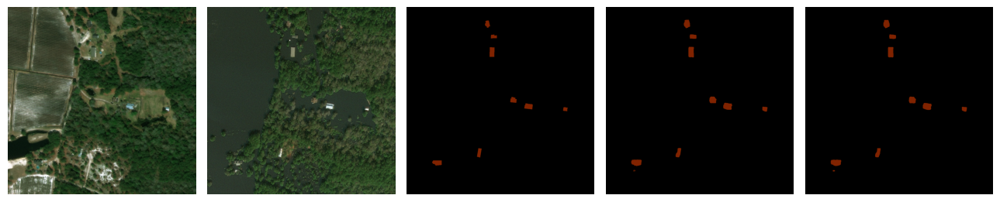

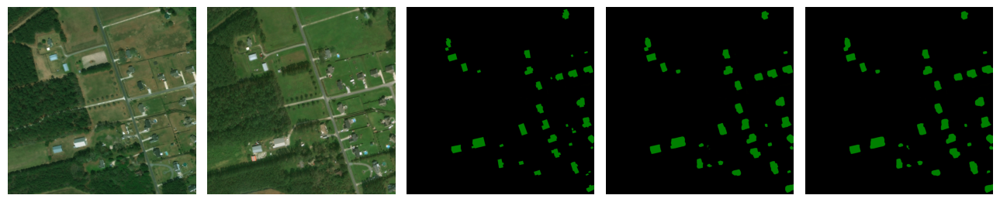

In [190]:
# Exemplo importando os dados do jeito que treinei o modelo

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(val_data_loader)

# Pega o primeiro lote
#batch_images = next(data_iter)

for idx, batch_images in enumerate(data_iter):

  # Break the loop after 5 iterations
  if idx >= 5:
    break

  first_batch_images = batch_images['img']
  first_batch_masks = batch_images['lbl_msk1']

  font_imagem = first_batch_images[2].to(device)
  font_mascara = first_batch_masks[2].to(device)  # No need to add batch dimension for masks

  visualize_predict_pytorch(model=model, input_image=font_imagem, mask_path=font_mascara, device=device, title_index=idx)

# primeira e Segundo desse

In [191]:
# Exemplo importando os dados do jeito que treinei o modelo

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(val_data_loader)

# Pega o primeiro lote
#batch_images = next(data_iter)

for idx, batch_images in enumerate(data_iter):

  # Break the loop after 5 iterations
  if idx >= 50:
    break

  if idx > 35 and idx < 50:
    first_batch_images = batch_images['img']
    first_batch_masks = batch_images['lbl_msk1']

    font_imagem = first_batch_images[4].to(device)
    font_mascara = first_batch_masks[4].to(device)  # No need to add batch dimension for masks

    visualize_predict_pytorch(model=model, input_image=font_imagem, mask_path=font_mascara, device=device,
                                  title_index=idx)

# Primeiro e ultimo desse

Output hidden; open in https://colab.research.google.com to view.

In [192]:
# Exemplo importando os dados do jeito que treinei o modelo

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available

# Cria o iterador
data_iter = iter(val_data_loader)

# Pega o primeiro lote
#batch_images = next(data_iter)

for idx, batch_images in enumerate(data_iter):

  # Break the loop after 5 iterations
  if idx >= 60:
    break

  if idx > 50 and idx < 60:
    first_batch_images = batch_images['img']
    first_batch_masks = batch_images['lbl_msk1']

    font_imagem = first_batch_images[4].to(device)
    font_mascara = first_batch_masks[4].to(device)  # No need to add batch dimension for masks

    visualize_predict_pytorch(model=model, input_image=font_imagem, mask_path=font_mascara, device=device,
                                  title_index=idx)

# Quarto e sexto desse

Output hidden; open in https://colab.research.google.com to view.

In [204]:
#Melhores resultados de cada classe

d = validate(model,val_data_loader)
d

100%|██████████| 91/91 [07:36<00:00,  5.01s/it]

Val Score: 0.8378190387400732, Dice: 1.0, F1: 0.768312912485819, F1_0: 0.9546504070326612, F1_1: 0.592028104627884, F1_2: 0.7623512071852357, F1_3: 0.8636511727441583


[0.8378190387400732,
 1.0,
 0.768312912485819,
 0.9546504070326612,
 0.592028104627884,
 0.7623512071852357,
 0.8636511727441583]

In [206]:
print(d[3] - 0.9552738481362872)
print(d[4] - 0.5755619719899544)
print(d[5] - 0.7614376578772566)
print(d[6] - 0.8673415396463575)

-0.000623441103625999
0.01646613263792962
0.0009135493079791557
-0.0036903669021992602


In [ ]:
#Sem morfologia

"""Val Score: 0.8332826514323544,
 F1: 0.7618323591890777,
F1_0: 0.9552738481362872,
F1_1: 0.5755619719899544,
F1_2: 0.7614376578772566,
F1_3: 0.8673415396463575
"""

'Val Score: 0.8332826514323544,\n F1: 0.7618323591890777,\nF1_0: 0.9552738481362872,\nF1_1: 0.5755619719899544,\nF1_2: 0.7614376578772566,\nF1_3: 0.8673415396463575\n'